# 1. Data Fetching

In [1]:
import json
import pandas as pd
import numpy as np

In [2]:
# read the json file
data = []
with open('data/tweets_DM.json', 'r') as f:
    for line in f:
        data.append(json.loads(line))

In [3]:
tweet_df = pd.DataFrame(data)
tweet_df.head(10)

,_score,_index,_source,_crawldate,_type
0,391,hashtag_tweets,"{'tweet': {'hashtags': ['Snapchat'], 'tweet_id...",2015-05-23 11:42:47,tweets
1,433,hashtag_tweets,"{'tweet': {'hashtags': ['freepress', 'TrumpLeg...",2016-01-28 04:52:09,tweets
2,232,hashtag_tweets,"{'tweet': {'hashtags': ['bibleverse'], 'tweet_...",2017-12-25 04:39:20,tweets
3,376,hashtag_tweets,"{'tweet': {'hashtags': [], 'tweet_id': '0x1cd5...",2016-01-24 23:53:05,tweets
4,989,hashtag_tweets,"{'tweet': {'hashtags': [], 'tweet_id': '0x2de2...",2016-01-08 17:18:59,tweets
5,120,hashtag_tweets,"{'tweet': {'hashtags': ['authentic', 'LaughOut...",2015-06-11 04:44:05,tweets
6,1021,hashtag_tweets,"{'tweet': {'hashtags': [], 'tweet_id': '0x2c91...",2015-08-18 02:30:07,tweets
7,481,hashtag_tweets,"{'tweet': {'hashtags': [], 'tweet_id': '0x368e...",2015-08-20 14:31:27,tweets
8,827,hashtag_tweets,"{'tweet': {'hashtags': ['LeagueCup'], 'tweet_i...",2016-04-18 13:01:02,tweets
9,66,hashtag_tweets,"{'tweet': {'hashtags': ['materialism', 'money'...",2015-09-09 09:22:55,tweets


In [4]:
# find unique _index in tweet_df
index = tweet_df['_index'].unique()
index

array(['hashtag_tweets'], dtype=object)

In [5]:
# find _source's lengths in tweet_df
source = tweet_df['_source'].apply(lambda x: len(x))
source.unique()

array([1], dtype=int64)

In [6]:
# get the tweet inside _source
tweet = tweet_df['_source'].apply(lambda x: x['tweet'])
tweet.head()

0    {'hashtags': ['Snapchat'], 'tweet_id': '0x376b...
1    {'hashtags': ['freepress', 'TrumpLegacy', 'CNN...
2    {'hashtags': ['bibleverse'], 'tweet_id': '0x28...
3    {'hashtags': [], 'tweet_id': '0x1cd5b0', 'text...
4    {'hashtags': [], 'tweet_id': '0x2de201', 'text...
Name: _source, dtype: object

In [7]:
# make hashtags, tweet_id, and text columns
hashtags = tweet.apply(lambda x: x['hashtags'])
tweet_id = tweet.apply(lambda x: x['tweet_id'])
text = tweet.apply(lambda x: x['text'])

# concat those with the tweet_df
tweet_df['hashtags'] = hashtags
tweet_df['tweet_id'] = tweet_id
tweet_df['text'] = text
tweet_df.head()


,_score,_index,_source,_crawldate,_type,hashtags,tweet_id,text
0,391,hashtag_tweets,"{'tweet': {'hashtags': ['Snapchat'], 'tweet_id...",2015-05-23 11:42:47,tweets,[Snapchat],0x376b20,"People who post ""add me on #Snapchat"" must be ..."
1,433,hashtag_tweets,"{'tweet': {'hashtags': ['freepress', 'TrumpLeg...",2016-01-28 04:52:09,tweets,"[freepress, TrumpLegacy, CNN]",0x2d5350,"@brianklaas As we see, Trump is dangerous to #..."
2,232,hashtag_tweets,"{'tweet': {'hashtags': ['bibleverse'], 'tweet_...",2017-12-25 04:39:20,tweets,[bibleverse],0x28b412,"Confident of your obedience, I write to you, k..."
3,376,hashtag_tweets,"{'tweet': {'hashtags': [], 'tweet_id': '0x1cd5...",2016-01-24 23:53:05,tweets,[],0x1cd5b0,Now ISSA is stalking Tasha 😂😂😂 <LH>
4,989,hashtag_tweets,"{'tweet': {'hashtags': [], 'tweet_id': '0x2de2...",2016-01-08 17:18:59,tweets,[],0x2de201,"""Trust is not the same as faith. A friend is s..."


In [8]:
# check if _source is always constructed as a dictionary with one element named tweet with a dictionary inside with three keys: hashtags, tweet_id, and text
tweet_df['_source'].apply(lambda x: isinstance(x, dict)).all()
tweet.apply(lambda x: isinstance(x, dict)).all()
# check the dict length = 3
tweet.apply(lambda x: len(x) == 3).all()

True

In [9]:
# check unique _types
tweet_df['_type'].unique()

array(['tweets'], dtype=object)

In [10]:
# drop the _index,	_source, _type columns
tweet_df = tweet_df.drop(['_index', '_source', '_type'], axis=1)
tweet_df.head()

,_score,_crawldate,hashtags,tweet_id,text
0,391,2015-05-23 11:42:47,[Snapchat],0x376b20,"People who post ""add me on #Snapchat"" must be ..."
1,433,2016-01-28 04:52:09,"[freepress, TrumpLegacy, CNN]",0x2d5350,"@brianklaas As we see, Trump is dangerous to #..."
2,232,2017-12-25 04:39:20,[bibleverse],0x28b412,"Confident of your obedience, I write to you, k..."
3,376,2016-01-24 23:53:05,[],0x1cd5b0,Now ISSA is stalking Tasha 😂😂😂 <LH>
4,989,2016-01-08 17:18:59,[],0x2de201,"""Trust is not the same as faith. A friend is s..."


In [11]:
# load data_identification
data_identification = pd.read_csv('data/data_identification.csv')
data_identification.head()

,tweet_id,identification
0,0x28cc61,test
1,0x29e452,train
2,0x2b3819,train
3,0x2db41f,test
4,0x2a2acc,train


In [12]:
# load emotion
emotion = pd.read_csv('data/emotion.csv')
emotion.head()

,tweet_id,emotion
0,0x3140b1,sadness
1,0x368b73,disgust
2,0x296183,anticipation
3,0x2bd6e1,joy
4,0x2ee1dd,anticipation


In [13]:
# concat data_identification and emotion and tweet_df by tweet_id and fill ones without emotion with null
df = pd.merge(pd.merge(data_identification, emotion, how='left', on='tweet_id'), tweet_df, how='left', on='tweet_id')
df.head()

,tweet_id,identification,emotion,_score,_crawldate,hashtags,text
0,0x28cc61,test,NaN,107,2017-01-17 14:13:32,[],@Habbo I've seen two separate colours of the e...
1,0x29e452,train,joy,809,2015-01-17 03:07:03,[],Huge Respect🖒 @JohnnyVegasReal talking about l...
2,0x2b3819,train,joy,808,2016-07-02 09:34:06,"[spateradio, app]",Yoooo we hit all our monthly goals with the ne...
3,0x2db41f,test,NaN,728,2015-10-17 06:46:20,[],@FoxNews @KellyannePolls No serious self respe...
4,0x2a2acc,train,trust,16,2016-08-15 18:18:39,[],@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...


In [14]:
# check null values on emotion
df['emotion'].isnull().sum()

411972

In [15]:
# check non null values on emotion
df['emotion'].notnull().sum()

1455563

In [16]:
# split df into train and test
train_df = df[df['identification'] == 'train']
test_df = df[df['identification'] == 'test']
train_df.head()

,tweet_id,identification,emotion,_score,_crawldate,hashtags,text
1,0x29e452,train,joy,809,2015-01-17 03:07:03,[],Huge Respect🖒 @JohnnyVegasReal talking about l...
2,0x2b3819,train,joy,808,2016-07-02 09:34:06,"[spateradio, app]",Yoooo we hit all our monthly goals with the ne...
4,0x2a2acc,train,trust,16,2016-08-15 18:18:39,[],@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...
5,0x2a8830,train,joy,768,2017-02-11 08:49:46,"[PUBG, GamersUnite, twitch, BeHealthy, StayPos...",Come join @ambushman27 on #PUBG while he striv...
6,0x20b21d,train,anticipation,70,2016-11-23 05:37:10,"[strength, bones, God]",@fanshixieen2014 Blessings!My #strength little...


In [18]:
# save the train and test df
train_df.to_csv('data/train.csv', index=False)
test_df.to_csv('data/test.csv', index=False)

In [19]:
# save combined df
df.to_csv('data/combined.csv', index=False)

# CheckPoint, don't need to execute above file

In [2]:
import json
import pandas as pd
import numpy as np
import plotly
plotly.offline.init_notebook_mode()

In [3]:
# load train and test df
train_df = pd.read_csv('data/train.csv')
test_df = pd.read_csv('data/test.csv')
test_df.head()

,tweet_id,identification,emotion,_score,_crawldate,hashtags,text
0,0x28cc61,test,NaN,107,2017-01-17 14:13:32,[],@Habbo I've seen two separate colours of the e...
1,0x2db41f,test,NaN,728,2015-10-17 06:46:20,[],@FoxNews @KellyannePolls No serious self respe...
2,0x2466f6,test,NaN,491,2016-12-19 03:50:27,['womendrivers'],"Looking for a new car, and it says 1 lady owne..."
3,0x23f9e9,test,NaN,28,2017-04-09 19:32:19,['robbingmembers'],@cineworld “only the brave” just out and fount...
4,0x1fb4e1,test,NaN,925,2016-01-15 11:59:31,[],Felt like total dog 💩 going into open gym and ...


# Pre Observasion

In [13]:
token_replacement = [
    ["：" , ":"],
    ["，" , ","],
    ["“" , "\""],
    ["”" , "\""],
    ["？" , "?"],
    ["……" , "..."],
    ["！" , "!"]
]

In [14]:
# replace all chinese letters to english ones
for replacement in token_replacement:
    train_df['text'] = train_df['text'].str.replace(replacement[0], replacement[1])
    test_df['text'] = test_df['text'].str.replace(replacement[0], replacement[1])

## From @mention

In [16]:
import re
def extract_mentions(tweet):
    """
    Extract all @mentions from a tweet.
    Returns a list of mentions or an empty list if none are found.
    """
    return list(set(re.findall(r'@(\w+)', tweet)))
train_df['mentioned'] = train_df['text'].apply(extract_mentions)
test_df['mentioned'] = test_df['text'].apply(extract_mentions)
#unpack and put everything in train_df mentioned in a list
mentioned = [item for sublist in train_df['mentioned'] for item in sublist]
mentioned_df = pd.DataFrame(mentioned, columns=['mentioned'])
print(len(mentioned))
len(set(mentioned))

810745


337879

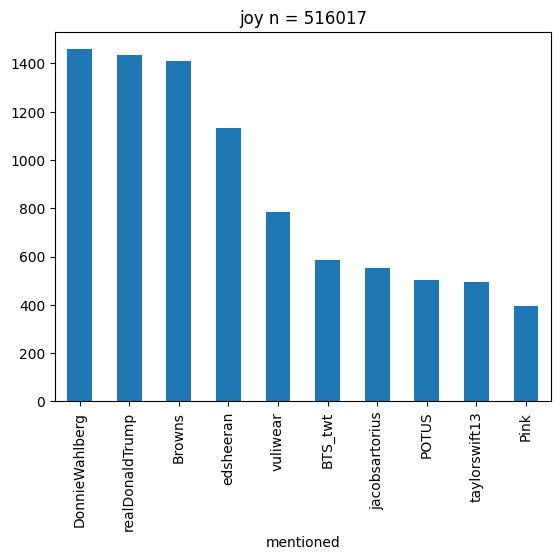

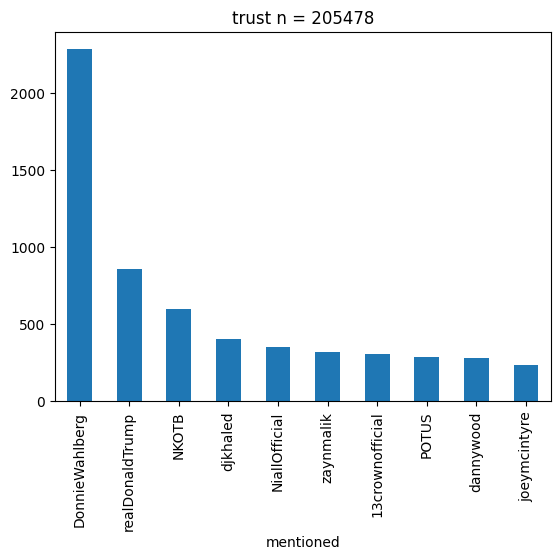

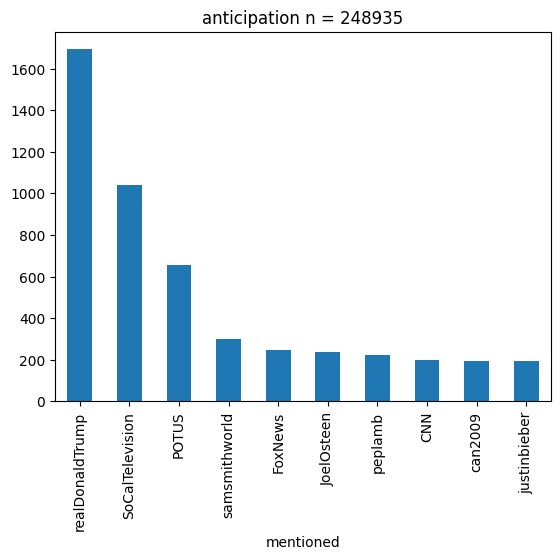

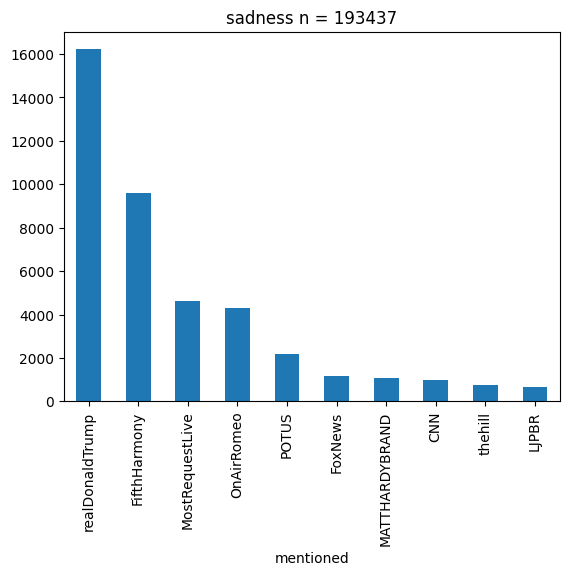

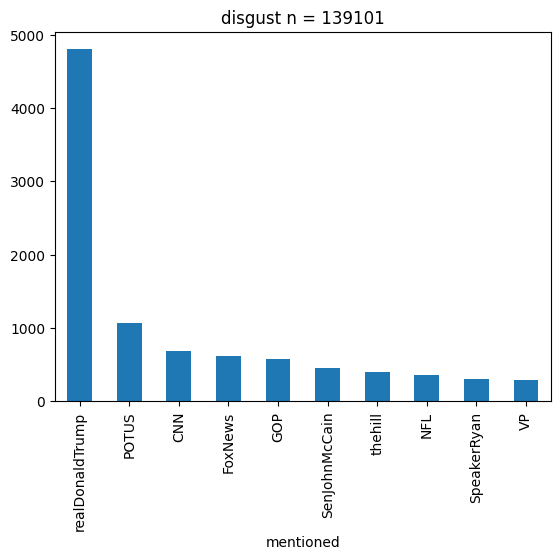

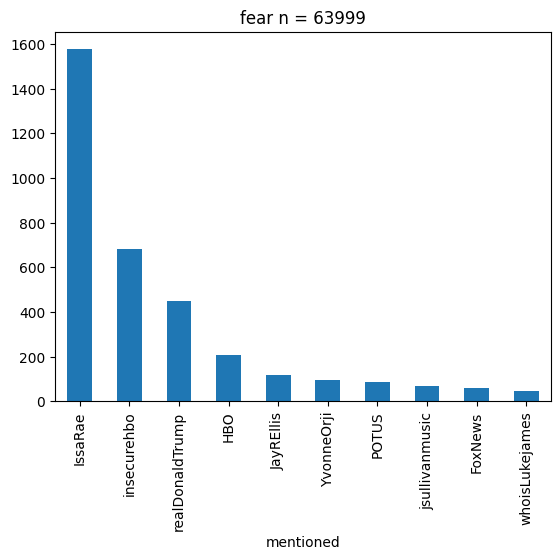

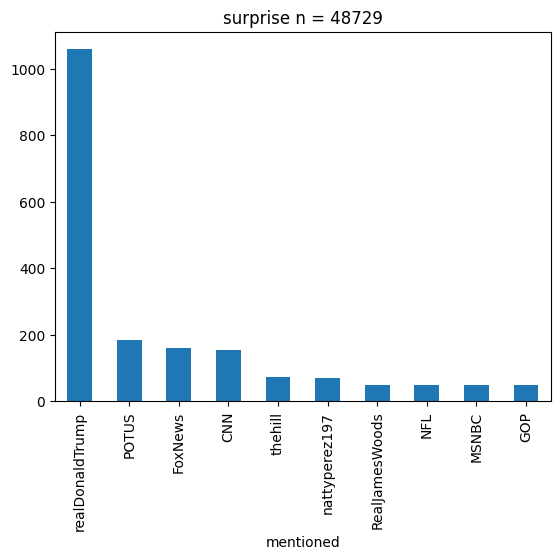

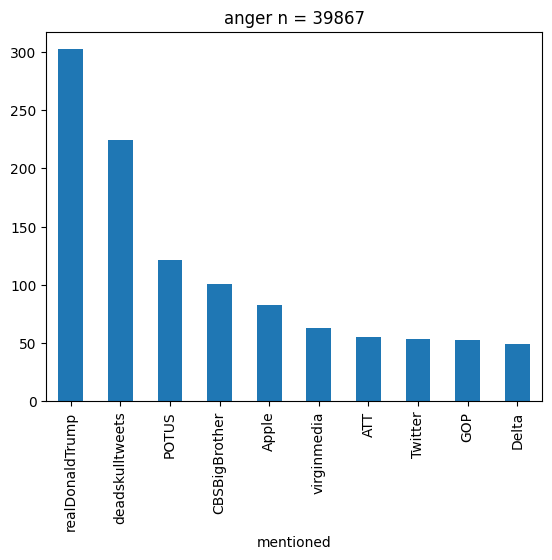

In [8]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

# plot the most mentioned person in each emotion
for emotion in train_df['emotion'].unique():
    emotion_df = train_df[train_df['emotion'] == emotion]
    mentioned_df2 = emotion_df['text'].apply(extract_mentions)
    mentioned_df2 = [item for sublist in mentioned_df2 for item in sublist]
    mentioned_df2 = pd.DataFrame(mentioned_df2, columns=['mentioned'])
    mentioned_df2['mentioned'].value_counts().head(10).plot(kind='bar')
    plt.title(emotion + ' n = ' + str(emotion_df.shape[0]))
    plt.show()

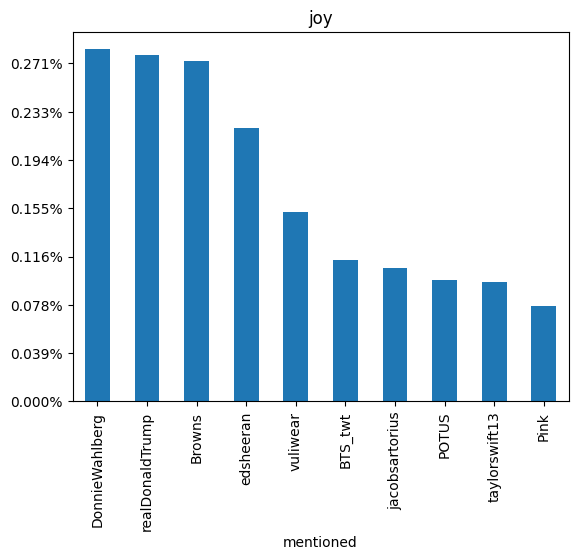

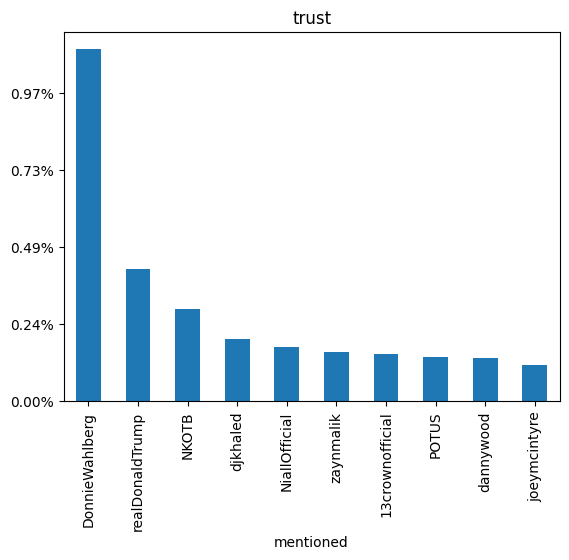

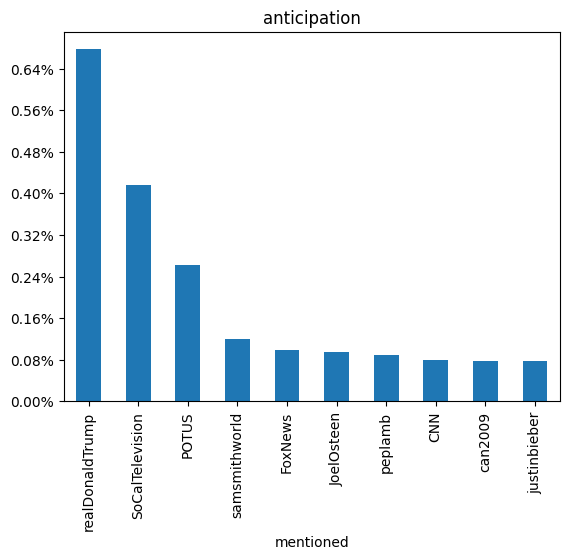

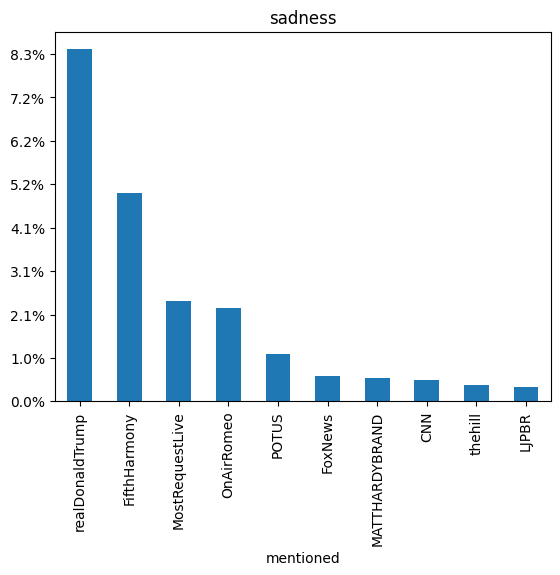

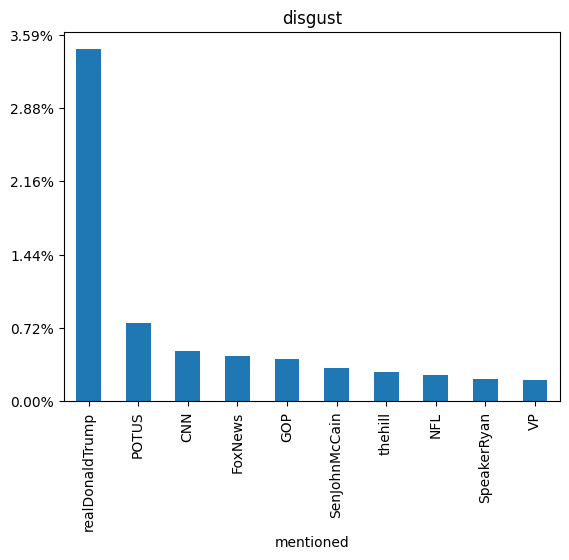

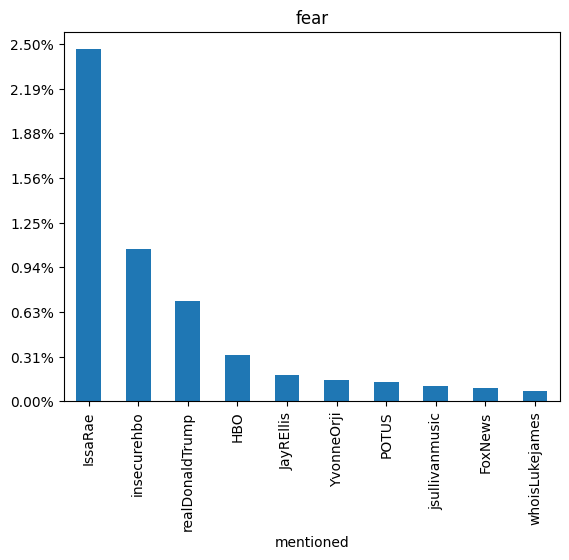

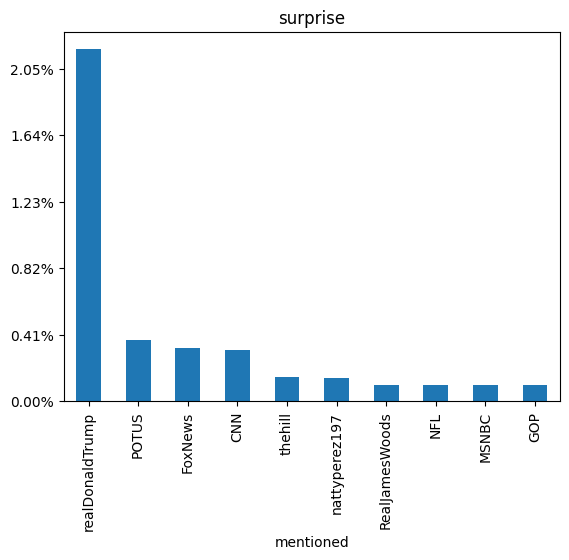

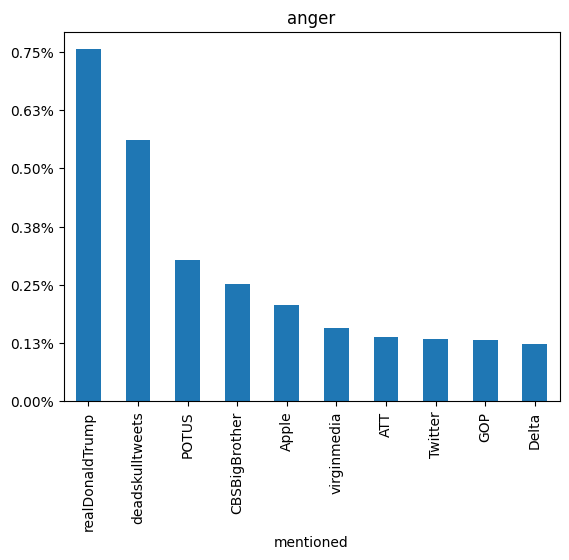

In [9]:
for emotion in train_df['emotion'].unique():
    emotion_df = train_df[train_df['emotion'] == emotion]
    mentioned_df2 = emotion_df['text'].apply(extract_mentions)
    mentioned_df2 = [item for sublist in mentioned_df2 for item in sublist]
    mentioned_df2 = pd.DataFrame(mentioned_df2, columns=['mentioned'])
    mentioned_df2['mentioned'].value_counts().head(10).plot(kind='bar')
    plt.title(emotion)
    # add y axis as percentage of total number of tweets
    plt.gca().yaxis.set_major_formatter(plt.matplotlib.ticker.PercentFormatter(xmax=emotion_df.shape[0]))
    plt.show()

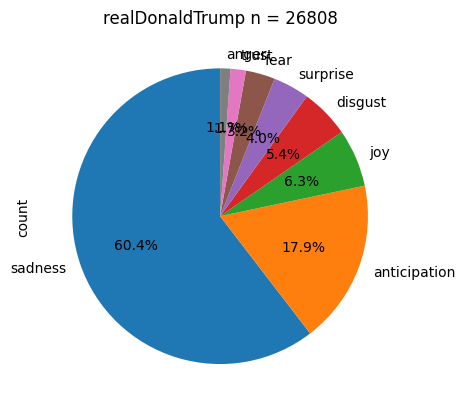

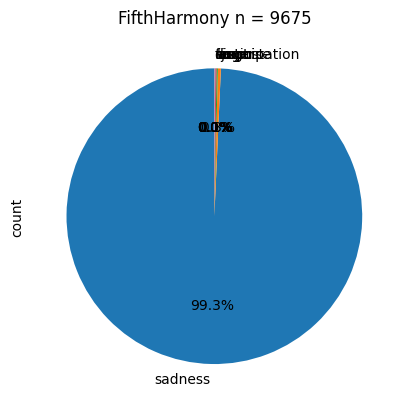

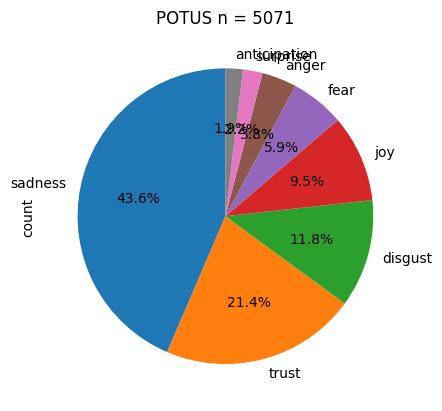

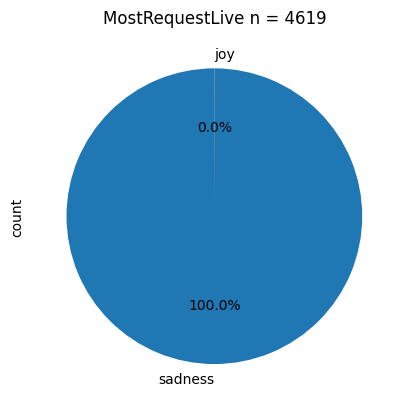

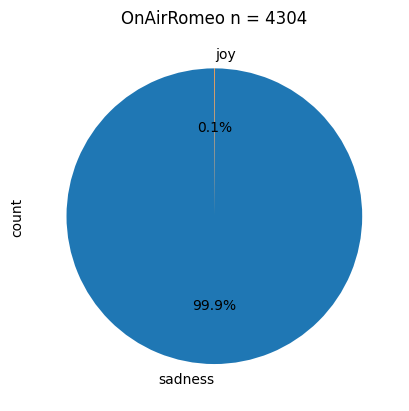

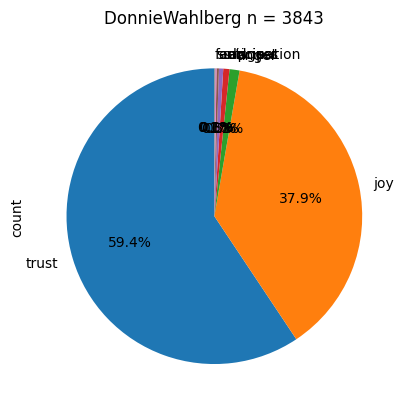

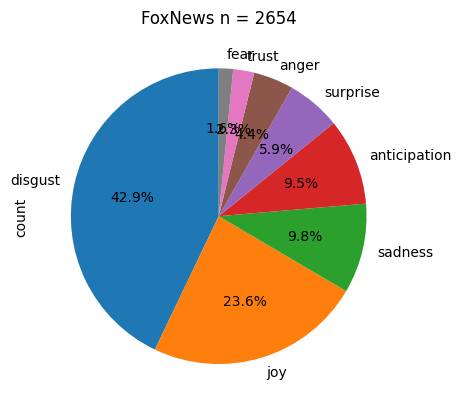

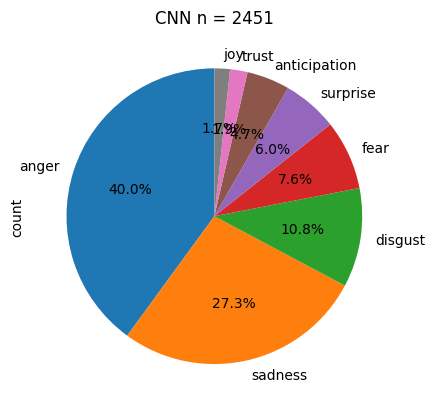

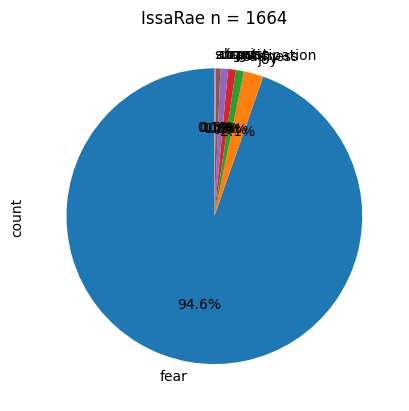

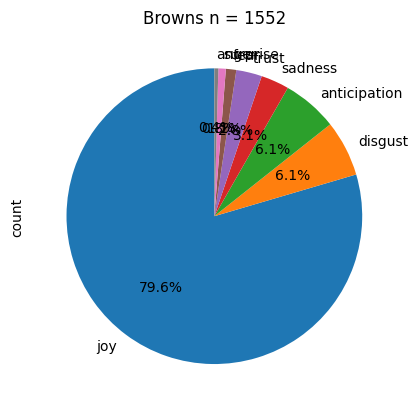

In [10]:
# for each person in top n most mentioned person, plot the number of tweets in each emotion as a pie chart with the same legend

for person in mentioned_df['mentioned'].value_counts().head(10).index:
    emotion_df = train_df[train_df['text'].str.contains(person)]
    # color the pie chart by emotion
    emotion_df['emotion'].value_counts().plot(kind='pie', autopct='%1.1f%%', labels=emotion_df['emotion'].unique(), startangle=90)
    plt.title(person + " n = " + str(mentioned_df['mentioned'].value_counts()[person]))
    plt.show()

In [17]:
# find the percentage of tweets that doesn't meniton anyone from the top 25 most mentioned people
# Check if any mention is in the top 25
top_25 = mentioned_df['mentioned'].value_counts().head(25).index.to_list()
train_df["has_top_25"] = train_df["mentioned"].apply(lambda mentions: any(person in top_25 for person in mentions))

# Count tweets without any top 25 mentions
no_top_25_count = len(train_df[~train_df["has_top_25"]])

print("Percentage of tweets without any of the top 25 mentions:", round(no_top_25_count / len(train_df), 4) * 100, "%")


Percentage of tweets without any of the top 25 mentions: 95.54 %


It seems that tagging and identifying the top 25 mentioned user might not be that useful. But anyways...

## The following code can only be executed once every 24 hrs

In [ ]:
# Authenticate with the Twitter API
def fetch_username(client, accountname):
    # return the name of account if not errored
    try:
        user = client.get_user(username=accountname)
        return user.data.name  
    except:
        return None

In [ ]:
# import the module 
import tweepy 
import time
from time import sleep

BEARER_TOKEN = "AAAAAAAAAAAAAAAAAAAAAJ0KxAEAAAAAmzXHCSejnJ5ww9r1IY43cx5JwPY%3DgvNE7KHYoOJqoUTQptwlvjXKzHUi0MqNqQCBvaOZ7P3N9GLKvo"
client = tweepy.Client(bearer_token=BEARER_TOKEN)
# create dict for account name user name conversion for top 50 most mentioned people
user_dict = {}
for person in mentioned_df['mentioned'].value_counts().head(25).index:
    user_dict[person] = fetch_username(client, person)
    sleep(1)
    print(person)
    print(user_dict[person])



realDonaldTrump
Donald J. Trump


Rate limit exceeded. Sleeping for 717 seconds.


: 

: 

In [1]:
import tweepy 

BEARER_TOKEN = "AAAAAAAAAAAAAAAAAAAAAJ0KxAEAAAAAmzXHCSejnJ5ww9r1IY43cx5JwPY%3DgvNE7KHYoOJqoUTQptwlvjXKzHUi0MqNqQCBvaOZ7P3N9GLKvo"
client = tweepy.Client(bearer_token=BEARER_TOKEN, wait_on_rate_limit=True)

In [2]:
client.get_user(username='realDonaldTrump')

Response(data=<User id=25073877 name=Donald J. Trump username=realDonaldTrump>, includes={}, errors=[], meta={})

## ~~~

## From word freaquency or something

In [10]:
from sklearn.feature_extraction.text import CountVectorizer
train_count_vect = CountVectorizer()
train_counts = train_count_vect.fit_transform(train_df.text)


In [11]:
test_count_vect = CountVectorizer()
test_counts = test_count_vect.fit_transform(test_df.text)

In [12]:
train_term_frequencies = np.asarray(train_counts.sum(axis=0))[0]
train_sorted_word = train_count_vect.get_feature_names_out()[np.argsort(train_term_frequencies)][::-1]
train_sorted_freq = np.sort(train_term_frequencies)[::-1]
import plotly.express as px
fig = px.bar(x=train_sorted_word[:30], y=train_sorted_freq[:30], title="Top 30 words")
fig.show()

In [13]:
test_term_frequencies = np.asarray(test_counts.sum(axis=0))[0]
test_sorted_word = test_count_vect.get_feature_names_out()[np.argsort(test_term_frequencies)][::-1]
test_sorted_freq = np.sort(test_term_frequencies)[::-1]
fig = px.bar(x=test_sorted_word[:30], y=test_sorted_freq[:30], title="Top 30 words")
fig.show()

In [14]:
# find the first 5 tweets that contains lh in the text and print them out
i = 0
for index, row in train_df.iterrows():
    
    if r'<LH>' in row['text']:
        print(row['text'])
        print(row['hashtags'])
        if i == 5:
            break
        i += 1

Yoooo we hit all our monthly goals with the new app in two weeks. #spateradio #app <LH>
['spateradio', 'app']
@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well done team 🌟 <LH> of every one of you.
[]
Come join @ambushman27 on #PUBG while he strives for chicken donners! #GamersUnite #twitch #BeHealthy #StayPositive #vegan <LH> <LH>
['PUBG', 'GamersUnite', 'twitch', 'BeHealthy', 'StayPositive', 'vegan']
Never give up. The manifestation of your goal comes through faith. #MondayMotivation <LH>
['MondayMotivation']
I Believe When No One Else Does... <LH> #DreamsComeTrue
['DreamsComeTrue']
I can't tell if I'm alive or in the after life after that document submission #help <LH>
['help']


After investigating these tweet (and asking chatGPT), it seems that the \<LH\> token stands for "Lost Hashtag", so they should probably be dropped out

In [15]:
# Remove <LH> from the text
train_df['text'] = train_df['text'].str.replace(r'<LH>', '')
test_df['text'] = test_df['text'].str.replace(r'<LH>', '')

In [16]:
train_count_vect = CountVectorizer()
train_counts = train_count_vect.fit_transform(train_df.text)

test_count_vect = CountVectorizer()
test_counts = test_count_vect.fit_transform(test_df.text)


In [17]:
train_term_frequencies = np.asarray(train_counts.sum(axis=0))[0]
train_sorted_word = train_count_vect.get_feature_names_out()[np.argsort(train_term_frequencies)][::-1]
train_sorted_freq = np.sort(train_term_frequencies)[::-1]
fig = px.bar(x=train_sorted_word[:30], y=train_sorted_freq[:30], title="Top 30 words in train")
fig.show()
test_term_frequencies = np.asarray(test_counts.sum(axis=0))[0]
test_sorted_word = test_count_vect.get_feature_names_out()[np.argsort(test_term_frequencies)][::-1]
test_sorted_freq = np.sort(test_term_frequencies)[::-1]
fig = px.bar(x=test_sorted_word[:30], y=test_sorted_freq[:30], title="Top 30 words in test")
fig.show()

In [18]:
# create term freaquencies for each emotion category
train_emotion_tf_list = []
for emotion in train_df['emotion'].unique():
    count_vect = CountVectorizer()
    counts = count_vect.fit_transform(train_df[train_df['emotion'] == emotion]['text'])
    term_frequencies = np.asarray(counts.sum(axis=0))[0]
    sorted_word = count_vect.get_feature_names_out()[np.argsort(term_frequencies)][::-1]
    sorted_freq = np.sort(term_frequencies)[::-1]
    train_emotion_tf_list.append({"emotion": emotion, "sorted_word": sorted_word, "sorted_freq": sorted_freq})

In [19]:
for i in train_emotion_tf_list:
    # set the threshold to 0.1%
    threshold = int(len(i['sorted_word']) * 0.001)
    fig = px.bar(x=i['sorted_word'][threshold:threshold+30], y=i['sorted_freq'][threshold:threshold+30], title=f"Top 30 words in {i['emotion']} outside the 0.1% threshold")
    fig.show()

In [20]:
a = dict()

## Clean the Emojis out

In [41]:
# find unique emojis used in train_df.text
import emoji
unique_emojis = dict()
for index, row in train_df.iterrows():
    text = row['text']
    if (emoji.emoji_count(text) > 0):
        for emoji_data in emoji.analyze(text):
            if (emoji_data[0] not in unique_emojis):
                unique_emojis[emoji_data[0]] = 1
            else:
                unique_emojis[emoji_data[0]] += 1
print(unique_emojis.keys())

dict_keys(['🌟', '🙏', '👩\u200d❤️\u200d👩', '👭', '❤', '😂', '💜', '💎', '✨', '😍', '👏', '❤️', '👍', '😈', '😬', '📺', '💝', '🙏🏽', '🛎', '🙌🏾', '🖤', '☕', '🤔', '😐', '🔥', '🙌', '🌈', '🏳️\u200d🌈', '😃', '💙', '👌🏼', '👶🏼', '🍼', '🎉', '👍🏼', '🍁', '🦃', '💪', '😷', '🙀', '😀', '😉', '🎥', '😨', '😱', '😆', '🤗', '😅', '😄', '💕', '😢', '😭', '🙏🏻', '😊', '😙', '🍒', '🍍', '🍳', '🙌🏼', '😘', '😩', '💞', '🙏🏼', '🙂', '👑', '😰', '💔', '👌', '🙈', '🍉', '🙌🏻', '🤠', '👏🏻', '🆕', '😎', '💆🏽', '🇺🇸', '🌺', '🕘', '🇪🇺', '🇨🇦', '🇬🇧', '🇨🇳', '🇷🇺', '☺️', '💖', '💯', '🔭', '💘', '😑', '💗', '😴', '👌🏻', '🤙🏿', '⚾', '🤾🏽\u200d♂️', '💪🏽', '😝', '👍🏻', '🌎', '😻', '👫', '🤦🏽\u200d♀️', '👀', '📷', '🎶', '🎧', '💁🏻', '👻', '😫', '🙄', '🤢', '😞', '😚', '🙃', '⚽', '🐌', '☹️', '🐍', '😶', '👉', '🌸', '🌙', '😒', '👨\u200d🍳', '🎄', '☃️', '🍗', '😏', '✊🏼', '🔂', '😇', '🙌🏽', '😳', '👉🏻', '🏆', '😕', '😮', '💀', '🎓', '💛', '😁', '♥️', '💥', '💪🏾', '💰', '☝', '👩🏽\u200d🎓', '👨🏾\u200d🎓', '💫', '😌', '🎂', '🏈', '🤷🏽\u200d♀️', '🙉', '🙊', '⬇️', '🤞🏽', '👄', '👊', '✌', '✊', '💨', '🌴', '🌿', '™', '✔️', '⭐', '🤦🏾\u200d♀️', '👈🏻', '❗', '☝️', '🌻', '🍀', '

In [45]:
unique_emojis.values()

dict_values([1490, 14383, 46, 319, 16460, 39697, 6143, 637, 6182, 32100, 6189, 34575, 6564, 1882, 2768, 310, 1126, 5903, 20, 3412, 1580, 1121, 7484, 1464, 11036, 6453, 3000, 1241, 3088, 7729, 905, 137, 129, 4919, 806, 1159, 1754, 3242, 1217, 258, 4786, 4299, 402, 1273, 4229, 2261, 5520, 2687, 2595, 10706, 4876, 18392, 4166, 14288, 860, 243, 248, 212, 3057, 12474, 7938, 4041, 4990, 1953, 2133, 1326, 2729, 4480, 3086, 149, 2517, 169, 1516, 45, 5855, 60, 6872, 663, 1603, 1632, 2054, 2232, 1620, 1667, 4103, 5700, 7943, 22, 1288, 1714, 3568, 1456, 990, 221, 694, 5, 695, 1360, 1257, 1382, 1193, 409, 681, 2665, 153, 4311, 756, 250, 1306, 2097, 6423, 1674, 1762, 908, 2975, 1271, 21, 974, 414, 667, 822, 1066, 266, 3179, 13, 1797, 230, 314, 2214, 145, 13, 6045, 3335, 3416, 25, 1007, 1566, 816, 1348, 234, 3465, 6638, 2649, 1022, 649, 1599, 507, 17, 8, 1166, 2971, 2083, 1129, 529, 219, 849, 230, 237, 237, 1313, 1868, 543, 562, 871, 345, 375, 669, 954, 538, 25, 568, 418, 1099, 1070, 1918, 535, 284,

In [47]:
unique_emoji_df = pd.DataFrame(list(unique_emojis.keys()), columns=['emoji'])
unique_emoji_df['count'] = list(unique_emojis.values())
unique_emoji_df['name'] = unique_emoji_df['emoji'].apply(lambda x: emoji.demojize(x, delimiters = ("", "")))

In [48]:
unique_emoji_df.head()

,emoji,count,name
0,🌟,1490,glowing_star
1,🙏,14383,folded_hands
2,👩‍❤️‍👩,46,couple_with_heart_woman_woman
3,👭,319,women_holding_hands
4,❤,16460,red_heart


In [112]:
import emoji
import re
def get_emoji_regexp():
    # Sort emoji by length to make sure multi-character emojis are
    # matched first
    emojis = sorted(emoji.EMOJI_DATA, key=len, reverse=True)
    pattern = '(' + '|'.join(re.escape(u) for u in emojis) + ')'
    return re.compile(pattern)


def remove_emojis(text):
    # Remove all emojis using regex with emoji.UNICODE_EMOJI_ALIAS
    return re.sub(get_emoji_regexp(), "", text)

# Example
text = "I love Python! 😍🐍 #coding"
clean_text = emoji.replace_emoji(text, "")

print(f"Original: {text}")
print(f"Cleaned: {clean_text}")


Original: I love Python! 😍🐍 #coding
Cleaned: I love Python!  #coding


In [59]:
# sort the eomojis by the number of times they are used in unique_emoji
unique_emoji_df = unique_emoji_df.sort_values(by='count', ascending=False)
# replace _ with space
unique_emoji_df['name'] = unique_emoji_df['name'].str.replace("_", " ")
unique_emoji_df.head(50)

,emoji,count,name
5,😂,39697,face with tears of joy
11,❤️,34575,red heart
9,😍,32100,smiling face with heart-eyes
51,😭,18392,loudly crying face
4,❤,16460,red heart
1,🙏,14383,folded hands
53,😊,14288,smiling face with smiling eyes
59,😘,12474,face blowing a kiss
24,🔥,11036,fire
49,💕,10706,two hearts


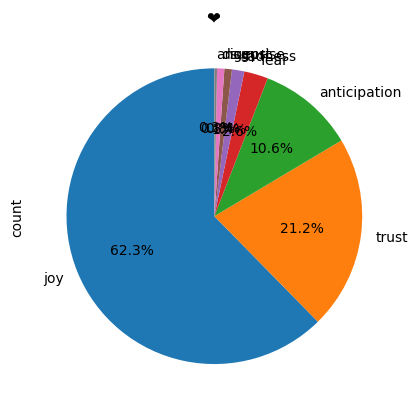

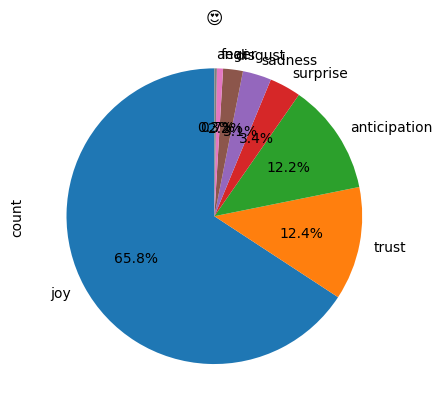

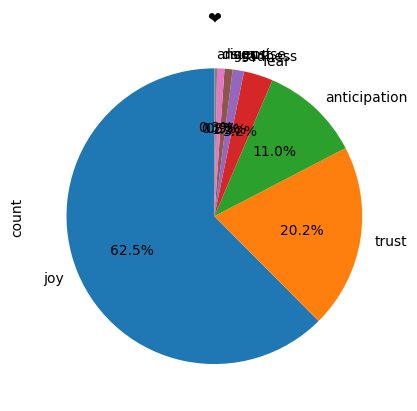

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128591 (\N{PERSON WITH FOLDED HANDS}) missing from font(s) DejaVu Sans.



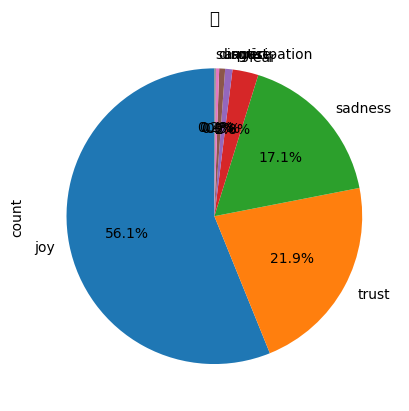

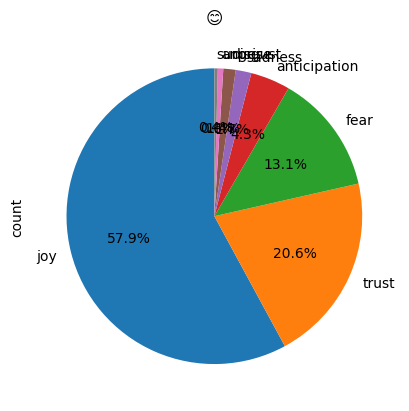

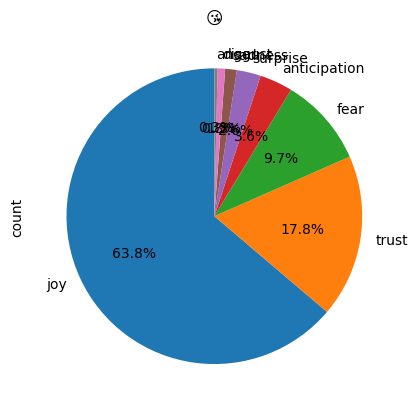

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128149 (\N{TWO HEARTS}) missing from font(s) DejaVu Sans.



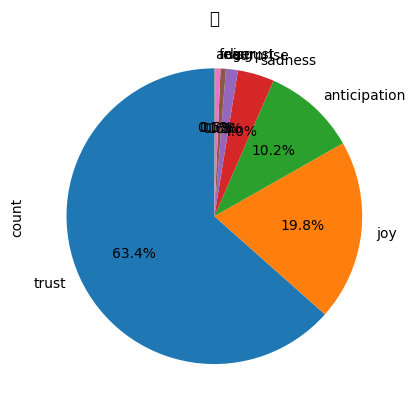

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128175 (\N{HUNDRED POINTS SYMBOL}) missing from font(s) DejaVu Sans.



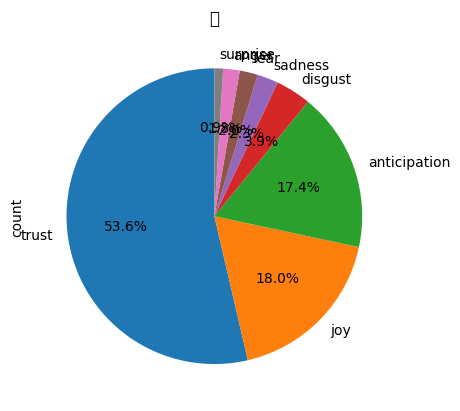

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128077 (\N{THUMBS UP SIGN}) missing from font(s) DejaVu Sans.



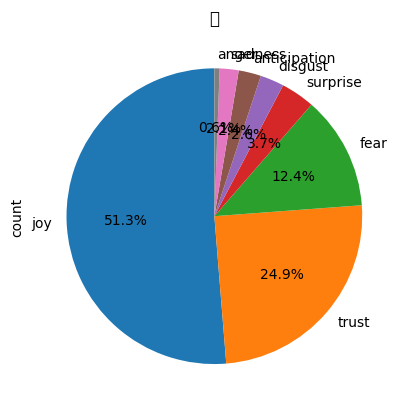

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128588 (\N{PERSON RAISING BOTH HANDS IN CELEBRATION}) missing from font(s) DejaVu Sans.



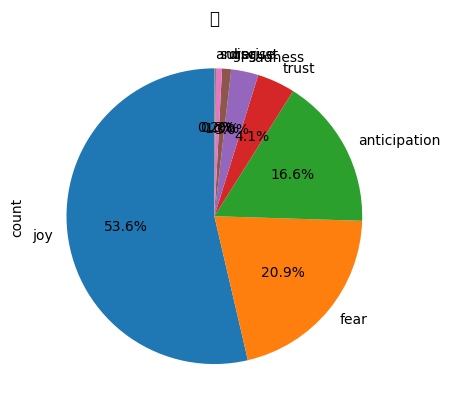

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 10024 (\N{SPARKLES}) missing from font(s) DejaVu Sans.



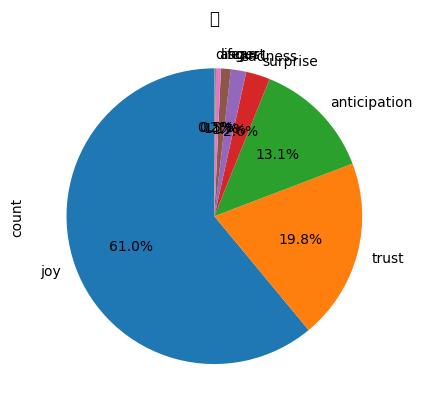

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128591 (\N{PERSON WITH FOLDED HANDS}) missing from font(s) DejaVu Sans.

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 127998 (\N{EMOJI MODIFIER FITZPATRICK TYPE-5}) missing from font(s) DejaVu Sans.



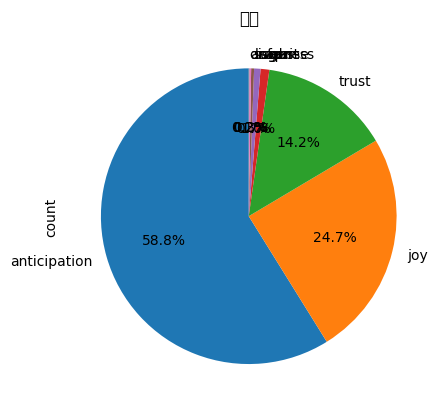

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128156 (\N{PURPLE HEART}) missing from font(s) DejaVu Sans.



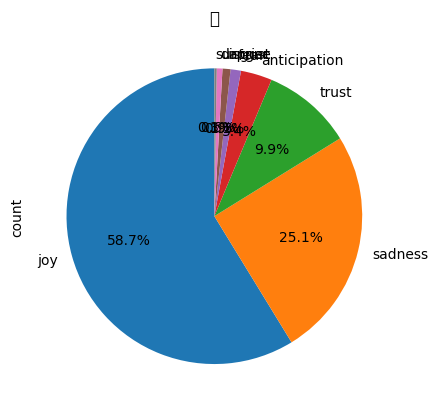

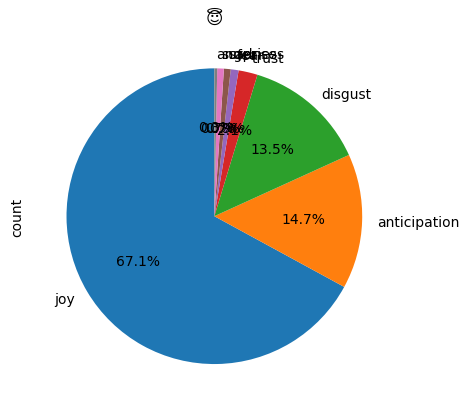

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128591 (\N{PERSON WITH FOLDED HANDS}) missing from font(s) DejaVu Sans.

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 127997 (\N{EMOJI MODIFIER FITZPATRICK TYPE-4}) missing from font(s) DejaVu Sans.



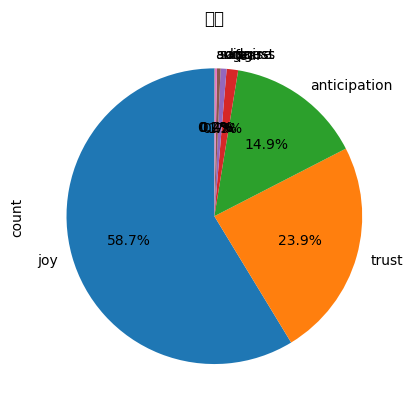

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128150 (\N{SPARKLING HEART}) missing from font(s) DejaVu Sans.



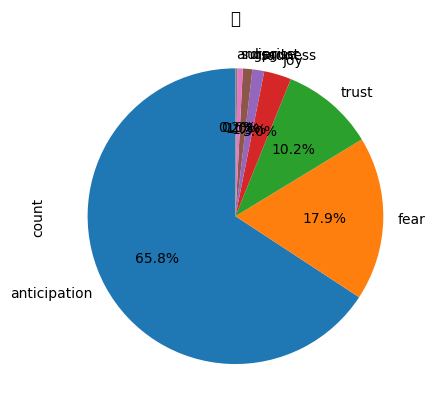

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 129303 (\N{HUGGING FACE}) missing from font(s) DejaVu Sans.



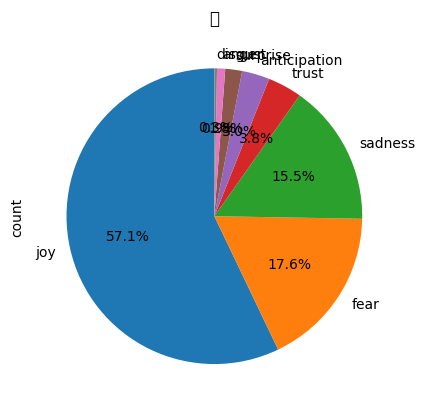

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128591 (\N{PERSON WITH FOLDED HANDS}) missing from font(s) DejaVu Sans.

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 127996 (\N{EMOJI MODIFIER FITZPATRICK TYPE-3}) missing from font(s) DejaVu Sans.



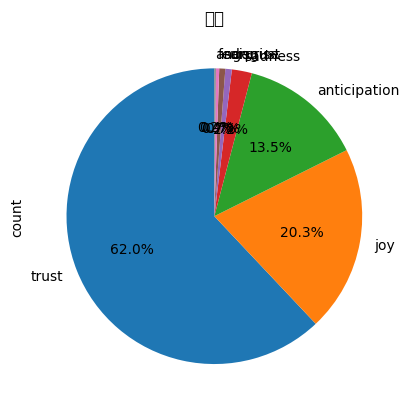

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 127881 (\N{PARTY POPPER}) missing from font(s) DejaVu Sans.



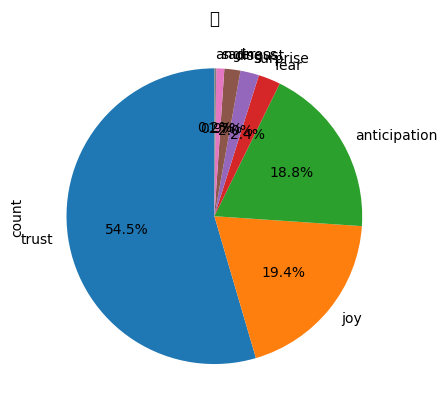

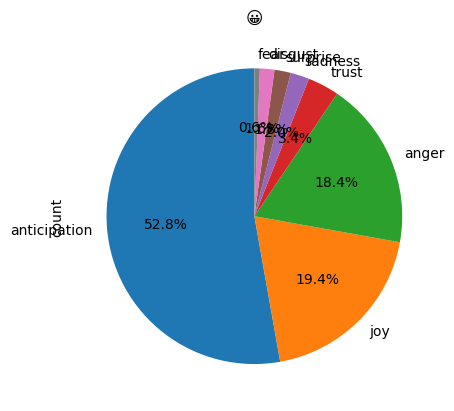

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128076 (\N{OK HAND SIGN}) missing from font(s) DejaVu Sans.



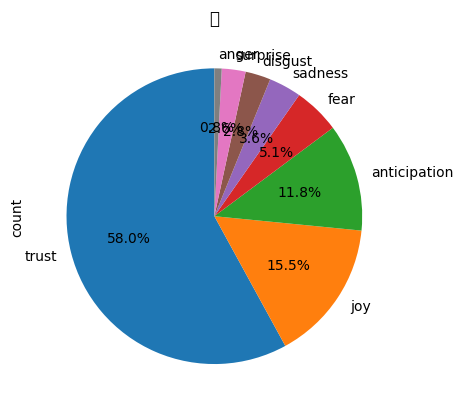

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 127926 (\N{MULTIPLE MUSICAL NOTES}) missing from font(s) DejaVu Sans.



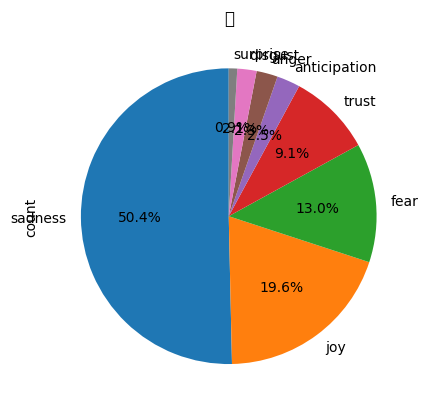

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128591 (\N{PERSON WITH FOLDED HANDS}) missing from font(s) DejaVu Sans.

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 127995 (\N{EMOJI MODIFIER FITZPATRICK TYPE-1-2}) missing from font(s) DejaVu Sans.



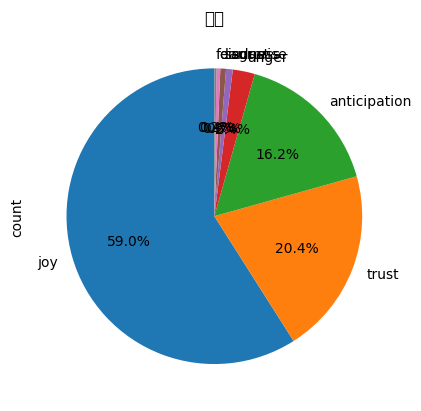

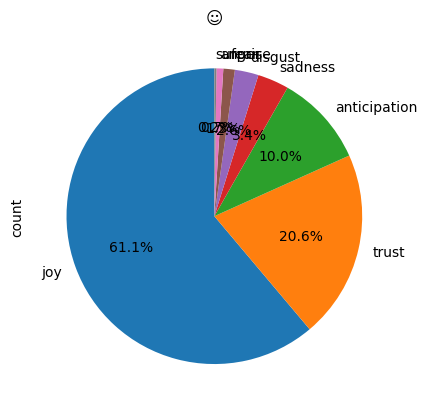

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128158 (\N{REVOLVING HEARTS}) missing from font(s) DejaVu Sans.



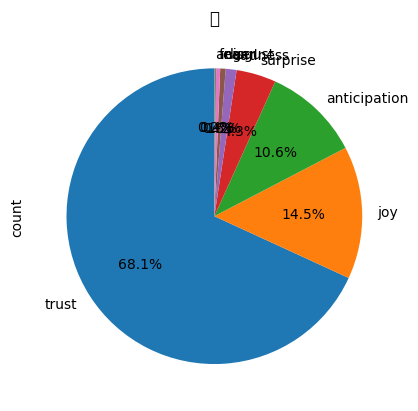

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128151 (\N{GROWING HEART}) missing from font(s) DejaVu Sans.



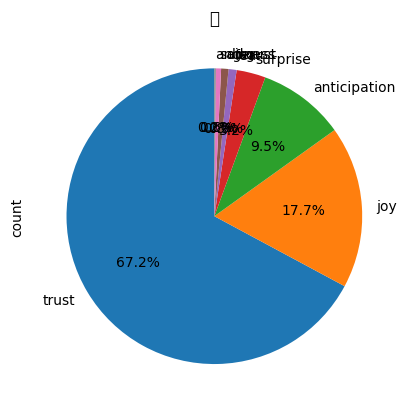

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128154 (\N{GREEN HEART}) missing from font(s) DejaVu Sans.



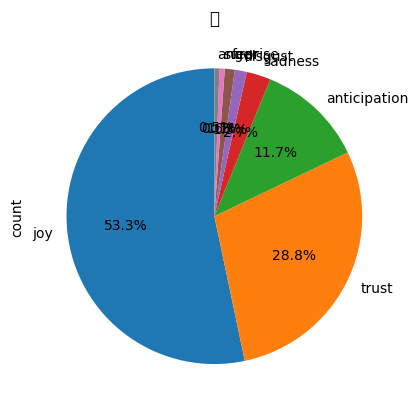

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128155 (\N{YELLOW HEART}) missing from font(s) DejaVu Sans.



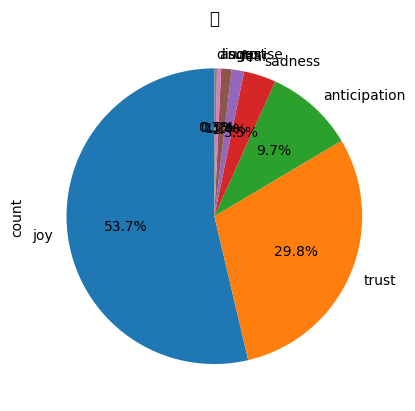

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 128588 (\N{PERSON RAISING BOTH HANDS IN CELEBRATION}) missing from font(s) DejaVu Sans.

c:\Users\Owner\.conda\envs\DataMining\lib\site-packages\IPython\core\pylabtools.py:152: UserWarning:

Glyph 127997 (\N{EMOJI MODIFIER FITZPATRICK TYPE-4}) missing from font(s) DejaVu Sans.



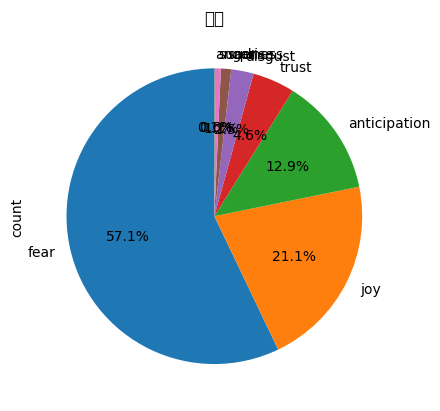

In [61]:
# for the top 10 used emoji, find the percentage of emotions they are associated with and plot to a pie chart
dominating_emoji = []
for e in unique_emoji_df['emoji'].head(50):
    emotion_df = train_df[train_df['text'].str.contains(e)]
    # only print those with dominate emotion (one emotion dominates over 50% of the tweets uses this one)
    if (emotion_df['emotion'].value_counts().max() / emotion_df.shape[0]) > 0.5:
        emotion_df['emotion'].value_counts().plot(kind='pie', autopct='%1.1f%%', labels=emotion_df['emotion'].unique(), startangle=90)
        plt.title(e)
        plt.show()
        dominating_emoji.append(e)

In [62]:
dominating_emoji_dict = {}
for e in dominating_emoji:
    dominating_emoji_dict[e] = unique_emoji_df[unique_emoji_df['emoji'] == e]['name'].values[0]

In [63]:
dominating_emoji_dict

{'❤️': 'red heart',
 '😍': 'smiling face with heart-eyes',
 '❤': 'red heart',
 '🙏': 'folded hands',
 '😊': 'smiling face with smiling eyes',
 '😘': 'face blowing a kiss',
 '💕': 'two hearts',
 '💯': 'hundred points',
 '👍': 'thumbs up',
 '🙌': 'raising hands',
 '✨': 'sparkles',
 '🙏🏾': 'folded hands medium-dark skin tone',
 '💜': 'purple heart',
 '😇': 'smiling face with halo',
 '🙏🏽': 'folded hands medium skin tone',
 '💖': 'sparkling heart',
 '🤗': 'smiling face with open hands',
 '🙏🏼': 'folded hands medium-light skin tone',
 '🎉': 'party popper',
 '😀': 'grinning face',
 '👌': 'OK hand',
 '🎶': 'musical notes',
 '🙏🏻': 'folded hands light skin tone',
 '☺️': 'smiling face',
 '💞': 'revolving hearts',
 '💗': 'growing heart',
 '💚': 'green heart',
 '💛': 'yellow heart',
 '🙌🏽': 'raising hands medium skin tone'}

In [ ]:
# for dominating emojis, replace them with their name
train_df['demojized_text'] = train_df['text']
test_df['demojized_text'] = test_df['text']
for key, value in dominating_emoji_dict.items():
    train_df['demojized_text'] = train_df['demojized_text'].str.replace(key, value)
    test_df['demojized_text'] = test_df['demojized_text'].str.replace(key, value)


In [115]:
train_df['demojized_text'] = train_df['demojized_text'].apply(lambda x: emoji.replace_emoji(x, ""))
test_df['demojized_text'] = test_df['demojized_text'].apply(lambda x: emoji.replace_emoji(x, ""))

In [116]:
test_df['demojized_text'].head()

0    @Habbo I've seen two separate colours of the e...
1    @FoxNews @KellyannePolls No serious self respe...
2    Looking for a new car, and it says 1 lady owne...
3    @cineworld "only the brave" just out and fount...
4    Felt like total dog  going into open gym and h...
Name: demojized_text, dtype: object

# Supposely train with NB or TFIDF or something

In [166]:
# Function to create term-document frequency DataFrame for each category
def create_term_document_df(origin_df):
    word_dict = {}
    # for emotion in origin_df['emotion'].unique():
    #     df = origin_df[origin_df['emotion'] == emotion]
    #     count_vect = CountVectorizer()  # Initialize the CountVectorizer
    #     counts = count_vect.fit_transform(df['demojized_text'])  # Transform the text data into word counts
        
        
    #     unique_words = count_vect.get_feature_names_out()
    #     term_frequencies = np.asarray(counts.sum(axis=0))[0]
    #     sorted_word = count_vect.get_feature_names_out()[np.argsort(term_frequencies)][::-1]
    #     # sort counts' columns by the term frequencies in descending order
    #     # Get the unique words (vocabulary) from the vectorizer if the word is used for at least 0.05% of the documents
    #     # find the index of term_freaquency that is greater than 0.0001
    #     words = [word for word, count in zip(unique_words, term_frequencies) if count > 0.0005 * len(df)]
    #     for word in words:
    #         if word not in word_dict:
    #             word_dict[word] = 1
    #         else:
    #             word_dict[word] += 1
    doups = [word for word, count in word_dict.items() if count > 1]
    print(len(doups))
    term_document_dfs = {} 
    for emotion in origin_df['emotion'].unique():
        df = origin_df[origin_df['emotion'] == emotion]
        count_vect = CountVectorizer()  # Initialize the CountVectorizer
        counts = count_vect.fit_transform(df['demojized_text'])  # Transform the text data into word counts
        
        
        unique_words = count_vect.get_feature_names_out()
        term_frequencies = np.asarray(counts.sum(axis=0))[0]
        sorted_word = count_vect.get_feature_names_out()[np.argsort(term_frequencies)][::-1]
        # sort counts' columns by the term frequencies in descending order
        # Get the unique words (vocabulary) from the vectorizer if the word is used for at least 0.1% of the documents
        # find the index of term_freaquency that is greater than 0.0001
        words = [word for word, count in zip(unique_words, term_frequencies) if ((count > 0.001 * len(df)) and (word not in doups))]
        selected_counts = counts[:, np.isin(unique_words, words)]
        print(len(words), len(sorted_word))
        print(selected_counts.shape)
        # Create a DataFrame where rows are documents and columns are words
        term_document_dfs[emotion] = pd.DataFrame(selected_counts.toarray(), columns=words)
    
    return term_document_dfs

# Create term-document frequency DataFrames for each category
term_document_dfs = create_term_document_df(train_df)

0
1168 363359
(516017, 1168)
1245 195668
(205478, 1245)
1259 183111
(248935, 1259)
1301 166790
(193437, 1301)
1402 144686
(139101, 1402)
1039 64817
(63999, 1039)
1259 65140
(48729, 1259)
1418 50271
(39867, 1418)


In [168]:
term_document_dfs['joy'].sum(axis=0)

00am         1245
00pm          945
01           1052
02            938
03            900
            ...  
young         975
your        39666
yours         698
yourself     4529
youtube      1360
Length: 1168, dtype: int64

In [169]:
from PAMI.extras.DF2DB import DenseFormatDF as db

# Loop through the dictionary of term-document DataFrames
for category in term_document_dfs:
    # Replace dots with underscores in the category name to avoid errors in the file creation
    category_safe = category.replace('.', '_')
    
    # Create the DenseFormatDF object and convert to a transactional database
    obj = db.DenseFormatDF(term_document_dfs[category])
    obj.convert2TransactionalDatabase(f'data/td_freq_db_{category_safe}.csv', '>=', 1)

In [171]:
train_df.to_csv('data/train_v2.csv', index=False)
test_df.to_csv('data/test_v2.csv', index=False)

In [12]:
train_df = pd.read_csv('data/train_v2.csv')
test_df = pd.read_csv('data/test_v2.csv')

## PAMI observation

### joy

Database size (total no of transactions) : 511707
Number of items : 1168
Minimum Transaction Size : 1
Average Transaction Size : 8.69225943752968
Maximum Transaction Size : 31
Standard Deviation Transaction Size : 4.632391828127438
Variance in Transaction Sizes : 21.459095985597415
Sparsity : 0.9925579970569095


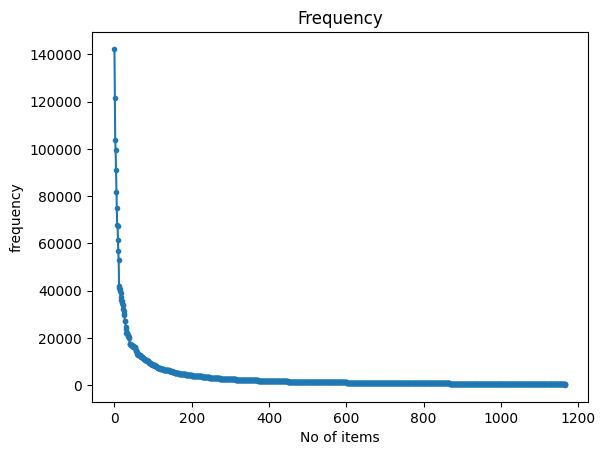

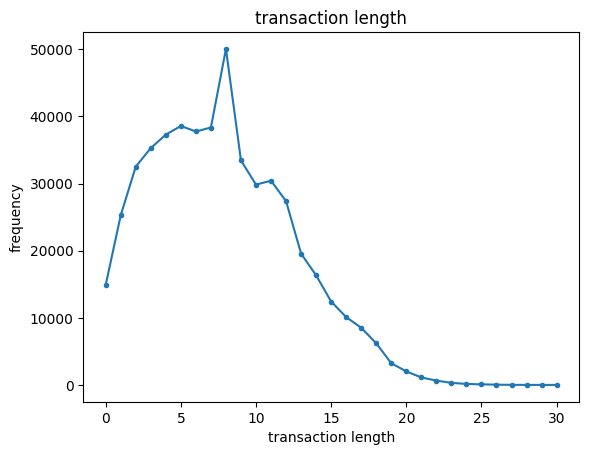

In [11]:
from PAMI.extras.dbStats import TransactionalDatabase as tds
obj = tds.TransactionalDatabase('data/td_freq_db_joy.csv')
obj.run()
obj.printStats()
obj.plotGraphs()

15000 for joy

### anger

Database size (total no of transactions) : 39622
Number of items : 1418
Minimum Transaction Size : 1
Average Transaction Size : 9.978824895260209
Maximum Transaction Size : 27
Standard Deviation Transaction Size : 4.886747352195908
Variance in Transaction Sizes : 23.880902402441215
Sparsity : 0.9929627469003807


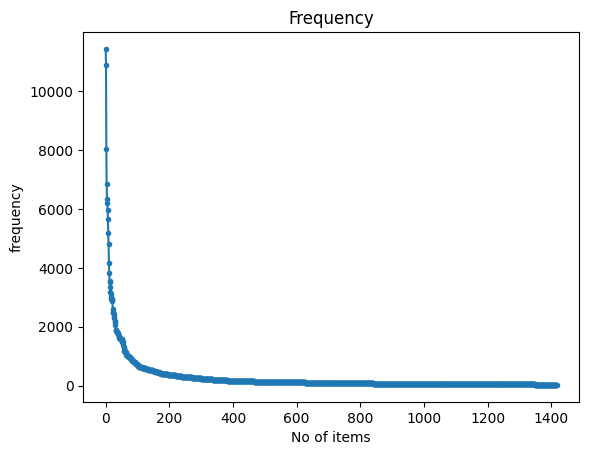

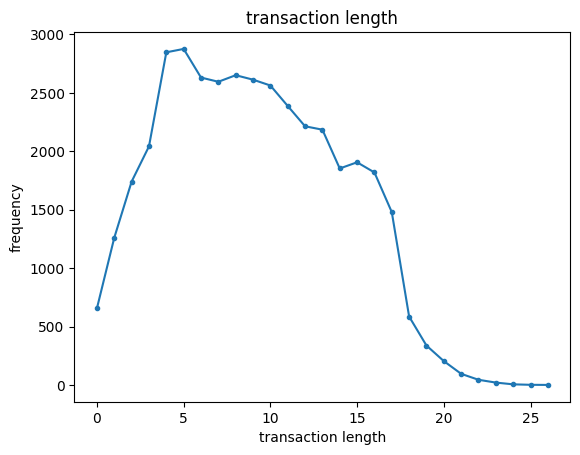

In [12]:
obj = tds.TransactionalDatabase('data/td_freq_db_anger.csv')
obj.run()
obj.printStats()
obj.plotGraphs()

1700 for anger

In [15]:
obj_list = []
for emotion in train_df['emotion'].unique():
    print(emotion)
    if (emotion == 'joy' or emotion == 'anger'):
        print("skipped plotted emotion: " + emotion)
        continue 
    obj = tds.TransactionalDatabase('data/td_freq_db_' + emotion + '.csv')
    obj.run()
    #obj.printStats()
    obj_list.append(obj)

joy
skipped plotted emotion: joy
trust
anticipation
sadness
disgust
fear
surprise
anger
skipped plotted emotion: anger


### trust

Database size (total no of transactions) : 204291
Number of items : 1245
Minimum Transaction Size : 1
Average Transaction Size : 9.09799746440127
Maximum Transaction Size : 31
Standard Deviation Transaction Size : 4.706432963005094
Variance in Transaction Sizes : 22.150619662062198
Sparsity : 0.9926923715145372


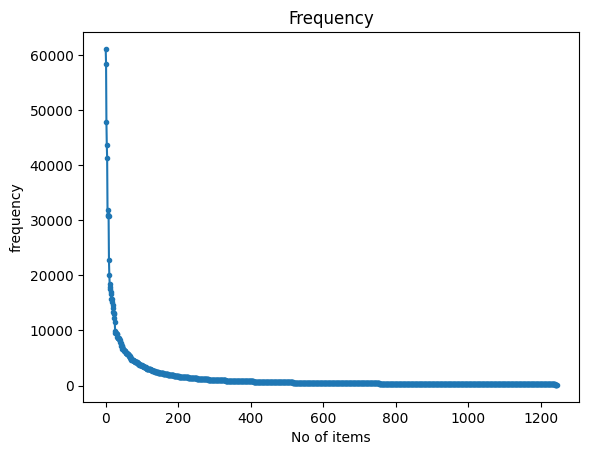

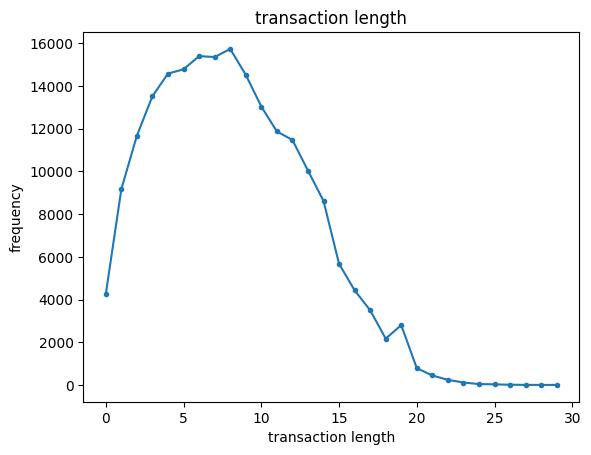

In [16]:
obj_list[0].printStats()
obj_list[0].plotGraphs()

7000 for trust

### anticipation

Database size (total no of transactions) : 247498
Number of items : 1259
Minimum Transaction Size : 1
Average Transaction Size : 10.076723852313958
Maximum Transaction Size : 29
Standard Deviation Transaction Size : 4.931499548672964
Variance in Transaction Sizes : 24.31978606111755
Sparsity : 0.991996247933031


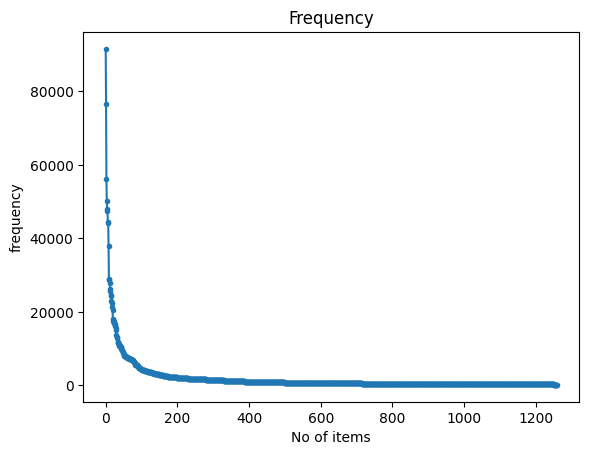

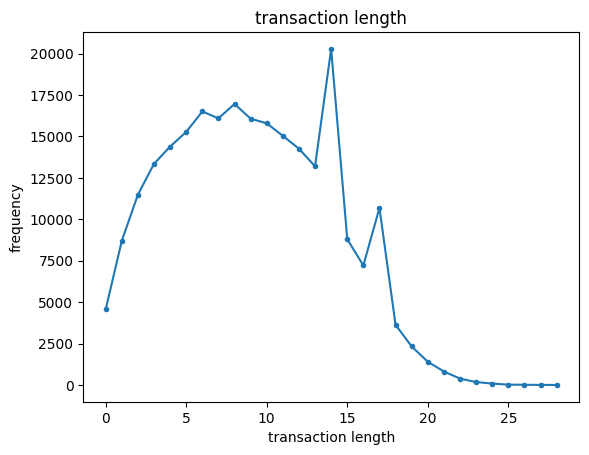

In [17]:
obj_list[1].printStats()
obj_list[1].plotGraphs()

11000 for anticipation

### sadness

Database size (total no of transactions) : 192075
Number of items : 1301
Minimum Transaction Size : 1
Average Transaction Size : 8.970136665365091
Maximum Transaction Size : 27
Standard Deviation Transaction Size : 4.505794902952332
Variance in Transaction Sizes : 20.30229340729372
Sparsity : 0.9931051985662067


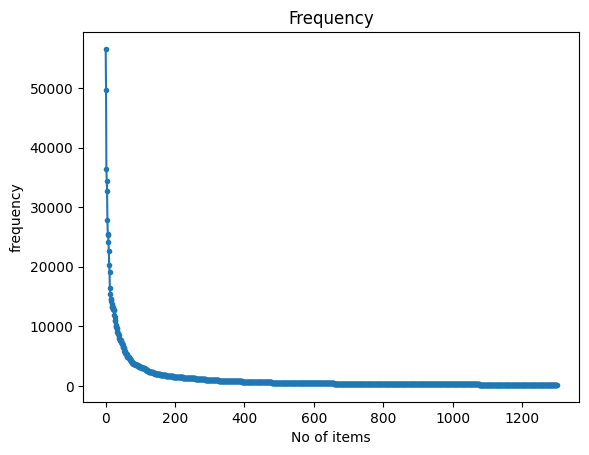

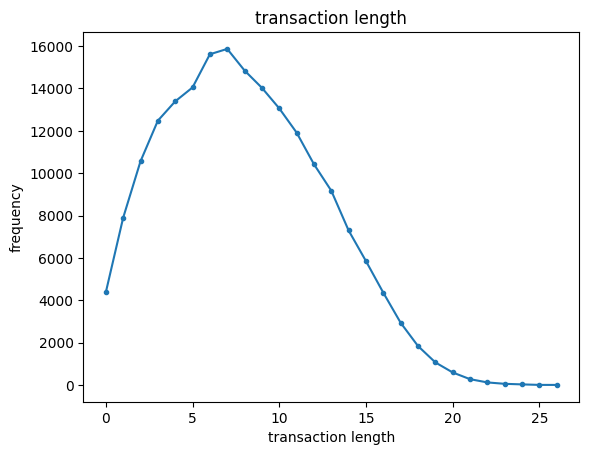

In [18]:
obj_list[2].printStats()
obj_list[2].plotGraphs()

8000 for sadness

### disgust

Database size (total no of transactions) : 138027
Number of items : 1402
Minimum Transaction Size : 1
Average Transaction Size : 9.179537336897853
Maximum Transaction Size : 27
Standard Deviation Transaction Size : 4.613368444388229
Variance in Transaction Sizes : 21.28332260048349
Sparsity : 0.9934525411291741


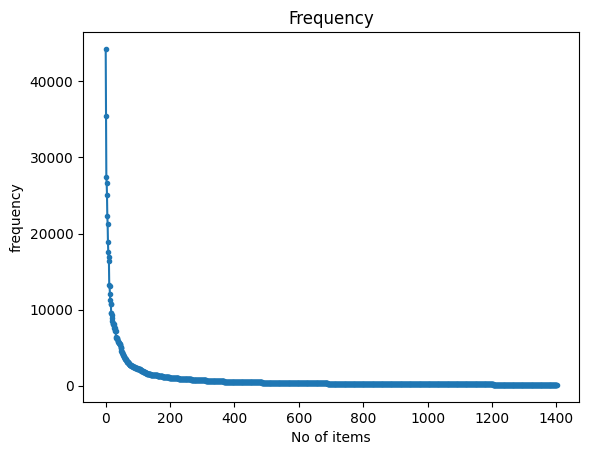

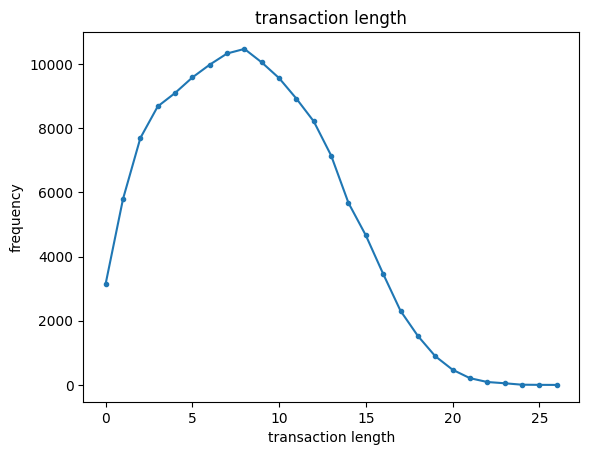

In [19]:
obj_list[3].printStats()
obj_list[3].plotGraphs()

6000 for disgust

### fear

Database size (total no of transactions) : 63269
Number of items : 1039
Minimum Transaction Size : 1
Average Transaction Size : 7.76127329339803
Maximum Transaction Size : 27
Standard Deviation Transaction Size : 4.518113598041846
Variance in Transaction Sizes : 20.413673133708727
Sparsity : 0.9925300545780578


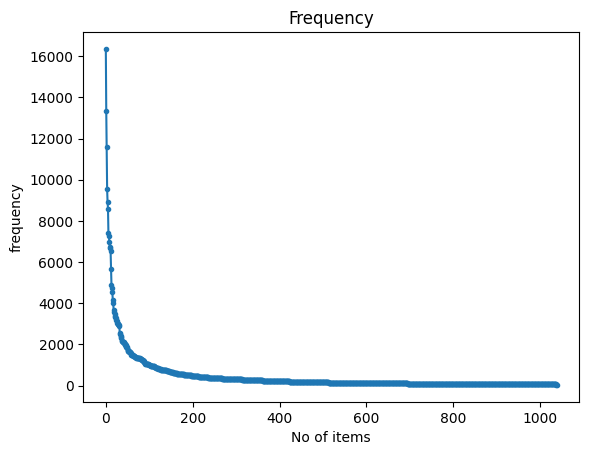

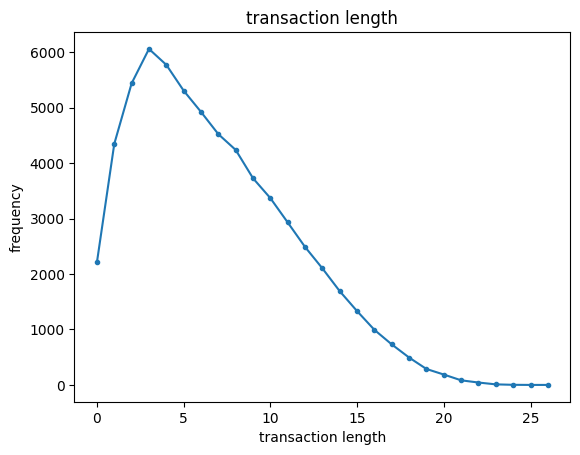

In [20]:
obj_list[4].printStats()
obj_list[4].plotGraphs()

2000 for fear

### surprise

Database size (total no of transactions) : 48361
Number of items : 1259
Minimum Transaction Size : 1
Average Transaction Size : 8.390872810735923
Maximum Transaction Size : 29
Standard Deviation Transaction Size : 4.505942284980414
Variance in Transaction Sizes : 20.30393571668029
Sparsity : 0.9933352876801145


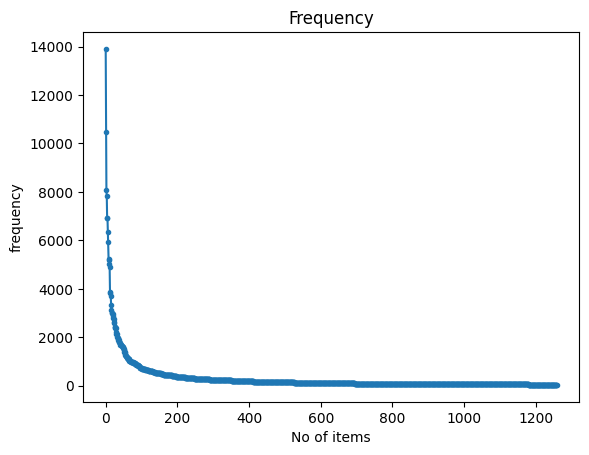

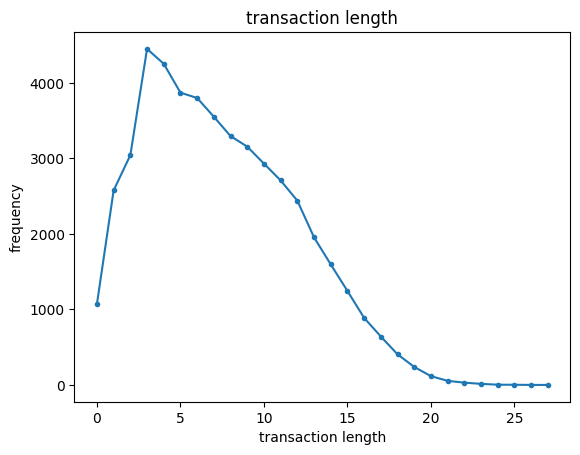

In [21]:
obj_list[5].printStats()
obj_list[5].plotGraphs()

2000 for surprise

## ~~PAMI observation end

In [33]:
from PAMI.frequentPattern.basic import FPGrowth as alg
min_sup_list = [15000*0.7, 7000*0.7, 11000, 8000*0.55, 6000*0.6, 2000*0.6, 2000*0.55, 1700*0.945]
freq_pattern_df_list = []
for i in range(train_df['emotion'].nunique()):
    emotion = train_df['emotion'].unique()[i]
    minSup= min_sup_list[i]
    obj1 = alg.FPGrowth(iFile='data/td_freq_db_' + emotion + '.csv', minSup=int(minSup))
    obj1.mine()
    freq_pattern_df_list.append(obj1.getPatternsAsDataFrame())
    print('Total No of patterns: ' + str(len(freq_pattern_df_list[i]))) #print the total number of patterns
    print('Runtime: ' + str(obj1.getRuntime())) #measure the runtime

Frequent patterns were generated successfully using frequentPatternGrowth algorithm
Total No of patterns: 304
Runtime: 10.508237361907959
Frequent patterns were generated successfully using frequentPatternGrowth algorithm
Total No of patterns: 151
Runtime: 4.846949338912964
Frequent patterns were generated successfully using frequentPatternGrowth algorithm
Total No of patterns: 93
Runtime: 4.75691294670105
Frequent patterns were generated successfully using frequentPatternGrowth algorithm
Total No of patterns: 157
Runtime: 2.930605888366699
Frequent patterns were generated successfully using frequentPatternGrowth algorithm
Total No of patterns: 109
Runtime: 3.940239191055298
Frequent patterns were generated successfully using frequentPatternGrowth algorithm
Total No of patterns: 144
Runtime: 0.9501514434814453
Frequent patterns were generated successfully using frequentPatternGrowth algorithm
Total No of patterns: 100
Runtime: 2.4155335426330566
Frequent patterns were generated success

In [34]:
pattern_counts = {}
for df in freq_pattern_df_list:
    for pattern in df['Patterns']:
        if pattern not in pattern_counts:
            pattern_counts[pattern] = 1
        else:
            pattern_counts[pattern] += 1

# Filter out patterns that appear in more than one dataframe
unique_patterns = {pattern for pattern, count in pattern_counts.items() if count == 1}
# Calculate the total number of patterns across all categories
total_patterns_count = sum(len(df) for df in freq_pattern_df_list)
# Calculate how many patterns were discarded
discarded_patterns_count = total_patterns_count - len(unique_patterns)

# For each category, filter the patterns to keep only the unique ones
filtered_dfs = []
for df in freq_pattern_df_list:
    filtered_df = df[df['Patterns'].isin(unique_patterns)]
    filtered_dfs.append(filtered_df)

# Merge the filtered dataframes into a final dataframe
final_pattern_df = pd.concat(filtered_dfs, ignore_index=True)

# Sort by support
final_pattern_df = final_pattern_df.sort_values(by='Support', ascending=False)

# Display the final result
print(final_pattern_df)
# Print the number of discarded patterns
print(f"Number of patterns discarded: {discarded_patterns_count}")

       Patterns  Support
150   today for    19594
157    love the    18050
151  heart with    17490
187        2017    17412
202     at your    17197
..          ...      ...
258     tonight     1246
257       first     1229
278       so is     1220
286   calls out     1210
284       weird     1165

[294 rows x 2 columns]
Number of patterns discarded: 829


In [35]:
train_df.head()

,tweet_id,identification,emotion,_score,_crawldate,hashtags,text,mentioned,has_top_25,demojized_text,tokenized_text
0,0x29e452,train,joy,809,2015-01-17 03:07:03,[],Huge Respect🖒 @JohnnyVegasReal talking about l...,['JohnnyVegasReal'],False,Huge Respect🖒 @JohnnyVegasReal talking about l...,"{Huge, remember, talking, you, dad, nothing""#b..."
1,0x2b3819,train,joy,808,2016-07-02 09:34:06,"['spateradio', 'app']",Yoooo we hit all our monthly goals with the ne...,[],False,Yoooo we hit all our monthly goals with the ne...,"{our, app, Yoooo, we, #spateradio, goals, all,..."
2,0x2a2acc,train,trust,16,2016-08-15 18:18:39,[],@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...,"['PICU_BCH', 'KIDSNTS', 'uhbcomms', 'BWCHBoss']",False,@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...,"{@uhbcomms, done, you., Well, of, one, every, ..."
3,0x2a8830,train,joy,768,2017-02-11 08:49:46,"['PUBG', 'GamersUnite', 'twitch', 'BeHealthy',...",Come join @ambushman27 on #PUBG while he striv...,['ambushman27'],False,Come join @ambushman27 on #PUBG while he striv...,"{#twitch, for, #vegan, while, join, donners!, ..."
4,0x20b21d,train,anticipation,70,2016-11-23 05:37:10,"['strength', 'bones', 'God']",@fanshixieen2014 Blessings!My #strength little...,['fanshixieen2014'],False,@fanshixieen2014 Blessings!My #strength little...,"{#God., is, brittle.Door, Rev.3:8, Church, My,..."


In [36]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer

# Convert 'text' column into term-document matrix using CountVectorizer
count_vect = CountVectorizer()
X_tdm = count_vect.fit_transform(train_df['demojized_text'])  # X['text'] contains your text data
terms = count_vect.get_feature_names_out()  # Original terms in the vocabulary

# Tokenize the sentences into sets of unique words
train_df['tokenized_text'] = train_df['demojized_text'].str.split().apply(set)

# Initialize the pattern matrix
print(len(train_df.index))
pattern_matrix = pd.DataFrame(0, index=train_df.index, columns=final_pattern_df['Patterns'])

# Iterate over each pattern and check if all words in the pattern are present in the tokenized sentence
for pattern in final_pattern_df['Patterns']:
    pattern_words = set(pattern.split())  # Tokenize pattern into words
    pattern_matrix[pattern] = train_df['tokenized_text'].apply(lambda x: 1 if pattern_words.issubset(x) else 0)

# # Convert the term-document matrix to a DataFrame for easy merging
# tdm_df = pd.DataFrame(X_tdm.toarray(), columns=terms, index=train_df.index)

# # Concatenate the original TDM and the pattern matrix to augment the features
# augmented_df = pd.concat([tdm_df, pattern_matrix], axis=1)

# augmented_df

1455563


The dataset is too large that we can only use the mined stuff.

## dimention reduction

In [37]:
# randomly sample 5000 rows from the pattern matrix
sampled_df = pattern_matrix.sample(n=5000, random_state=42)
tdm_df = sampled_df

In [38]:
#Applying dimensionality reduction with only the document-term frequency data
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import matplotlib.pyplot as plt

#This might take a couple of minutes to execute
# Apply PCA, t-SNE, and UMAP to the data
X_pca_tdm = PCA(n_components=2).fit_transform(tdm_df.values)
print("pca done")
X_tsne_tdm = TSNE(n_components=2).fit_transform(tdm_df.values)
print("tsne done")
X_umap_tdm = umap.UMAP(n_components=2).fit_transform(tdm_df.values)
print("umap done")

pca done
tsne done
umap done


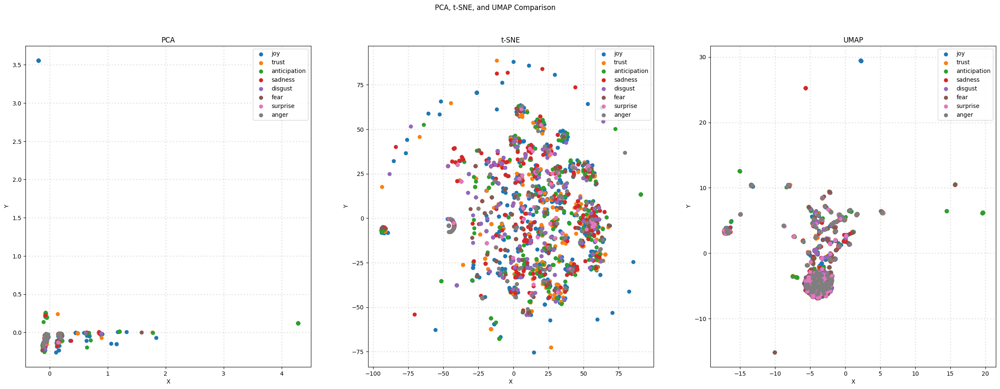

In [58]:
# Plot the results in subplots
# eight color names
colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b', '#e377c2', '#7f7f7f', '#bcbd22', '#17becf']
emotions = train_df['emotion'].unique() 

fig, axes = plt.subplots(1, 3, figsize=(30, 10))  # Create 3 subplots for PCA, t-SNE, and UMAP
fig.suptitle('PCA, t-SNE, and UMAP Comparison')

# Define a function to create a scatter plot for each method
def plot_scatter(ax, X_reduced, title):
    for c, emotion in zip(colors, emotions):
        reduced_train = train_df.iloc[tdm_df.index]
        xs = X_reduced[reduced_train['emotion'] == emotion ].T[0]
        ys = X_reduced[reduced_train['emotion'] == emotion].T[1]
        ax.scatter(xs, ys, c=c, marker='o', label=emotion)
    
    ax.grid(color='gray', linestyle=':', linewidth=2, alpha=0.2)
    ax.set_title(title)
    ax.set_xlabel('X')
    ax.set_ylabel('Y')
    ax.legend(loc='upper right')

# Step 4: Create scatter plots for PCA, t-SNE, and UMAP
plot_scatter(axes[0], X_pca_tdm, 'PCA')
plot_scatter(axes[1], X_tsne_tdm, 't-SNE')
plot_scatter(axes[2], X_umap_tdm, 'UMAP')

plt.show()

## Prepare for training (NB)

In [23]:
top_25

['realDonaldTrump',
 'FifthHarmony',
 'POTUS',
 'MostRequestLive',
 'OnAirRomeo',
 'DonnieWahlberg',
 'FoxNews',
 'CNN',
 'IssaRae',
 'Browns',
 'thehill',
 'GOP',
 'edsheeran',
 'VP',
 'MATTHARDYBRAND',
 'SoCalTelevision',
 'NFL',
 'SenJohnMcCain',
 'WWE',
 'BTS_twt',
 'Twitter',
 'BarackObama',
 'taylorswift13',
 'YouTube',
 'vuliwear']

In [20]:
train_df.head()

,tweet_id,identification,emotion,_score,_crawldate,hashtags,text,mentioned,has_top_25
0,0x29e452,train,joy,809,2015-01-17 03:07:03,[],Huge Respect🖒 @JohnnyVegasReal talking about l...,[JohnnyVegasReal],False
1,0x2b3819,train,joy,808,2016-07-02 09:34:06,"['spateradio', 'app']",Yoooo we hit all our monthly goals with the ne...,[],False
2,0x2a2acc,train,trust,16,2016-08-15 18:18:39,[],@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...,"[BWCHBoss, KIDSNTS, PICU_BCH, uhbcomms]",False
3,0x2a8830,train,joy,768,2017-02-11 08:49:46,"['PUBG', 'GamersUnite', 'twitch', 'BeHealthy',...",Come join @ambushman27 on #PUBG while he striv...,[ambushman27],False
4,0x20b21d,train,anticipation,70,2016-11-23 05:37:10,"['strength', 'bones', 'God']",@fanshixieen2014 Blessings!My #strength little...,[fanshixieen2014],False


In [24]:
# add the binary array of the top 25 mentioned people to the dataframe, it should be a array of length 25
train_df['mentioned_bin'] = train_df['mentioned'].apply(lambda x: [1 if person in x else 0 for person in top_25])
test_df['mentioned_bin'] = test_df['mentioned'].apply(lambda x: [1 if person in x else 0 for person in top_25])

In [61]:
# create emotion index for train_df
train_df['emotion_index'] = train_df['emotion'].factorize()[0]

In [81]:
import pandas as pd
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, accuracy_score, f1_score

category_mapping = dict(train_df[['emotion_index', 'emotion']].drop_duplicates().values)
target_names = [category_mapping[label] for label in sorted(category_mapping.keys())]
info_matrix = pd.concat([pattern_matrix, pd.DataFrame(train_df['mentioned_bin'].tolist())], axis=1)
info_matrix.columns = info_matrix.columns.astype(str)
X_train, X_test, y_train, y_test = train_test_split(info_matrix, train_df['emotion_index'], test_size=0.3, random_state=42)

In [79]:
X_train.head()


,today for,love the,heart with,2017,at your,lots,eyes,2017 at,your in,total,...,15,16,17,18,19,20,21,22,23,24
33715,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1160154,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1026555,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1081729,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
796068,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [82]:
# Train the Naive Bayes classifier
nb_classifier = MultinomialNB()
nb_classifier.fit(X_train, y_train)

# Make predictions on the test set
y_pred = nb_classifier.predict(X_test)

# Evaluate the classifier
print("Accuracy:", accuracy_score(y_test, y_pred))
print("mean F1 Score:", f1_score(y_test, y_pred, average='macro'))
print("\nClassification Report:\n", classification_report(y_test, y_pred, target_names=target_names, digits=4))

Accuracy: 0.36470644813348324
mean F1 Score: 0.1728271856739134

Classification Report:
               precision    recall  f1-score   support

         joy     0.3835    0.8291    0.5244    154838
       trust     0.2680    0.1002    0.1459     61548
anticipation     0.3826    0.1142    0.1759     74605
     sadness     0.5418    0.1588    0.2456     57962
     disgust     0.1587    0.1250    0.1398     41898
        fear     0.2790    0.0813    0.1259     19273
    surprise     0.2338    0.0111    0.0212     14611
       anger     0.0719    0.0020    0.0039     11934

    accuracy                         0.3647    436669
   macro avg     0.2899    0.1777    0.1728    436669
weighted avg     0.3484    0.3647    0.2890    436669



WOW... This is so pathetically horrible...

# Prepare training for Bert model

## Handling @mentions

In [13]:
top_25

['realDonaldTrump',
 'FifthHarmony',
 'POTUS',
 'MostRequestLive',
 'OnAirRomeo',
 'DonnieWahlberg',
 'FoxNews',
 'CNN',
 'IssaRae',
 'Browns',
 'thehill',
 'GOP',
 'edsheeran',
 'VP',
 'MATTHARDYBRAND',
 'SoCalTelevision',
 'NFL',
 'SenJohnMcCain',
 'WWE',
 'BTS_twt',
 'Twitter',
 'BarackObama',
 'taylorswift13',
 'YouTube',
 'vuliwear']

In [14]:
top_25_name = ['Donald J. Trump', 'Fifth Harmony', 'Joe Biden', 'Most Requested Live', 'On Air Romeo', 'Donnie Wahlberg', 'Fox News', 'CNN', 'Issa Rae', 'Cleveland Browns', 'The Hill', 'GOP', 'Ed Sheeran HQ', 'Vice President', 'MATT HARDY', 'BEST OF SOCAL • TRAVEL & FOOD with Jason', 'NFL', 'John McCain', 'WWE', 'BTS_official', 'Twitter', 'BarackObama', 'Taylor Swift', 'YouTube', 'Vuli Eyewear']
top_25_dict = {top_25[i] : top_25_name[i] for i in range(len(top_25))}

In [15]:
import ast
test_df["mentioned"] = test_df["mentioned"].apply(ast.literal_eval)
train_df["mentioned"] = train_df["mentioned"].apply(ast.literal_eval)

In [16]:
# replace mentioned people in the tweet with their names and other person in the tweet as 'someone A', 'someone B' ... CHATGPT
def replace_mentions_across_columns(text, mentions, top_25_dict):
    replacement_counter = 1  # Counter for placeholders like Person A, Person B
    for mention in mentions:
        if mention in top_25_dict:
            # Replace with actual name
            text = text.replace(f"@{mention}", top_25_dict[mention])
        else:
            # Replace with placeholder
            placeholder = f"Person {chr(64 + replacement_counter)}"
            text = text.replace(f"@{mention}", placeholder)
            replacement_counter += 1
    return text

# Apply the function
train_df["processed_text"] = train_df.apply(
    lambda row: replace_mentions_across_columns(
        row["demojized_text"], row["mentioned"], top_25_dict
    ),
    axis=1,
)
test_df["processed_text"] = test_df.apply(
    lambda row: replace_mentions_across_columns(
        row["demojized_text"], row["mentioned"], top_25_dict
    ),
    axis=1,
)


In [17]:
test_df['demojized_text'].head()

0    @Habbo I've seen two separate colours of the e...
1    @FoxNews @KellyannePolls No serious self respe...
2    Looking for a new car, and it says 1 lady owne...
3    @cineworld "only the brave" just out and fount...
4    Felt like total dog  going into open gym and h...
Name: demojized_text, dtype: object

In [18]:
test_df['processed_text'].head()

0    Person A I've seen two separate colours of the...
1    Fox News Person A No serious self respecting i...
2    Looking for a new car, and it says 1 lady owne...
3    Person A "only the brave" just out and fountai...
4    Felt like total dog  going into open gym and h...
Name: processed_text, dtype: object

In [39]:
# add the binary array of the top 25 mentioned people to the dataframe, it should be a array of length 25
train_df['mentioned_bin'] = train_df['mentioned'].apply(lambda x: [1 if person in x else 0 for person in top_25])

## Handling hashtags

In [19]:
# replace hashtagged words "#word" with "# word"
train_df["processed_text"] = train_df["processed_text"].str.replace(r"#", "# ")
test_df["processed_text"] = test_df["processed_text"].str.replace(r"#", "# ")

In [20]:
train_df['processed_text'].head()

0    Huge Respect🖒 Person A talking about losing hi...
1    Yoooo we hit all our monthly goals with the ne...
2    Person B Person A Person C Person D Well done ...
3    Come join Person A on # PUBG while he strives ...
4    Person A Blessings!My # strength little. My # ...
Name: processed_text, dtype: object

In [5]:
import ast
test_df["hashtags"] = test_df["hashtags"].apply(ast.literal_eval)
train_df["hashtags"] = train_df["hashtags"].apply(ast.literal_eval)

In [6]:
# find the total number of unique tags in column hashtags
unique_hashtag = set()
for hashtags in train_df['hashtags']:
    unique_hashtag.update(hashtags)
print(len(unique_hashtag))

392892


In [40]:
train_df['hashtags']

0                                                         []
1                                          [spateradio, app]
2                                                         []
3          [PUBG, GamersUnite, twitch, BeHealthy, StayPos...
4                                     [strength, bones, God]
                                 ...                        
1455558                                                [rip]
1455559        [libtards, Hillary, lost, sad, growup, Trump]
1455560                              [seeds, Joy, GLTChurch]
1455561                                                   []
1455562                                                   []
Name: hashtags, Length: 1455563, dtype: object

so many hashtags used wow

In [7]:
# plot the appear time of hashtags sorted by frequency where x is the hashtag count and y is the frequency

import matplotlib.pyplot as plt
from collections import Counter

# calculate the frequency of each hashtag
hashtag_counts = Counter()
for hashtags in train_df['hashtags']:
    hashtag_counts.update(hashtags)

# sort the hashtags by frequency
sorted_hashtags = sorted(hashtag_counts.items(), key=lambda x: x[1], reverse=True)

hashtag_df = pd.DataFrame(sorted_hashtags, columns=["Hashtag", "Count"])

C:\Users\Owner\AppData\Local\Temp\ipykernel_31072\3445210417.py:7: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




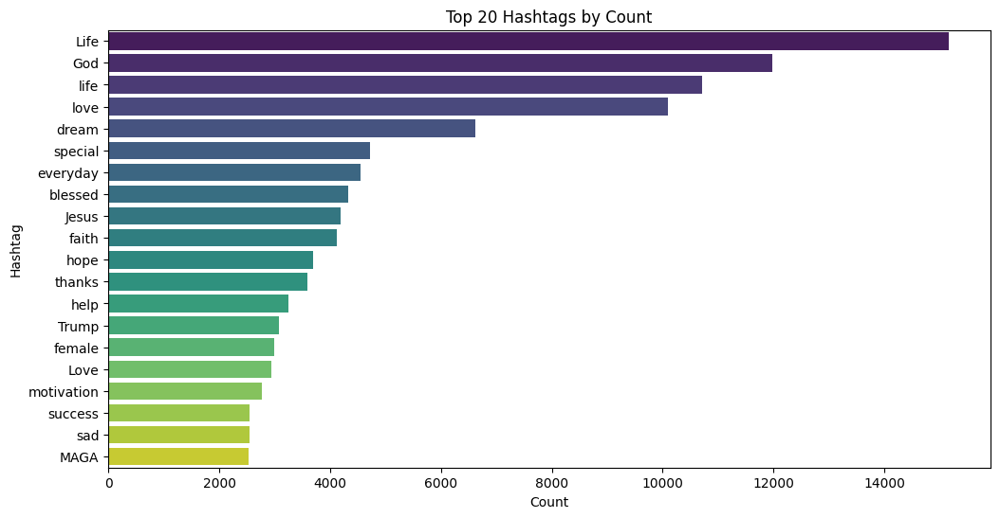

In [36]:
import matplotlib.pyplot as plt
import seaborn as sns

# Plot the top 20 hashtags (or all if there are fewer)
top_n = 20
plt.figure(figsize=(12, 6))
sns.barplot(x="Count", y="Hashtag", data=hashtag_df.head(top_n), palette="viridis")

plt.title(f"Top {top_n} Hashtags by Count")
plt.xlabel("Count")
plt.ylabel("Hashtag")
plt.show()


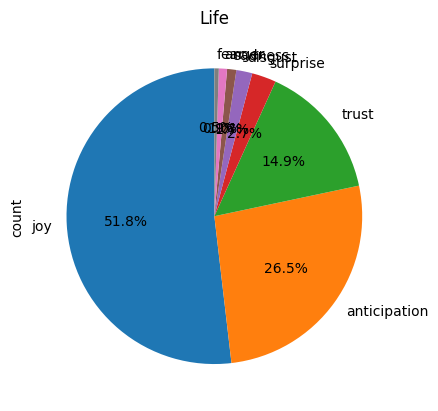

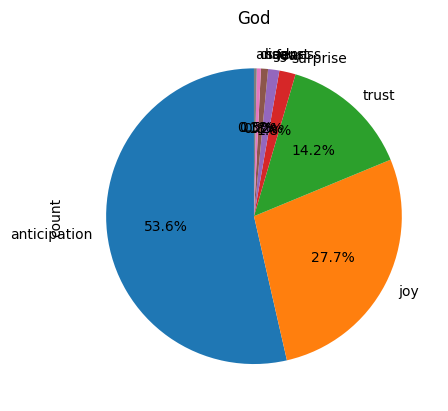

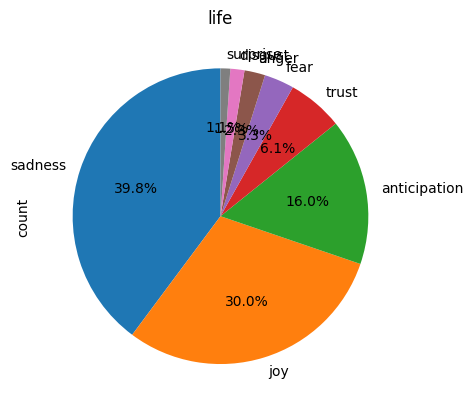

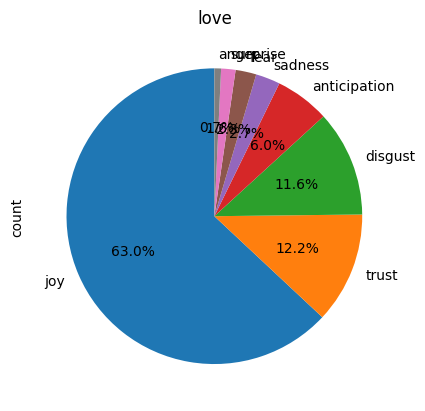

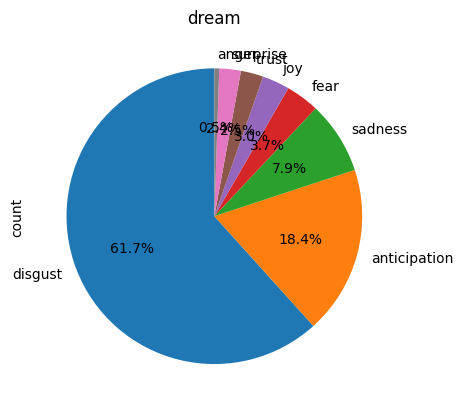

...

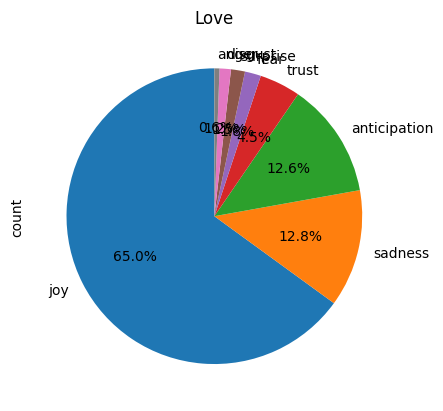

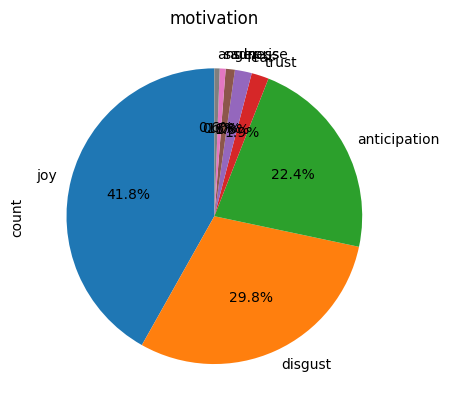

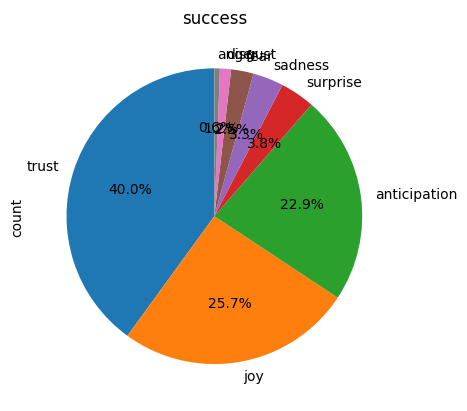

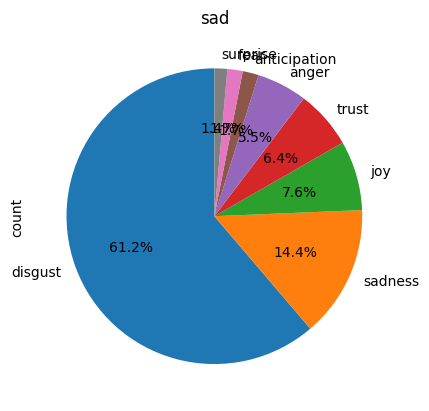

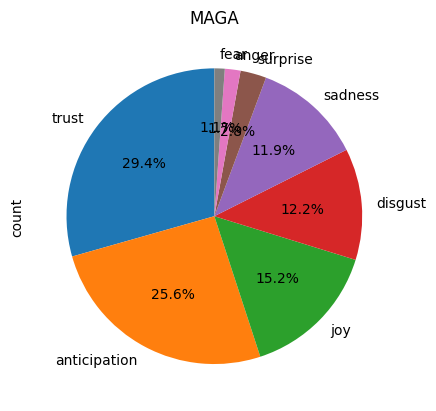

In [37]:
# plot the pie chart of the top 20 hashtags by percentage of emotions that hashtag appears in

for hashtag in hashtag_df['Hashtag'].head(20):
    emotion_df = train_df[train_df['text'].str.contains(hashtag)]
    # color the pie chart by emotion
    emotion_df['emotion'].value_counts().plot(kind='pie', autopct='%1.1f%%', labels=emotion_df['emotion'].unique(), startangle=90)
    plt.title(hashtag)
    plt.show()

In [43]:
hashtag_df['Hashtag']

0                          Life
1                           God
2                          life
3                          love
4                         dream
                  ...          
392887              hayleyflays
392888    gottagetmyassinthegym
392889              kcttechpark
392890            projeccelator
392891                 ldsquote
Name: Hashtag, Length: 392892, dtype: object

In [12]:
# add the binary array of the top 200 used hashtag to the dataframe, it should be a array of length 200
most_used_hashtag = hashtag_df['Hashtag'].head(200).tolist()
train_df['hashtag_bin'] = train_df['hashtags'].apply(lambda x: [1 if hashtag in x else 0 for hashtag in most_used_hashtag])
test_df['hashtag_bin'] = test_df['hashtags'].apply(lambda x: [1 if hashtag in x else 0 for hashtag in most_used_hashtag])

In [13]:
len(train_df['hashtag_bin'][0])

200

## replace _ with spaces

In [ ]:
train_df['processed_text'] = train_df['processed_text'].str.replace('_', ' ')
test_df['processed_text'] = test_df['processed_text'].str.replace('_', ' ')
train_df['processed_text'] = train_df['processed_text'].str.replace('-', ' ')
test_df['processed_text'] = test_df['processed_text'].str.replace('-', ' ')
train_df['hashtag_bin'] = train_df['hashtags'].apply(lambda x: [1 if hashtag in x else 0 for hashtag in most_used_hashtag])
test_df['hashtag_bin'] = test_df['hashtags'].apply(lambda x: [1 if hashtag in x else 0 for hashtag in most_used_hashtag])
train_df['mentioned_bin'] = train_df['mentioned'].apply(lambda x: [1 if person in x else 0 for person in top_25])
test_df['mentioned_bin'] = test_df['mentioned'].apply(lambda x: [1 if person in x else 0 for person in top_25])

In [16]:
train_df.to_csv('data/train_dfv4.csv', index=False)
test_df.to_csv('data/test_dfv4.csv', index=False)

In [57]:
train_df.head()

,tweet_id,identification,emotion,_score,_crawldate,hashtags,text,mentioned,has_top_25,demojized_text,processed_text,mentioned_bin,hashtag_bin
0,0x29e452,train,joy,809,2015-01-17 03:07:03,[],Huge Respect🖒 @JohnnyVegasReal talking about l...,[JohnnyVegasReal],False,Huge Respect🖒 @JohnnyVegasReal talking about l...,Huge Respect🖒 Person A talking about losing hi...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
1,0x2b3819,train,joy,808,2016-07-02 09:34:06,"[spateradio, app]",Yoooo we hit all our monthly goals with the ne...,[],False,Yoooo we hit all our monthly goals with the ne...,Yoooo we hit all our monthly goals with the ne...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
2,0x2a2acc,train,trust,16,2016-08-15 18:18:39,[],@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...,"[PICU_BCH, KIDSNTS, uhbcomms, BWCHBoss]",False,@KIDSNTS @PICU_BCH @uhbcomms @BWCHBoss Well do...,Person B Person A Person C Person D Well done ...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
3,0x2a8830,train,joy,768,2017-02-11 08:49:46,"[PUBG, GamersUnite, twitch, BeHealthy, StayPos...",Come join @ambushman27 on #PUBG while he striv...,[ambushman27],False,Come join @ambushman27 on #PUBG while he striv...,Come join Person A on # PUBG while he strives ...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."
4,0x20b21d,train,anticipation,70,2016-11-23 05:37:10,"[strength, bones, God]",@fanshixieen2014 Blessings!My #strength little...,[fanshixieen2014],False,@fanshixieen2014 Blessings!My #strength little...,Person A Blessings!My # strength little. My # ...,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ..."


In [ ]:
# get the time of the oldest and newest tweet
print(min(train_df['_crawldate']))
print(max(train_df['_crawldate']))

2015-01-01 01:00:36
2017-12-28 23:58:37


# Introduce the bert model

In [1]:
import json
import pandas as pd
import numpy as np
import plotly
plotly.offline.init_notebook_mode()
train_df = pd.read_csv('data/train_dfv4.csv')
test_df = pd.read_csv('data/test_dfv4.csv')

In [2]:
import transformers as T
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from torch.optim import AdamW
from tqdm import tqdm
from torchmetrics import SpearmanCorrCoef, Accuracy, F1Score
device = "cuda" if torch.cuda.is_available() else "cpu"
from transformers import BertModel
import warnings
warnings.simplefilter(action='ignore')
import gc
from peft import get_peft_config, get_peft_model, LoraConfig, TaskType

In [42]:
# generate emotion id as column in train_df
emotion_id = {emotion: i for i, emotion in enumerate(train_df['emotion'].unique())}
train_df['emotion_idx'] = train_df['emotion'].map(emotion_id)

## Attempt 1 Utilizing the MASK token

In [ ]:
tokenizer = T.BertTokenizer.from_pretrained('bert-base-uncased')
lr = 1e-4
epochs = 40
train_batch_size = 64
validation_batch_size = 8
embed_dim = 768
hidden_dim = 768
num_classes = 8
top_n = 3
freeze = False
mention_bin_size = 25
hashtag_bin_size = 200

In [5]:
template = " This makes me feel so [MASK]."
mask_train_df = pd.DataFrame()
mask_train_df['text'] = train_df["processed_text"] + template
mask_train_df['emotion'] = train_df['emotion']
mask_train_df['emotion_idx'] = train_df['emotion_idx']

In [6]:
class TextDataset(Dataset):
    def __init__(self, dataframe, text_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.text_column = text_column

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        text = self.dataframe.iloc[idx][self.text_column]
        return {"text": text, "emotion_idx": self.dataframe.iloc[idx]["emotion_idx"]}

In [28]:
train_df['mentioned_bin'] = train_df['mentioned'].apply(lambda x: [1 if person in x else 0 for person in top_25])
test_df['mentioned_bin'] = test_df['mentioned'].apply(lambda x: [1 if person in x else 0 for person in top_25])

In [30]:
len(train_df['hashtag_bin'])

1455563

In [ ]:
class MaskModel(torch.nn.Module):
    def __init__(self, *args, **kwargs):
        super().__init__(*args, **kwargs)
        # Write your code here
        # Define what modules you will use in the model
        # Define your model
        self.bert = T.BertForMaskedLM.from_pretrained("bert-base-uncased")
        self.tokenizer = T.BertTokenizer.from_pretrained("bert-base-uncased")
        for param in self.bert.parameters():
            param.requires_grad = False
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.vocab_size, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, **kwargs):
        # Write your code here
        # Forward pass
        mask_token_index = torch.where(kwargs["input_ids"] == self.tokenizer.mask_token_id)
        outputs = self.bert(**kwargs)
        mask_logits = outputs.logits[mask_token_index]
        c_output = self.classification_head(mask_logits)
        
        return c_output

In [8]:
def collate_fn(batch):
    # TODO1-1: Implement the collate_fn function
    # Write your code here
    # The input parameter is a data batch (tuple), and this function packs it into tensors.
    # Use tokenizer to pack tokenize and pack the data and its corresponding labels.
    # Return the data batch and labels for each sub-task.
    text = [sample['text'] for sample in batch]
    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long)
    
    inputs = tokenizer(text, padding=True, truncation=True, return_tensors="pt").to(device)

    return inputs, emotion_idx

In [9]:
dl_train = DataLoader(
    TextDataset(mask_train_df, "text"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn
)
sampled_mask_df = mask_train_df.sample(frac=0.05)
# do the train_test_split of the sampled dataframe with a ratio of 0.8:0.2
sampled_mask_train_df, sampled_mask_validation_df = train_test_split(sampled_mask_df, test_size=0.2, random_state=42)


dl_train_sampled = DataLoader(
    TextDataset(sampled_mask_train_df, "text"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn
)
dl_validation_sampled = DataLoader(
    TextDataset(sampled_mask_validation_df, "text"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn
)

In [10]:
sampled_mask_train_df.head()

,text,emotion,emotion_idx
655408,Drink the souls of Pepsi drinkers past! # pep...,joy,0
961436,Donald J. Trump You have consistently failed a...,sadness,3
628475,We were created to live a life in the 'faith l...,anticipation,2
1023549,Very lazy Sunday with all this rain Have a on...,joy,0
766737,Person A Some of us got it at a $1K This ma...,trust,1


In [11]:
def train(dl_train, dl_validation, model, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    for ep in range(epochs):
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        for inputs, emotion_idx in pbar:
            model.to(device)
            # Move data to device
            emotion_idx = emotion_idx.to(device)
            inputs = inputs.to(device)
            # train your model
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            class_pred = model(**inputs)
            
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            del emotion_idx, inputs
            torch.cuda.empty_cache()
            n += 1
            if n % 50 == 0:
                pbar.set_postfix(loss = total_loss.item(), classification_loss = classification_loss.item())

        pbar = tqdm(dl_validation)
        pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
        model.eval()
        # TODO5: Write the evaluation loop
        b = 0
        classification_loss = 0
        all_class_preds = []
        all_classification_labels = []
        for inputs, emotion_idx in pbar:
            model.to(device)
            emotion_idx = emotion_idx.to(device)
            class_pred = model(**inputs)
            classification_loss += classification_criterion(class_pred, emotion_idx).item()
            all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
            all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
            b += 1
            del emotion_idx, inputs
            torch.cuda.empty_cache()
        f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        avg_class_loss = classification_loss/b
        # Write your code here
        # Evaluate your model
        print(f"{avg_class_loss = :.4f}")

        # Output all the evaluation scores (SpearmanCorrCoef, Accuracy, F1Score)
        print(f"F1 Score = {f1_score}, accuracy = {accuracy}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (len(top_n_models) < top_n):
            
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        elif (avg_class_loss < max([m[1] for m in top_n_models])):
            max_loss_tuple = max(top_n_models, key=lambda x: x[1])
            # Remove the tuple with the highest loss
            top_n_models.remove(max_loss_tuple)
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [12]:
model = MaskModel().to(device)
# TODO3-1: Define your Optimizer
optimizer = torch.optim.Adam(model.classification_head.parameters(), lr=lr)

# TODO3-2: Define your loss functions (you should have two)
# Write your code here
classification_criterion = torch.nn.CrossEntropyLoss().to(device)

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

BertForMaskedLM has generative capabilities, as `prepare_inputs_for_generation` is explicitly overwritten. However, it doesn't directly inherit from `GenerationMixin`. From 👉v4.50👈 onwards, `PreTrainedModel` will NOT inherit from `GenerationMixin`, and this model will lose the ability to call `generate` and other related functions.
  - If you're using `trust_remote_code=True`, you can get rid of this warning by loading the model with an auto class. See https://huggingface.co/docs/transformers/en/model_doc/auto#auto-classes
  - If you are the owner of the model architecture code, please modify your model class such that it inherits from `GenerationMixin` (after `PreTrainedModel`, otherwise you'll get an exception).
  - If you are not the owner of the model architecture class, please contact the model code owner to update it.
Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertForMaskedLM: ['bert.pooler.dense.bias', 'bert.pooler.dense.weight', 'c

In [13]:
train(dl_train_sampled, dl_validation_sampled, model, device, optimizer, classification_criterion, f1, acc, "masked_sample")

Validation epoch [1/40]: 100%|██████████| 228/228 [00:24<00:00,  9.39it/s]


avg_class_loss = 1.6202
F1 Score = 0.19105201959609985, accuracy = 0.41426214575767517


Validation epoch [2/40]: 100%|██████████| 228/228 [00:24<00:00,  9.40it/s]


avg_class_loss = 1.6063
F1 Score = 0.20090702176094055, accuracy = 0.42765870690345764


Validation epoch [3/40]: 100%|██████████| 228/228 [00:24<00:00,  9.38it/s]


avg_class_loss = 1.5757
F1 Score = 0.17958644032478333, accuracy = 0.4199642837047577


Validation epoch [4/40]: 100%|██████████| 228/228 [00:24<00:00,  9.38it/s]


avg_class_loss = 1.5588
F1 Score = 0.21396547555923462, accuracy = 0.4365210235118866


Validation epoch [5/40]: 100%|██████████| 228/228 [00:24<00:00,  9.30it/s]


avg_class_loss = 1.5337
F1 Score = 0.18871405720710754, accuracy = 0.4334295094013214


Validation epoch [6/40]: 100%|██████████| 228/228 [00:24<00:00,  9.33it/s]


avg_class_loss = 1.5330
F1 Score = 0.21090587973594666, accuracy = 0.43308600783348083


Validation epoch [7/40]: 100%|██████████| 228/228 [00:24<00:00,  9.29it/s]


avg_class_loss = 1.5516
F1 Score = 0.2035355567932129, accuracy = 0.42106348276138306


Validation epoch [8/40]: 100%|██████████| 228/228 [00:24<00:00,  9.32it/s]


avg_class_loss = 1.5375
F1 Score = 0.19377218186855316, accuracy = 0.42807090282440186


Validation epoch [9/40]: 100%|██████████| 228/228 [00:24<00:00,  9.27it/s]


avg_class_loss = 1.5195
F1 Score = 0.23232430219650269, accuracy = 0.43507832288742065


Validation epoch [10/40]: 100%|██████████| 228/228 [00:24<00:00,  9.30it/s]


avg_class_loss = 1.5276
F1 Score = 0.2168368697166443, accuracy = 0.43871942162513733


Validation epoch [11/40]: 100%|██████████| 228/228 [00:24<00:00,  9.29it/s]


avg_class_loss = 1.5032
F1 Score = 0.217424675822258, accuracy = 0.4446963369846344


Validation epoch [12/40]: 100%|██████████| 228/228 [00:24<00:00,  9.30it/s]


avg_class_loss = 1.5186
F1 Score = 0.22889840602874756, accuracy = 0.4460703432559967


Validation epoch [13/40]: 100%|██████████| 228/228 [00:24<00:00,  9.31it/s]


avg_class_loss = 1.5002
F1 Score = 0.22764292359352112, accuracy = 0.44270405173301697


Validation epoch [14/40]: 100%|██████████| 228/228 [00:24<00:00,  9.32it/s]


avg_class_loss = 1.4925
F1 Score = 0.22269491851329803, accuracy = 0.44696345925331116


Validation epoch [15/40]: 100%|██████████| 228/228 [00:24<00:00,  9.31it/s]


avg_class_loss = 1.4886
F1 Score = 0.23407961428165436, accuracy = 0.44888705015182495


Validation epoch [16/40]: 100%|██████████| 228/228 [00:24<00:00,  9.30it/s]


avg_class_loss = 1.4974
F1 Score = 0.2334073781967163, accuracy = 0.44737565517425537


Validation epoch [17/40]: 100%|██████████| 228/228 [00:24<00:00,  9.30it/s]


avg_class_loss = 1.4828
F1 Score = 0.23417328298091888, accuracy = 0.45259687304496765


Validation epoch [18/40]: 100%|██████████| 228/228 [00:24<00:00,  9.32it/s]


avg_class_loss = 1.4927
F1 Score = 0.23953993618488312, accuracy = 0.4488183557987213


Validation epoch [19/40]: 100%|██████████| 228/228 [00:24<00:00,  9.26it/s]


avg_class_loss = 1.4895
F1 Score = 0.22291745245456696, accuracy = 0.4484061598777771


Validation epoch [20/40]: 100%|██████████| 228/228 [00:24<00:00,  9.20it/s]


avg_class_loss = 1.4829
F1 Score = 0.235073059797287, accuracy = 0.4519098699092865


Validation epoch [21/40]: 100%|██████████| 228/228 [00:24<00:00,  9.37it/s]


avg_class_loss = 1.4911
F1 Score = 0.2289111316204071, accuracy = 0.44943666458129883


Validation epoch [22/40]: 100%|██████████| 228/228 [00:24<00:00,  9.42it/s]


avg_class_loss = 1.4935
F1 Score = 0.22731754183769226, accuracy = 0.4487496614456177


Validation epoch [23/40]: 100%|██████████| 228/228 [00:24<00:00,  9.36it/s]


avg_class_loss = 1.4830
F1 Score = 0.23828239738941193, accuracy = 0.45513877272605896


Validation epoch [24/40]: 100%|██████████| 228/228 [00:24<00:00,  9.35it/s]


avg_class_loss = 1.4743
F1 Score = 0.24458865821361542, accuracy = 0.4547952711582184


Validation epoch [25/40]: 100%|██████████| 228/228 [00:24<00:00,  9.37it/s]


avg_class_loss = 1.4840
F1 Score = 0.24323417246341705, accuracy = 0.45239076018333435


Validation epoch [26/40]: 100%|██████████| 228/228 [00:24<00:00,  9.33it/s]


avg_class_loss = 1.4758
F1 Score = 0.24016454815864563, accuracy = 0.45452046394348145


Validation epoch [27/40]: 100%|██████████| 228/228 [00:24<00:00,  9.26it/s]


avg_class_loss = 1.4766
F1 Score = 0.23725010454654694, accuracy = 0.4534899592399597


Validation epoch [28/40]: 100%|██████████| 228/228 [00:24<00:00,  9.35it/s]


avg_class_loss = 1.4742
F1 Score = 0.22507940232753754, accuracy = 0.45218467712402344


Validation epoch [29/40]: 100%|██████████| 228/228 [00:24<00:00,  9.28it/s]


avg_class_loss = 1.4746
F1 Score = 0.2512570023536682, accuracy = 0.45761197805404663


Validation epoch [30/40]: 100%|██████████| 228/228 [00:24<00:00,  9.30it/s]


avg_class_loss = 1.4644
F1 Score = 0.25503867864608765, accuracy = 0.46015387773513794


Validation epoch [31/40]: 100%|██████████| 228/228 [00:24<00:00,  9.36it/s]


avg_class_loss = 1.4613
F1 Score = 0.24272969365119934, accuracy = 0.4559631645679474


Validation epoch [32/40]: 100%|██████████| 228/228 [00:24<00:00,  9.40it/s]


avg_class_loss = 1.4631
F1 Score = 0.24932502210140228, accuracy = 0.4602912962436676


Validation epoch [33/40]: 100%|██████████| 228/228 [00:25<00:00,  8.85it/s]


avg_class_loss = 1.4814
F1 Score = 0.2437230795621872, accuracy = 0.4476504623889923


Validation epoch [34/40]: 100%|██████████| 228/228 [00:25<00:00,  8.89it/s]


avg_class_loss = 1.4533
F1 Score = 0.24794979393482208, accuracy = 0.46139049530029297


Validation epoch [35/40]: 100%|██████████| 228/228 [00:25<00:00,  8.93it/s]


avg_class_loss = 1.4777
F1 Score = 0.2268694043159485, accuracy = 0.4491618573665619


Validation epoch [36/40]: 100%|██████████| 228/228 [00:25<00:00,  8.88it/s]


avg_class_loss = 1.4651
F1 Score = 0.23292134702205658, accuracy = 0.4558257758617401


Validation epoch [37/40]: 100%|██████████| 228/228 [00:25<00:00,  8.83it/s]


avg_class_loss = 1.4802
F1 Score = 0.2461494654417038, accuracy = 0.45410826802253723


Validation epoch [38/40]: 100%|██████████| 228/228 [00:25<00:00,  8.93it/s]


avg_class_loss = 1.4846
F1 Score = 0.23230168223381042, accuracy = 0.44133004546165466


Validation epoch [39/40]: 100%|██████████| 228/228 [00:25<00:00,  8.90it/s]


avg_class_loss = 1.4629
F1 Score = 0.23696781694889069, accuracy = 0.4514976739883423


Validation epoch [40/40]: 100%|██████████| 228/228 [00:25<00:00,  8.87it/s]


avg_class_loss = 1.4585
F1 Score = 0.25392836332321167, accuracy = 0.459947794675827


RuntimeError: Parent directory ./saved_models does not exist.

## Attempt 2 Bert Normal

In [1]:
class TextDataset(Dataset):
    def __init__(self, dataframe, text_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.text_column = text_column

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        return {"text": self.dataframe.iloc[idx][self.text_column], "emotion_idx": self.dataframe.iloc[idx]["emotion_idx"]}


NameError: name 'Dataset' is not defined

In [21]:
class BertClassModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)
        # Write your code here
        # Define what modules you will use in the model
        # Define your model

        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, **kwargs):
        # Write your code here
        # Forward pass
        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(cls_output)
        
        return c_output

In [6]:
def collate_fn(batch):
    # TODO1-1: Implement the collate_fn function
    # Write your code here
    # The input parameter is a data batch (tuple), and this function packs it into tensors.
    # Use tokenizer to pack tokenize and pack the data and its corresponding labels.
    # Return the data batch and labels for each sub-task.
    text = [sample['text'] for sample in batch]
    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long).to(device)
    
    inputs = tokenizer(text, padding=True, truncation=True, return_tensors="pt").to(device)

    return inputs, emotion_idx

In [ ]:
def train(dl_train, dl_validation, model, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    best_epoch = -1
    best_loss = 100
    for ep in range(epochs):
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        model.to(device)
        epoch_loss = 0

        for inputs, emotion_idx in pbar:
            # train your model
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            class_pred = model(**inputs)
            
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            epoch_loss += total_loss.item()
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            # del emotion_idx, inputs, classification_loss
            # torch.cuda.empty_cache()
            n += 1
            
            if n % 50 == 0:
                pbar.set_postfix(loss = total_loss.item())
        epoch_loss /= n
        print(f"{epoch_loss = :.4f}")
        pbar = tqdm(dl_validation)
        pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
        model.eval()
        # TODO5: Write the evaluation loop
        b = 0
        classification_loss = 0
        all_class_preds = []
        all_classification_labels = []
        for inputs, emotion_idx in pbar:
            class_pred = model(**inputs)
            classification_loss += classification_criterion(class_pred, emotion_idx).item()
            all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
            all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
            b += 1
            # del emotion_idx, inputs
            # torch.cuda.empty_cache()
            # gc.collect()
        f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        avg_class_loss = classification_loss/b
        # Write your code here
        # Evaluate your model
        print(f"{avg_class_loss = :.4f}")

        # Output all the evaluation scores (SpearmanCorrCoef, Accuracy, F1Score)
        print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (len(top_n_models) < top_n):
            
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        elif (avg_class_loss < max([m[1] for m in top_n_models])):
            max_loss_tuple = max(top_n_models, key=lambda x: x[1])
            # Remove the tuple with the highest loss
            top_n_models.remove(max_loss_tuple)
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        if (avg_class_loss < best_loss):
            best_loss = avg_class_loss
            best_epoch = ep
        if (ep - best_epoch > 5):
            break
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [ ]:
def train_fragment(dl_train_list, dl_validation, model, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    best_epoch = -1
    best_loss = 100
    for ep in range(epochs):
        dl_train = dl_train_list[ep % len(dl_train_list)]
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        model.to(device)
        epoch_loss = 0

        for inputs, emotion_idx in pbar:
            # train your model
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            class_pred = model(**inputs)
            
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            epoch_loss += total_loss.item()
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            # del emotion_idx, inputs, classification_loss
            # torch.cuda.empty_cache()
            n += 1
            
            if n % 50 == 0:
                pbar.set_postfix(loss = total_loss.item())
        epoch_loss /= n
        print(f"{epoch_loss = :.4f}")
        pbar = tqdm(dl_validation)
        pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
        model.eval()
        # TODO5: Write the evaluation loop
        b = 0
        classification_loss = 0
        all_class_preds = []
        all_classification_labels = []
        for inputs, emotion_idx in pbar:
            class_pred = model(**inputs)
            classification_loss += classification_criterion(class_pred, emotion_idx).item()
            all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
            all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
            b += 1
            # del emotion_idx, inputs
            # torch.cuda.empty_cache()
            # gc.collect()
        f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        avg_class_loss = classification_loss/b
        # Write your code here
        # Evaluate your model
        print(f"{avg_class_loss = :.4f}")

        # Output all the evaluation scores (SpearmanCorrCoef, Accuracy, F1Score)
        print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (len(top_n_models) < top_n):
            
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        elif (avg_class_loss < max([m[1] for m in top_n_models])):
            max_loss_tuple = max(top_n_models, key=lambda x: x[1])
            # Remove the tuple with the highest loss
            top_n_models.remove(max_loss_tuple)
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        if (avg_class_loss < best_loss):
            best_loss = avg_class_loss
            best_epoch = ep
        if (ep - best_epoch > 15):
            break
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [15]:
tokenizer = T.BertTokenizer.from_pretrained('bert-base-uncased')
lr = 3e-5
epochs = 10
train_batch_size = 24
validation_batch_size = 24
embed_dim = 768
hidden_dim = 768
num_classes = 8
top_n = 3
freeze = False
mention_bin_size = 25
hashtag_bin_size = 200

### train with one set of data

In [10]:
sampled_df = train_df.sample(frac=0.1)
sampled_df['text'] = sampled_df['processed_text']
sampled_df = sampled_df[["text", "emotion_idx"]]
# do the train_test_split of the sampled dataframe with a ratio of 0.8:0.2
sampled_train_df, sampled_validation_df = train_test_split(sampled_df, test_size=0.2, random_state=42)
# drop the indexes that are in sampled validation
truncated_train_df = train_df.drop(sampled_validation_df.index)



dl_train_sampled = DataLoader(
    TextDataset(sampled_train_df, "text"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn
)
dl_validation_sampled = DataLoader(
    TextDataset(sampled_validation_df, "text"),
    batch_size = validation_batch_size,
    shuffle = True,
    collate_fn = collate_fn
)

In [ ]:
b_model = BertModel.from_pretrained('bert-base-uncased')
peft_config = LoraConfig(
    inference_mode=False, r=8, lora_alpha=32, lora_dropout=0.1
)
b_model = get_peft_model(b_model, peft_config)
model = BertClassModel(bert=b_model).to(device)
# TODO3-1: Define your Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

# TODO3-2: Define your loss functions (you should have two)
# Write your code here
classification_criterion = torch.nn.CrossEntropyLoss().to(device)

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

In [26]:
torch.cuda.memory._record_memory_history()
train(dl_train_sampled, dl_validation_sampled, model, device, optimizer, classification_criterion, f1, acc, "BERT_sample_PEFT")

Training epoch [1/10]:   0%|          | 0/7278 [00:00<?, ?it/s]

Training epoch [1/10]: 100%|██████████| 7278/7278 [05:28<00:00, 22.14it/s, loss=1.01] 


epoch_loss = 1.4041


Validation epoch [1/10]: 100%|██████████| 1820/1820 [00:45<00:00, 40.32it/s]


avg_class_loss = 1.2827
F1 Score = 0.4264, accuracy = 0.5333


Training epoch [2/10]: 100%|██████████| 7278/7278 [05:28<00:00, 22.19it/s, loss=1.43] 


epoch_loss = 1.2599


Validation epoch [2/10]: 100%|██████████| 1820/1820 [00:45<00:00, 40.10it/s]


avg_class_loss = 1.2188
F1 Score = 0.4559, accuracy = 0.5550


Training epoch [3/10]: 100%|██████████| 7278/7278 [05:42<00:00, 21.27it/s, loss=1.02] 


epoch_loss = 1.2011


Validation epoch [3/10]: 100%|██████████| 1820/1820 [00:45<00:00, 39.66it/s]


avg_class_loss = 1.1910
F1 Score = 0.4751, accuracy = 0.5649


Training epoch [4/10]: 100%|██████████| 7278/7278 [05:32<00:00, 21.86it/s, loss=0.693]


epoch_loss = 1.1600


Validation epoch [4/10]: 100%|██████████| 1820/1820 [00:45<00:00, 40.05it/s]


avg_class_loss = 1.1676
F1 Score = 0.4886, accuracy = 0.5749


Training epoch [5/10]: 100%|██████████| 7278/7278 [05:41<00:00, 21.34it/s, loss=1.25] 


epoch_loss = 1.1279


Validation epoch [5/10]: 100%|██████████| 1820/1820 [00:48<00:00, 37.28it/s]


avg_class_loss = 1.1522
F1 Score = 0.4964, accuracy = 0.5808


Training epoch [6/10]: 100%|██████████| 7278/7278 [05:40<00:00, 21.35it/s, loss=1.23] 


epoch_loss = 1.0960


Validation epoch [6/10]: 100%|██████████| 1820/1820 [00:47<00:00, 38.22it/s]


avg_class_loss = 1.1596
F1 Score = 0.4945, accuracy = 0.5816


Training epoch [7/10]: 100%|██████████| 7278/7278 [05:44<00:00, 21.12it/s, loss=0.824]


epoch_loss = 1.0686


Validation epoch [7/10]: 100%|██████████| 1820/1820 [00:48<00:00, 37.46it/s]


avg_class_loss = 1.1615
F1 Score = 0.4963, accuracy = 0.5827


Training epoch [8/10]: 100%|██████████| 7278/7278 [06:22<00:00, 19.01it/s, loss=0.914]


epoch_loss = 1.0384


Validation epoch [8/10]: 100%|██████████| 1820/1820 [00:52<00:00, 34.43it/s]


avg_class_loss = 1.1581
F1 Score = 0.5004, accuracy = 0.5830


Training epoch [9/10]: 100%|██████████| 7278/7278 [05:56<00:00, 20.39it/s, loss=1.23] 


epoch_loss = 1.0089


Validation epoch [9/10]: 100%|██████████| 1820/1820 [00:51<00:00, 35.45it/s]


avg_class_loss = 1.1621
F1 Score = 0.5019, accuracy = 0.5831


Training epoch [10/10]: 100%|██████████| 7278/7278 [06:11<00:00, 19.61it/s, loss=0.811]


epoch_loss = 0.9763


Validation epoch [10/10]: 100%|██████████| 1820/1820 [00:51<00:00, 35.15it/s]


avg_class_loss = 1.1743
F1 Score = 0.5053, accuracy = 0.5806


### train with fraction of whole

In [11]:
sampled_df = train_df.sample(frac=0.1)
sampled_df['text'] = sampled_df['processed_text']
sampled_df = sampled_df[["text", "emotion_idx"]]
# do the train_test_split of the sampled dataframe with a ratio of 0.8:0.2
sampled_train_df, sampled_validation_df = train_test_split(sampled_df, test_size=0.2, random_state=42)
# drop the indexes that are in sampled validation
truncated_train_df = train_df.drop(sampled_validation_df.index)
# Create a random permutation of indices
random_indices = np.random.permutation(len(truncated_train_df))

# Split indices into 10 approximately equal parts
split_indices = np.array_split(random_indices, 10)

# Create the 10 subsets
subsets = [truncated_train_df.iloc[indices] for indices in split_indices]

dl_train_list = [DataLoader(
    TextDataset(df, "text"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn
) for df in subsets]
dl_validation_sampled = DataLoader(
    TextDataset(sampled_validation_df, "text"),
    batch_size = validation_batch_size,
    shuffle = True,
    collate_fn = collate_fn
)

In [ ]:
# b_model = BertModel.from_pretrained('bert-base-uncased')
# peft_config = LoraConfig(
#     inference_mode=False, r=8, lora_alpha=32, lora_dropout=0.1
# )
# b_model = get_peft_model(b_model, peft_config)
# model = BertClassModel(bert=b_model).to(device)
model = torch.load("./saved_models/BERT_fragmented_PEFT_ep24_loss1.048.ckpt").to(device)
# TODO3-1: Define your Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

# TODO3-2: Define your loss functions (you should have two)
# Write your code here
classification_criterion = torch.nn.CrossEntropyLoss().to(device)

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

In [16]:
epochs = 30

In [17]:
train_fragment(dl_train_list, dl_validation_sampled, model, device, optimizer, classification_criterion, f1, acc, "BERT_fragmented_PEFT")

Training epoch [1/30]: 100%|██████████| 8916/8916 [06:03<00:00, 24.52it/s, loss=0.887]


epoch_loss = 0.9994


Validation epoch [1/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.06it/s]


avg_class_loss = 1.0548
F1 Score = 0.5356, accuracy = 0.6171


Training epoch [2/30]: 100%|██████████| 8916/8916 [06:02<00:00, 24.58it/s, loss=1.44] 


epoch_loss = 0.9894


Validation epoch [2/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.13it/s]


avg_class_loss = 1.0558
F1 Score = 0.5313, accuracy = 0.6142


Training epoch [3/30]: 100%|██████████| 8916/8916 [06:03<00:00, 24.52it/s, loss=0.814]


epoch_loss = 0.9902


Validation epoch [3/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.12it/s]


avg_class_loss = 1.0508
F1 Score = 0.5398, accuracy = 0.6171


Training epoch [4/30]: 100%|██████████| 8916/8916 [06:02<00:00, 24.60it/s, loss=0.582]


epoch_loss = 0.9918


Validation epoch [4/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.14it/s]


avg_class_loss = 1.0542
F1 Score = 0.5327, accuracy = 0.6155


Training epoch [5/30]: 100%|██████████| 8916/8916 [06:00<00:00, 24.71it/s, loss=0.8]  


epoch_loss = 0.9926


Validation epoch [5/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.04it/s]


avg_class_loss = 1.0539
F1 Score = 0.5365, accuracy = 0.6170


Training epoch [6/30]: 100%|██████████| 8916/8916 [06:00<00:00, 24.72it/s, loss=0.874]


epoch_loss = 0.9920


Validation epoch [6/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.07it/s]


avg_class_loss = 1.0502
F1 Score = 0.5337, accuracy = 0.6176


Training epoch [7/30]: 100%|██████████| 8916/8916 [06:01<00:00, 24.64it/s, loss=0.973]


epoch_loss = 0.9896


Validation epoch [7/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.08it/s]


avg_class_loss = 1.0556
F1 Score = 0.5375, accuracy = 0.6174


Training epoch [8/30]: 100%|██████████| 8916/8916 [06:00<00:00, 24.72it/s, loss=0.851]


epoch_loss = 0.9967


Validation epoch [8/30]: 100%|██████████| 1820/1820 [00:40<00:00, 44.53it/s]


avg_class_loss = 1.0514
F1 Score = 0.5385, accuracy = 0.6172


Training epoch [9/30]: 100%|██████████| 8916/8916 [06:03<00:00, 24.49it/s, loss=1.2]  


epoch_loss = 0.9895


Validation epoch [9/30]: 100%|██████████| 1820/1820 [00:39<00:00, 45.69it/s]


avg_class_loss = 1.0552
F1 Score = 0.5370, accuracy = 0.6183


Training epoch [10/30]: 100%|██████████| 8916/8916 [06:04<00:00, 24.45it/s, loss=1.1]  


epoch_loss = 0.9895


Validation epoch [10/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.07it/s]


avg_class_loss = 1.0530
F1 Score = 0.5317, accuracy = 0.6173


Training epoch [11/30]: 100%|██████████| 8916/8916 [06:03<00:00, 24.52it/s, loss=1.01] 


epoch_loss = 0.9887


Validation epoch [11/30]: 100%|██████████| 1820/1820 [00:39<00:00, 45.61it/s]


avg_class_loss = 1.0526
F1 Score = 0.5377, accuracy = 0.6189


Training epoch [12/30]: 100%|██████████| 8916/8916 [06:08<00:00, 24.20it/s, loss=0.332]


epoch_loss = 0.9786


Validation epoch [12/30]: 100%|██████████| 1820/1820 [00:39<00:00, 45.91it/s]


avg_class_loss = 1.0571
F1 Score = 0.5358, accuracy = 0.6157


Training epoch [13/30]: 100%|██████████| 8916/8916 [06:08<00:00, 24.22it/s, loss=1.17] 


epoch_loss = 0.9766


Validation epoch [13/30]: 100%|██████████| 1820/1820 [00:41<00:00, 44.21it/s]


avg_class_loss = 1.0512
F1 Score = 0.5429, accuracy = 0.6191


Training epoch [14/30]: 100%|██████████| 8916/8916 [06:20<00:00, 23.46it/s, loss=1.07] 


epoch_loss = 0.9798


Validation epoch [14/30]: 100%|██████████| 1820/1820 [00:42<00:00, 43.18it/s]


avg_class_loss = 1.0513
F1 Score = 0.5399, accuracy = 0.6181


Training epoch [15/30]: 100%|██████████| 8916/8916 [06:28<00:00, 22.95it/s, loss=1.03] 


epoch_loss = 0.9799


Validation epoch [15/30]: 100%|██████████| 1820/1820 [00:40<00:00, 44.64it/s]


avg_class_loss = 1.0580
F1 Score = 0.5375, accuracy = 0.6152


Training epoch [16/30]: 100%|██████████| 8916/8916 [06:19<00:00, 23.51it/s, loss=0.65] 


epoch_loss = 0.9789


Validation epoch [16/30]: 100%|██████████| 1820/1820 [00:41<00:00, 43.82it/s]


avg_class_loss = 1.0532
F1 Score = 0.5388, accuracy = 0.6195


Training epoch [17/30]: 100%|██████████| 8916/8916 [06:25<00:00, 23.12it/s, loss=1.53] 


epoch_loss = 0.9757


Validation epoch [17/30]: 100%|██████████| 1820/1820 [00:44<00:00, 41.35it/s]


avg_class_loss = 1.0570
F1 Score = 0.5354, accuracy = 0.6172


Training epoch [18/30]: 100%|██████████| 8916/8916 [06:22<00:00, 23.28it/s, loss=0.954]


epoch_loss = 0.9838


Validation epoch [18/30]: 100%|██████████| 1820/1820 [00:40<00:00, 44.73it/s]


avg_class_loss = 1.0561
F1 Score = 0.5354, accuracy = 0.6163


Training epoch [19/30]: 100%|██████████| 8916/8916 [06:16<00:00, 23.69it/s, loss=0.781]


epoch_loss = 0.9770


Validation epoch [19/30]: 100%|██████████| 1820/1820 [00:42<00:00, 43.10it/s]


avg_class_loss = 1.0545
F1 Score = 0.5388, accuracy = 0.6180


Training epoch [20/30]: 100%|██████████| 8916/8916 [06:21<00:00, 23.34it/s, loss=1.23] 


epoch_loss = 0.9769


Validation epoch [20/30]: 100%|██████████| 1820/1820 [00:41<00:00, 43.52it/s]


avg_class_loss = 1.0520
F1 Score = 0.5371, accuracy = 0.6173


Training epoch [21/30]: 100%|██████████| 8916/8916 [06:21<00:00, 23.34it/s, loss=1.13] 


epoch_loss = 0.9756


Validation epoch [21/30]: 100%|██████████| 1820/1820 [00:41<00:00, 43.41it/s]


avg_class_loss = 1.0540
F1 Score = 0.5405, accuracy = 0.6190


Training epoch [22/30]: 100%|██████████| 8916/8916 [06:19<00:00, 23.48it/s, loss=0.964]


epoch_loss = 0.9670


Validation epoch [22/30]: 100%|██████████| 1820/1820 [00:41<00:00, 43.80it/s]


avg_class_loss = 1.0569
F1 Score = 0.5358, accuracy = 0.6179


Training epoch [23/30]: 100%|██████████| 8916/8916 [06:20<00:00, 23.44it/s, loss=1.07] 


epoch_loss = 0.9638


Validation epoch [23/30]: 100%|██████████| 1820/1820 [00:41<00:00, 43.62it/s]


avg_class_loss = 1.0480
F1 Score = 0.5418, accuracy = 0.6177


Training epoch [24/30]: 100%|██████████| 8916/8916 [06:20<00:00, 23.43it/s, loss=0.501]


epoch_loss = 0.9672


Validation epoch [24/30]: 100%|██████████| 1820/1820 [00:41<00:00, 43.45it/s]


avg_class_loss = 1.0559
F1 Score = 0.5375, accuracy = 0.6181


Training epoch [25/30]: 100%|██████████| 8916/8916 [06:24<00:00, 23.17it/s, loss=0.93] 


epoch_loss = 0.9685


Validation epoch [25/30]: 100%|██████████| 1820/1820 [01:11<00:00, 25.49it/s]


avg_class_loss = 1.0636
F1 Score = 0.5344, accuracy = 0.6137


Training epoch [26/30]: 100%|██████████| 8916/8916 [11:18<00:00, 13.14it/s, loss=0.85] 


epoch_loss = 0.9665


Validation epoch [26/30]: 100%|██████████| 1820/1820 [00:44<00:00, 41.05it/s]


avg_class_loss = 1.0567
F1 Score = 0.5338, accuracy = 0.6178


Training epoch [27/30]: 100%|██████████| 8916/8916 [07:21<00:00, 20.19it/s, loss=1.07] 


epoch_loss = 0.9669


Validation epoch [27/30]: 100%|██████████| 1820/1820 [01:33<00:00, 19.40it/s]


avg_class_loss = 1.0639
F1 Score = 0.5356, accuracy = 0.6149


Training epoch [28/30]: 100%|██████████| 8916/8916 [13:14<00:00, 11.22it/s, loss=1.06] 


epoch_loss = 0.9710


Validation epoch [28/30]: 100%|██████████| 1820/1820 [01:34<00:00, 19.32it/s]


avg_class_loss = 1.0582
F1 Score = 0.5350, accuracy = 0.6154


Training epoch [29/30]: 100%|██████████| 8916/8916 [09:08<00:00, 16.25it/s, loss=0.963]


epoch_loss = 0.9646


Validation epoch [29/30]: 100%|██████████| 1820/1820 [01:16<00:00, 23.91it/s]


avg_class_loss = 1.0574
F1 Score = 0.5368, accuracy = 0.6180


Training epoch [30/30]: 100%|██████████| 8916/8916 [11:39<00:00, 12.74it/s, loss=1.36] 


epoch_loss = 0.9657


Validation epoch [30/30]: 100%|██████████| 1820/1820 [00:40<00:00, 44.73it/s]


avg_class_loss = 1.0502
F1 Score = 0.5430, accuracy = 0.6192


In [32]:
def collate_fn_test(batch):
    # TODO1-1: Implement the collate_fn function
    # Write your code here
    # The input parameter is a data batch (tuple), and this function packs it into tensors.
    # Use tokenizer to pack tokenize and pack the data and its corresponding labels.
    # Return the data batch and labels for each sub-task.
    text = [sample['text'] for sample in batch]
    inputs = tokenizer(text, padding=True, truncation=True, return_tensors="pt").to(device)

    return inputs
class TextDatasetTest(Dataset):
    def __init__(self, dataframe, text_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.text_column = text_column

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        return {"text": self.dataframe.iloc[idx][self.text_column]}

In [ ]:
def generate_test_result(model, test_dl, device, f1, acc):
    model.eval()
    model.to(device)
    with torch.no_grad():
        y_preds = []
        pbar = tqdm(test_dl)
        for inputs in pbar:
            outputs = model(**inputs)
            y_preds.extend(outputs.argmax(dim=1).cpu().detach().numpy())
    id_emotion = {0: 'joy', 1: 'trust', 2: 'anticipation', 3: 'sadness', 4: 'disgust', 5: 'fear', 6: 'surprise', 7: 'anger'}
    y_preds = [id_emotion[i] for i in y_preds]
    return y_preds

In [50]:
# generate test result
sample_df = pd.read_csv("data/sampleSubmission.csv")
test_df['text'] = test_df['processed_text']
t2_df = pd.DataFrame({"text": test_df['processed_text']})
test_dl = DataLoader(
    TextDatasetTest(t2_df, "text"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_test
)
model = torch.load("./saved_models/BERT_fragmented_PEFT_ep24_loss1.048.ckpt")
y_preds = generate_test_result(model, test_dl,  device, f1, acc)

100%|██████████| 17166/17166 [09:26<00:00, 30.31it/s]


In [52]:
result_df = pd.DataFrame({"id": test_df['tweet_id'], "emotion": y_preds})
result_df.to_csv("result_sample2.csv", index=False)

In [49]:
result_df

,id,emotion
0,0x28cc61,sadness
1,0x2db41f,disgust
2,0x2466f6,sadness
3,0x23f9e9,sadness
4,0x1fb4e1,joy
...,...,...
411967,0x2c4dc2,trust
411968,0x31be7c,anticipation
411969,0x1ca58e,sadness
411970,0x35c8ba,joy


### try to finetune the classification head

In [ ]:

import os
import re
models_prefixes = ["BERT_sample"]
best_models = {}
models_directory = "./saved_models"
for prefix in models_prefixes:
    lowest_loss = float('inf')
    best_model_file = None
    
    # Iterate over each file in the directory
    for file_name in os.listdir(models_directory):
        # Check if the file matches the pattern for the current prefix
        match = re.match(rf"{prefix}_ep\d+_loss(\d+\.\d+)\.ckpt", file_name)
        
        if match:
            # Extract the loss value from the matched file
            loss = float(match.group(1))
            
            # Update the best model file if this one has a lower loss
            if loss < lowest_loss:
                lowest_loss = loss
                best_model_file = file_name
    
    # Store the best model for this prefix in the dictionary
    if best_model_file:
        best_models[prefix] = models_directory + "/" + best_model_file

# Output the dictionary with the best models for each prefix
print(best_models)

{'BERT_sample': './saved_models/BERT_sample_ep14_loss1.340.ckpt'}


In [16]:
model = best_models["BERT_sample"]
model = torch.load(model)
model = model.to(device)

In [17]:
# freeze the parameter of the model in the bert layer
for param in model.bert.parameters():
    param.requires_grad = False
# use the optimizer with the new parameters
optimizer = torch.optim.Adam(model.classification_head.parameters(), lr=lr)
classification_criterion = torch.nn.CrossEntropyLoss().to(device)
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

In [18]:
train(dl_train_sampled, dl_validation_sampled, model, device, optimizer, classification_criterion, f1, acc, "BERT_sample_finetune_head")

Validation epoch [1/20]: 100%|██████████| 455/455 [00:19<00:00, 23.94it/s]


avg_class_loss = 1.3688
F1 Score = 0.3943, accuracy = 0.5130


Validation epoch [2/20]: 100%|██████████| 455/455 [00:19<00:00, 23.86it/s]


avg_class_loss = 1.3785
F1 Score = 0.4021, accuracy = 0.5118


Validation epoch [3/20]: 100%|██████████| 455/455 [00:19<00:00, 23.67it/s]


avg_class_loss = 1.3836
F1 Score = 0.3993, accuracy = 0.5057


Validation epoch [4/20]: 100%|██████████| 455/455 [00:19<00:00, 23.36it/s]


avg_class_loss = 1.3934
F1 Score = 0.3922, accuracy = 0.5041


Training epoch [5/20]:  28%|██▊       | 505/1820 [00:21<00:54, 23.96it/s, loss=1.15] 


KeyboardInterrupt: 

## Approach 3 Bert Extended

### perhaps ignore this

In [19]:
tfidf_length = 768

In [21]:
from sklearn.feature_extraction.text import TfidfVectorizer
tfidf = TfidfVectorizer(max_features = tfidf_length, ngram_range=(1, 2))
train_tfidf = tfidf.fit_transform(train_df["processed_text"])
train_tfidf_df = pd.DataFrame.sparse.from_spmatrix(train_tfidf)
train_tfidf_df.columns = [f"tfidf{i}" for i in range(tfidf_length)]
test_tfidf = tfidf.transform(test_df["processed_text"])
test_tfidf_df = pd.DataFrame.sparse.from_spmatrix(test_tfidf)
test_tfidf_df.columns = [f"tfidf{i}" for i in range(tfidf_length)]
train_df = pd.concat([train_df, train_tfidf_df], axis=1)
test_df = pd.concat([test_df, test_tfidf_df], axis=1)

### perhaps start from here

In [1]:
import json
import pandas as pd
import numpy as np
import plotly
plotly.offline.init_notebook_mode()
import transformers as T
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from torch.optim import AdamW
from tqdm import tqdm
from torchmetrics import SpearmanCorrCoef, Accuracy, F1Score
device = "cuda" if torch.cuda.is_available() else "cpu"
from transformers import BertModel
import warnings
warnings.simplefilter(action='ignore')
import gc
from peft import get_peft_config, get_peft_model, LoraConfig, TaskType
import torch.nn.functional as F

In [2]:
train_df = pd.read_csv("data/train_df.csv")
test_df = pd.read_csv("data/test_df.csv")

In [3]:
tqdm.pandas()
for column in train_df.columns:
    if type(train_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(train_df[column].iloc[0])) != list:
                train_df[column] = [json.loads(x) for x in train_df[column]]
            else:
                train_df[column] = [np.array(json.loads(x) for x in train_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                train_df[column] = [np.array(json.loads(x)) for x in train_df[column]]
            print("fail")
gc.collect()


tweet_id
success
emotion
success
combined
fail
text
success
tokenized
fail


40

In [4]:
for column in test_df.columns:
    if type(test_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(test_df[column].iloc[0])) != list:
                test_df[column] = [json.loads(x) for x in test_df[column]]
            else:
                test_df[column] = [np.array(json.loads(x) for x in test_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                test_df[column] = [np.array(json.loads(x)) for x in test_df[column]]
            print("fail")
gc.collect()

tweet_id
success
combined
fail
text
success
tokenized
fail


0

In [5]:
class ExtendedTextDataset(Dataset):
    def __init__(self, dataframe, text_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.text_column = text_column
        
    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        # hashtag_bin = concatnate of hashtag_bin1, hashtag_bin2, ... hashtag_bin25
        return {"text": self.dataframe.iloc[idx][self.text_column], "emotion_idx": self.dataframe.iloc[idx]["emotion_idx"], "data" : self.dataframe.iloc[idx]["combined"]}

In [6]:
class ExtendedTextDatasetPreTokenized(Dataset):
    def __init__(self, dataframe, tokenized_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.tokenized_column = tokenized_column
        
    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        # hashtag_bin = concatnate of hashtag_bin1, hashtag_bin2, ... hashtag_bin25
        return {"tokenized": self.dataframe.iloc[idx][self.tokenized_column], "emotion_idx": self.dataframe.iloc[idx]["emotion_idx"], "data" : self.dataframe.iloc[idx]["combined"]}

In [7]:
def collate_fn(batch):
    # TODO1-1: Implement the collate_fn function
    # Write your code here
    # The input parameter is a data batch (tuple), and this function packs it into tensors.
    # Use tokenizer to pack tokenize and pack the data and its corresponding labels.
    # Return the data batch and labels for each sub-task.
    text = [sample['text'] for sample in batch]
    # print(text)
    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long).to(device)
    data = torch.tensor([sample['data'] for sample in batch], dtype=torch.float).to(device)
    
    inputs = tokenizer(text, padding=True, truncation=True, return_tensors="pt").to(device)

    return inputs, emotion_idx, data

In [8]:
def collate_fn_pre_tokenized(batch):
    # TODO1-1: Implement the collate_fn function
    # Write your code here
    # The input parameter is a data batch (tuple), and this function packs it into tensors.
    # Use tokenizer to pack tokenize and pack the data and its corresponding labels.
    # Return the data batch and labels for each sub-task.
    # Determine max length in the batch for padding
    encoded_texts = [sample['tokenized'] for sample in batch]
    max_length = min(tokenizer_max_len, max(len(seq) for seq in encoded_texts))  # Adjust for max BERT input length

    # Pad sequences to max length
    padded_texts = [np.append(seq, [pad_id] * (max_length - len(seq))) for seq in encoded_texts]
    padded_texts = np.array(padded_texts)

    # Create attention masks
    attention_masks = [[1] * len(seq) + [0] * (max_length - len(seq)) for seq in encoded_texts]
    token_type_ids = [[0] * max_length for seq in encoded_texts]
    # print(text)
    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long).to(device)
    data = torch.tensor([sample['data'] for sample in batch], dtype=torch.float).to(device)
    
    # inputs = tokenizer(text, padding=True, truncation=True, return_tensors="pt").to(device)
    inputs = {'input_ids': torch.tensor(padded_texts, dtype=torch.long).to(device), 'attention_mask': torch.tensor(attention_masks).to(device), 'token_type_ids': torch.tensor(token_type_ids).to(device)}

    return inputs, emotion_idx, data

In [20]:
class BertClassExtendedModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)
        # Write your code here
        # Define what modules you will use in the model
        # Define your model
        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size + mention_bin_size + hashtag_bin_size + tfidf_length, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, data, **kwargs):
        # Write your code here
        # Forward pass
        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(torch.cat([cls_output, data], dim=1))
        
        return c_output

In [ ]:
def train_fragment_extended(dl_train_list, dl_validation, model, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    best_epoch = -1
    best_loss = 100
    model.to(device)
    for ep in range(epochs):
        dl_train = dl_train_list[ep % len(dl_train_list)]
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        epoch_loss = 0
        
        for inputs, emotion_idx, data in pbar:
            # train your model
            # print(inputs)
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            class_pred = model(data, **inputs)
            
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            epoch_loss += total_loss.item()
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            n += 1
            
            if n % 50 == 0:
                pbar.set_postfix(loss = total_loss.item())
        epoch_loss /= n
        print(f"{epoch_loss = :.4f}")
        torch.cuda.empty_cache()
        pbar = tqdm(dl_validation)
        pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
        model.eval()
        # TODO5: Write the evaluation loop
        b = 0
        classification_loss = 0
        all_class_preds = []
        all_classification_labels = []
        for inputs, emotion_idx, data in pbar:
            class_pred = model(data, **inputs)
            total_loss = classification_criterion(class_pred, emotion_idx).item()
            classification_loss += total_loss
            all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
            all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
            b += 1
            if b % 50 == 0:
                pbar.set_postfix(loss = total_loss)
        f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        avg_class_loss = classification_loss/b
        # Write your code here
        # Evaluate your model
        print(f"{avg_class_loss = :.4f}")

        # Output all the evaluation scores (SpearmanCorrCoef, Accuracy, F1Score)
        print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (len(top_n_models) < top_n):
            
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        elif (avg_class_loss < max([m[1] for m in top_n_models])):
            max_loss_tuple = max(top_n_models, key=lambda x: x[1])
            # Remove the tuple with the highest loss
            top_n_models.remove(max_loss_tuple)
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        if (avg_class_loss < best_loss):
            best_loss = avg_class_loss
            best_epoch = ep
        if (ep - best_epoch > 20):
            break
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [11]:
tokenizer = T.BertTokenizer.from_pretrained('bert-base-uncased')
lr = 3e-5
epochs = 30
train_batch_size = 16
validation_batch_size = 16
embed_dim = 768
hidden_dim = 768
num_classes = 8
top_n = 3
freeze = False
mention_bin_size = 25
hashtag_bin_size = 200
tfidf_length = 768
pad_id = tokenizer.pad_token_id
tokenizer_max_len = tokenizer.model_max_length
model = torch.load('./saved_models/extended_Bert_ep26_loss0.981.ckpt')

In [12]:
# train_df['text'] = train_df['processed_text']
# train_df.drop(columns=["processed_text", "mentioned", "hashtags", "hashtag_bin", "mentioned_bin", "_score"], axis=1, inplace=True)
sampled_df = train_df.sample(frac=0.1)
# do the train_test_split of the sampled dataframe with a ratio of 0.8:0.2
sampled_train_df, sampled_validation_df = train_test_split(sampled_df, test_size=0.2, random_state=42)
# drop the indexes that are in sampled validation
truncated_train_df = train_df.drop(sampled_validation_df.index)
# Create a random permutation of indices
random_indices = np.random.permutation(len(truncated_train_df))

# Split indices into 10 approximately equal parts
split_indices = np.array_split(random_indices, 10)

# Create the 10 subsets
subsets = [truncated_train_df.iloc[indices] for indices in split_indices]


In [13]:
dl_train_list = [DataLoader(
    ExtendedTextDataset(df, "text"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn
) for df in subsets]
dl_validation_sampled = DataLoader(
    ExtendedTextDataset(sampled_validation_df, "text"),
    batch_size = validation_batch_size,
    shuffle = True,
    collate_fn = collate_fn
)

In [14]:
dl_train_list = [DataLoader(
    ExtendedTextDatasetPreTokenized(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn_pre_tokenized
) for df in subsets]
dl_validation_sampled = DataLoader(
    ExtendedTextDatasetPreTokenized(sampled_validation_df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_pre_tokenized
)

In [15]:
if model == None:
    b_model = BertModel.from_pretrained('bert-base-uncased')
    peft_config = LoraConfig(
        inference_mode=False, r=8, lora_alpha=32, lora_dropout=0.1
    )
    b_model = get_peft_model(b_model, peft_config)
    model = BertClassExtendedModel(bert=b_model).to(device)
# TODO3-1: Define your Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

# TODO3-2: Define your loss functions (you should have two)
# Write your code here
classification_criterion = torch.nn.CrossEntropyLoss().to(device)

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

In [16]:
train_fragment_extended(dl_train_list, dl_validation_sampled, model, device, optimizer, classification_criterion, f1, acc, "extended_Bert")

Training epoch [1/30]: 100%|██████████| 8916/8916 [05:52<00:00, 25.29it/s, loss=0.84] 


epoch_loss = 0.9447


Validation epoch [1/30]: 100%|██████████| 1820/1820 [00:37<00:00, 47.90it/s, loss=0.591]


avg_class_loss = 0.8997
F1 Score = 0.5958, accuracy = 0.6724


Training epoch [2/30]: 100%|██████████| 8916/8916 [05:51<00:00, 25.37it/s, loss=1.04] 


epoch_loss = 0.9427


Validation epoch [2/30]: 100%|██████████| 1820/1820 [00:37<00:00, 49.08it/s, loss=0.667]


avg_class_loss = 0.9065
F1 Score = 0.5962, accuracy = 0.6709


Training epoch [3/30]: 100%|██████████| 8916/8916 [05:50<00:00, 25.41it/s, loss=0.846]


epoch_loss = 0.9510


Validation epoch [3/30]: 100%|██████████| 1820/1820 [00:38<00:00, 47.48it/s, loss=0.528]


avg_class_loss = 0.9045
F1 Score = 0.5929, accuracy = 0.6715


Training epoch [4/30]: 100%|██████████| 8916/8916 [05:54<00:00, 25.15it/s, loss=1.35] 


epoch_loss = 0.9566


Validation epoch [4/30]: 100%|██████████| 1820/1820 [00:38<00:00, 47.69it/s, loss=0.594]


avg_class_loss = 0.9083
F1 Score = 0.5961, accuracy = 0.6701


Training epoch [5/30]: 100%|██████████| 8916/8916 [05:54<00:00, 25.12it/s, loss=1.15] 


epoch_loss = 0.9534


Validation epoch [5/30]: 100%|██████████| 1820/1820 [00:38<00:00, 47.82it/s, loss=0.535]


avg_class_loss = 0.9139
F1 Score = 0.5889, accuracy = 0.6691


Training epoch [6/30]: 100%|██████████| 8916/8916 [05:42<00:00, 26.03it/s, loss=1.14] 


epoch_loss = 0.9603


Validation epoch [6/30]: 100%|██████████| 1820/1820 [00:35<00:00, 50.78it/s, loss=0.515]


avg_class_loss = 0.9114
F1 Score = 0.5936, accuracy = 0.6693


Training epoch [7/30]: 100%|██████████| 8916/8916 [05:42<00:00, 26.00it/s, loss=1.08] 


epoch_loss = 0.9542


Validation epoch [7/30]: 100%|██████████| 1820/1820 [00:37<00:00, 47.91it/s, loss=0.593]


avg_class_loss = 0.9163
F1 Score = 0.5910, accuracy = 0.6678


Training epoch [8/30]: 100%|██████████| 8916/8916 [06:20<00:00, 23.45it/s, loss=0.885]


epoch_loss = 0.9574


Validation epoch [8/30]: 100%|██████████| 1820/1820 [00:40<00:00, 44.74it/s, loss=0.597]


avg_class_loss = 0.9170
F1 Score = 0.5915, accuracy = 0.6685


Training epoch [9/30]: 100%|██████████| 8916/8916 [06:21<00:00, 23.36it/s, loss=0.79] 


epoch_loss = 0.9594


Validation epoch [9/30]: 100%|██████████| 1820/1820 [00:39<00:00, 45.55it/s, loss=0.585]


avg_class_loss = 0.9173
F1 Score = 0.5894, accuracy = 0.6662


Training epoch [10/30]: 100%|██████████| 8916/8916 [06:11<00:00, 24.01it/s, loss=1.27] 


epoch_loss = 0.9578


Validation epoch [10/30]: 100%|██████████| 1820/1820 [00:39<00:00, 46.12it/s, loss=0.6]  


avg_class_loss = 0.9232
F1 Score = 0.5882, accuracy = 0.6658


Training epoch [11/30]: 100%|██████████| 8916/8916 [08:21<00:00, 17.79it/s, loss=0.781]  


epoch_loss = 0.9359


Validation epoch [11/30]: 100%|██████████| 1820/1820 [01:15<00:00, 24.00it/s, loss=0.578]


avg_class_loss = 0.9167
F1 Score = 0.5939, accuracy = 0.6661


Training epoch [12/30]: 100%|██████████| 8916/8916 [08:42<00:00, 17.05it/s, loss=0.956]


epoch_loss = 0.9289


Validation epoch [12/30]: 100%|██████████| 1820/1820 [01:15<00:00, 24.02it/s, loss=0.564]


avg_class_loss = 0.9207
F1 Score = 0.5890, accuracy = 0.6665


Training epoch [13/30]: 100%|██████████| 8916/8916 [08:42<00:00, 17.05it/s, loss=0.797]


epoch_loss = 0.9365


Validation epoch [13/30]: 100%|██████████| 1820/1820 [01:15<00:00, 24.19it/s, loss=0.601]


avg_class_loss = 0.9200
F1 Score = 0.5919, accuracy = 0.6670


Training epoch [14/30]: 100%|██████████| 8916/8916 [08:33<00:00, 17.36it/s, loss=0.813]


epoch_loss = 0.9388


Validation epoch [14/30]: 100%|██████████| 1820/1820 [01:01<00:00, 29.49it/s, loss=0.628]


avg_class_loss = 0.9219
F1 Score = 0.5901, accuracy = 0.6666


Training epoch [15/30]: 100%|██████████| 8916/8916 [07:58<00:00, 18.65it/s, loss=0.887]


epoch_loss = 0.9362


Validation epoch [15/30]: 100%|██████████| 1820/1820 [00:57<00:00, 31.53it/s, loss=0.646]


avg_class_loss = 0.9247
F1 Score = 0.5879, accuracy = 0.6644


Training epoch [16/30]: 100%|██████████| 8916/8916 [07:23<00:00, 20.10it/s, loss=1.03] 


epoch_loss = 0.9419


Validation epoch [16/30]: 100%|██████████| 1820/1820 [00:51<00:00, 35.43it/s, loss=0.532]


avg_class_loss = 0.9223
F1 Score = 0.5906, accuracy = 0.6676


Training epoch [17/30]: 100%|██████████| 8916/8916 [06:47<00:00, 21.86it/s, loss=0.887]


epoch_loss = 0.9361


Validation epoch [17/30]: 100%|██████████| 1820/1820 [00:48<00:00, 37.36it/s, loss=0.586]


avg_class_loss = 0.9252
F1 Score = 0.5889, accuracy = 0.6649


Training epoch [18/30]: 100%|██████████| 8916/8916 [06:46<00:00, 21.94it/s, loss=0.97] 


epoch_loss = 0.9388


Validation epoch [18/30]: 100%|██████████| 1820/1820 [00:52<00:00, 34.46it/s, loss=0.576]


avg_class_loss = 0.9266
F1 Score = 0.5878, accuracy = 0.6653


Training epoch [19/30]: 100%|██████████| 8916/8916 [06:59<00:00, 21.26it/s, loss=1.3]  


epoch_loss = 0.9386


Validation epoch [19/30]: 100%|██████████| 1820/1820 [00:53<00:00, 34.05it/s, loss=0.609]


avg_class_loss = 0.9262
F1 Score = 0.5842, accuracy = 0.6638


Training epoch [20/30]: 100%|██████████| 8916/8916 [06:50<00:00, 21.74it/s, loss=0.963]


epoch_loss = 0.9380


Validation epoch [20/30]: 100%|██████████| 1820/1820 [00:38<00:00, 47.88it/s, loss=0.584]


avg_class_loss = 0.9260
F1 Score = 0.5858, accuracy = 0.6637


Training epoch [21/30]: 100%|██████████| 8916/8916 [06:05<00:00, 24.37it/s, loss=0.828]


epoch_loss = 0.9201


Validation epoch [21/30]: 100%|██████████| 1820/1820 [01:11<00:00, 25.38it/s, loss=0.572]


avg_class_loss = 0.9271
F1 Score = 0.5910, accuracy = 0.6644


Training epoch [22/30]: 100%|██████████| 8916/8916 [08:27<00:00, 17.57it/s, loss=1.13] 


epoch_loss = 0.9124


Validation epoch [22/30]: 100%|██████████| 1820/1820 [01:16<00:00, 23.95it/s, loss=0.531]


avg_class_loss = 0.9280
F1 Score = 0.5908, accuracy = 0.6636


In [17]:
def collate_fn_test_extended(batch):
    # TODO1-1: Implement the collate_fn function
    # Write your code here
    # The input parameter is a data batch (tuple), and this function packs it into tensors.
    # Use tokenizer to pack tokenize and pack the data and its corresponding labels.
    # Return the data batch and labels for each sub-task.
    encoded_texts = [sample['tokenized'] for sample in batch]
    max_length = min(tokenizer_max_len, max(len(seq) for seq in encoded_texts))  # Adjust for max BERT input length

    # Pad sequences to max length
    padded_texts = [np.append(seq, [pad_id] * (max_length - len(seq))) for seq in encoded_texts]
    padded_texts = np.array(padded_texts)

    # Create attention masks
    attention_masks = [[1] * len(seq) + [0] * (max_length - len(seq)) for seq in encoded_texts]
    token_type_ids = [[0] * max_length for seq in encoded_texts]
    
    inputs = {'input_ids': torch.tensor(padded_texts, dtype=torch.long).to(device), 'attention_mask': torch.tensor(attention_masks).to(device), 'token_type_ids': torch.tensor(token_type_ids).to(device)}
    data = torch.tensor([sample['combined'] for sample in batch], dtype=torch.float).to(device)

    return inputs, data

class TextDatasetTestExtended(Dataset):
    def __init__(self, dataframe, text_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.text_column = text_column

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        return {"tokenized": self.dataframe.iloc[idx][self.text_column], "combined": self.dataframe.iloc[idx]["combined"]}

In [18]:
def generate_test_result_extended(model, test_dl, device):
    model.eval()
    model.to(device)
    with torch.no_grad():
        y_preds = []
        pbar = tqdm(test_dl)
        for inputs, data in pbar:
            outputs = model(data, **inputs)
            y_preds.extend(outputs.argmax(dim=1).cpu().detach().numpy())
    id_emotion = {0: 'joy', 1: 'trust', 2: 'anticipation', 3: 'sadness', 4: 'disgust', 5: 'fear', 6: 'surprise', 7: 'anger'}
    y_preds = [id_emotion[i] for i in y_preds]
    return y_preds

In [ ]:
model = torch.load('./saved_models/extended_Bert_ep6_loss0.981.ckpt')

In [19]:
test_dl = DataLoader(
    TextDatasetTestExtended(test_df, "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_test_extended
)
preds = generate_test_result_extended(model, test_dl, device)



100%|██████████| 25749/25749 [15:46<00:00, 27.20it/s]


In [20]:
result_df = pd.DataFrame({"id": test_df['tweet_id'], "emotion": preds})
result_df.to_csv("result_extended2.csv", index=False)

## Random forest classifier

In [ ]:
import json
import pandas as pd
import numpy as np
import plotly
plotly.offline.init_notebook_mode()
import transformers as T
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from torch.optim import AdamW
from tqdm import tqdm
from torchmetrics import SpearmanCorrCoef, Accuracy, F1Score
device = "cuda" if torch.cuda.is_available() else "cpu"
from transformers import BertModel
import warnings
warnings.simplefilter(action='ignore')
import gc
from peft import get_peft_config, get_peft_model, LoraConfig, TaskType
import torch.nn.functional as F
train_df = pd.read_csv("data/train_df.csv")
test_df = pd.read_csv("data/test_df.csv")
for column in train_df.columns:
    if type(train_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(train_df[column].iloc[0])) != list:
                train_df[column] = [json.loads(x) for x in train_df[column]]
            else:
                train_df[column] = [np.array(json.loads(x) for x in train_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                train_df[column] = [np.array(json.loads(x)) for x in train_df[column]]
            print("fail")
gc.collect()

for column in test_df.columns:
    if type(test_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(test_df[column].iloc[0])) != list:
                test_df[column] = [json.loads(x) for x in test_df[column]]
            else:
                test_df[column] = [np.array(json.loads(x) for x in test_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                test_df[column] = [np.array(json.loads(x)) for x in test_df[column]]
            print("fail")
gc.collect()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
import joblib
# Training data
X_train = np.array(train_df["combined"].tolist())
y_train = train_df['emotion_idx'].values

X_train, X_test, y_train, y_test = train_test_split(X_train, y_train, test_size=0.2, random_state=42, stratify=y_train)
# Initialize and train Random Forest
rf_model = RandomForestClassifier(n_jobs = 8)
rf_model.fit(X_train, y_train)
y_pred = rf_model.predict(X_test)
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)
acc_score = acc(y_test, y_pred)
f1_score = f1(y_test, y_pred)
print("Accuracy:", acc_score)
print("F1 Score:", f1_score)
rf_model.save("./saved_models/rf_model.joblib")
# Predict class probabilities
probabilities = rf_model.predict_proba(X_train)


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed: 15.0min
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed: 34.1min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    5.3s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:   12.4s finished


AttributeError: 'numpy.ndarray' object has no attribute 'is_floating_point'

In [ ]:
f1_score = f1(torch.tensor(y_test), torch.tensor(y_pred))
acc_score = acc(torch.tensor(y_test), torch.tensor(y_pred))
print("Accuracy:", acc_score.item())
print("F1 Score:", f1_score.item())
joblib.dump(rf_model, "./saved_models/rf_model.joblib")
# Predict class probabilities
probabilities = rf_model.predict_proba(X_train)
print(probabilities)

Accuracy: 0.5025299191474915
F1 Score: 0.36247289180755615


[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:   20.6s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:   49.1s finished


[[0.74       0.07       0.08       ... 0.01       0.01       0.        ]
 [0.19       0.03       0.05       ... 0.01       0.02       0.        ]
 [0.1263293  0.05627599 0.22517106 ... 0.05966738 0.03810869 0.        ]
 ...
 [0.02       0.69       0.03       ... 0.01       0.05       0.01      ]
 [0.09       0.08       0.78       ... 0.01       0.         0.        ]
 [0.12       0.03       0.67       ... 0.01       0.02       0.        ]]


TypeError: log(): argument 'input' (position 1) must be Tensor, not numpy.ndarray

## Building a voting classifier

In [1]:
import json
import pandas as pd
import numpy as np
import plotly
plotly.offline.init_notebook_mode()
import transformers as T
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from torch.optim import AdamW
from tqdm import tqdm
from torchmetrics import SpearmanCorrCoef, Accuracy, F1Score
device = "cuda" if torch.cuda.is_available() else "cpu"
from transformers import BertModel
import warnings
warnings.simplefilter(action='ignore')
import gc
from peft import get_peft_config, get_peft_model, LoraConfig, TaskType
import torch.nn.functional as F
from sklearn.ensemble import RandomForestClassifier
import joblib
train_df = pd.read_csv("data/train_df.csv")
test_df = pd.read_csv("data/test_df.csv")
tqdm.pandas()
for column in train_df.columns:
    if type(train_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(train_df[column].iloc[0])) != list:
                train_df[column] = [json.loads(x) for x in train_df[column]]
            else:
                train_df[column] = [np.array(json.loads(x) for x in train_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                train_df[column] = [np.array(json.loads(x)) for x in train_df[column]]
            print("fail")
gc.collect()

for column in test_df.columns:
    if type(test_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(test_df[column].iloc[0])) != list:
                test_df[column] = [json.loads(x) for x in test_df[column]]
            else:
                test_df[column] = [np.array(json.loads(x) for x in test_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                test_df[column] = [np.array(json.loads(x)) for x in test_df[column]]
            print("fail")
gc.collect()

tweet_id
success
emotion
success
combined
fail
text
success
tokenized
fail
tweet_id
success
combined
fail
text
success
tokenized
fail


0

### reading classes

In [2]:
class BertClassModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)
        # Write your code here
        # Define what modules you will use in the model
        # Define your model

        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, **kwargs):
        # Write your code here
        # Forward pass
        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(cls_output)
        
        return c_output

In [3]:
class BertClassExtendedModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)
        # Write your code here
        # Define what modules you will use in the model
        # Define your model
        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size + mention_bin_size + hashtag_bin_size + tfidf_length, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, data, **kwargs):
        # Write your code here
        # Forward pass
        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(torch.cat([cls_output, data], dim=1))
        
        return c_output

### building models

In [4]:
class VotingRegressor(torch.nn.Module):
    def __init__(self, models, *args, **kwargs):
        super().__init__(*args, **kwargs)
        # Write your code here
        # Define what modules you will use in the model
        # Define your model
        self.models = models
        for model in self.models:
            try:
                model.verbose = 0
            except:
                pass
            try:
                model.requires_grad = False
            except:
                pass
                
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(num_classes * len(models), num_classes),
        )
        
        
    def forward(self, data, data_cpu, **kwargs):
        # Write your code here
        # Forward pass
        # pass different data to different models
        all_outputs = []
        for model in self.models:
            if (isinstance(model, BertClassExtendedModel)):
                outputs = model(data, **kwargs)
                outputs = F.softmax(outputs, dim=1)
                all_outputs.append(outputs)
            elif (isinstance(model, BertClassModel)):
                outputs = model(**kwargs)
                outputs = F.softmax(outputs, dim=1)
                all_outputs.append(outputs)
            elif (isinstance(model, RandomForestClassifier)):
                outputs = model.predict_proba(data_cpu)
                outputs = torch.tensor(outputs, dtype=torch.float).to(device)
                all_outputs.append(outputs)
        # concatenate all outputs
        all_outputs = torch.cat(all_outputs, dim=1)
        # pass to classification head
        c_output = self.classification_head(all_outputs)
        
        return c_output

In [5]:
def collate_fn_voting(batch):
    # TODO1-1: Implement the collate_fn function
    # Write your code here
    # The input parameter is a data batch (tuple), and this function packs it into tensors.
    # Use tokenizer to pack tokenize and pack the data and its corresponding labels.
    # Return the data batch and labels for each sub-task.
    encoded_texts = [sample['tokenized'] for sample in batch]
    max_length = min(tokenizer_max_len, max(len(seq) for seq in encoded_texts))  # Adjust for max BERT input length

    # Pad sequences to max length
    padded_texts = [np.append(seq, [pad_id] * (max_length - len(seq))) for seq in encoded_texts]
    padded_texts = np.array(padded_texts)

    # Create attention masks
    attention_masks = [[1] * len(seq) + [0] * (max_length - len(seq)) for seq in encoded_texts]
    token_type_ids = [[0] * max_length for seq in encoded_texts]
    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long).to(device)
    
    inputs = {'input_ids': torch.tensor(padded_texts, dtype=torch.long).to(device), 'attention_mask': torch.tensor(attention_masks, dtype=torch.long).to(device), 'token_type_ids': torch.tensor(token_type_ids, dtype=torch.long).to(device)}
    data = torch.tensor([sample['combined'] for sample in batch], dtype=torch.float).to(device)
    data_cpu = torch.tensor([sample['combined'] for sample in batch], dtype=torch.float)

    return inputs, emotion_idx, data, data_cpu

class TextDatasetVoting(Dataset):
    def __init__(self, dataframe, text_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.text_column = text_column

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        return {"tokenized": self.dataframe.iloc[idx][self.text_column], "combined": self.dataframe.iloc[idx]["combined"], "emotion_idx": self.dataframe.iloc[idx]["emotion_idx"]}

In [ ]:
def train_fragment_voting(dl_train_list, dl_validation, model, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    best_epoch = -1
    best_loss = 100
    
    for ep in range(epochs):
        model.to(device)
        dl_train = dl_train_list[ep % len(dl_train_list)]
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        epoch_loss = 0
        
        for inputs, emotion_idx, data, data_cpu in pbar:
            # train your model
            # print(inputs)
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            class_pred = model(data, data_cpu, **inputs)
            
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            epoch_loss += total_loss.item()
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            n += 1
            
            if n % 50 == 0:
                pbar.set_postfix(loss = total_loss.item())
                torch.cuda.empty_cache()
        epoch_loss /= n
        print(f"{epoch_loss = :.4f}")
        pbar = tqdm(dl_validation)
        pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
        model.eval()
        # TODO5: Write the evaluation loop
        b = 0
        classification_loss = 0
        all_class_preds = []
        all_classification_labels = []
        for inputs, emotion_idx, data, data_cpu in pbar:
            class_pred = model(data, data_cpu, **inputs)
            total_loss = classification_criterion(class_pred, emotion_idx).item()
            classification_loss += total_loss
            all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
            all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
            b += 1
            if b % 50 == 0:
                pbar.set_postfix(loss = total_loss)
                torch.cuda.empty_cache()
        f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
        avg_class_loss = classification_loss/b
        # Write your code here
        # Evaluate your model
        print(f"{avg_class_loss = :.4f}")

        # Output all the evaluation scores (SpearmanCorrCoef, Accuracy, F1Score)
        print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (len(top_n_models) < top_n):
            
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        elif (avg_class_loss < max([m[1] for m in top_n_models])):
            max_loss_tuple = max(top_n_models, key=lambda x: x[1])
            # Remove the tuple with the highest loss
            top_n_models.remove(max_loss_tuple)
            top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
        if (avg_class_loss < best_loss):
            best_loss = avg_class_loss
            best_epoch = ep
        if (ep - best_epoch > 20):
            break
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [ ]:
import joblib
tokenizer = T.BertTokenizer.from_pretrained('bert-base-uncased')
lr = 3e-5
epochs = 30
train_batch_size = 16
validation_batch_size = 16
embed_dim = 768
hidden_dim = 768
num_classes = 8
top_n = 3
freeze = False
mention_bin_size = 25
hashtag_bin_size = 200
tfidf_length = 768
pad_id = tokenizer.pad_token_id
tokenizer_max_len = tokenizer.model_max_length
model1 = torch.load('./saved_models/extended_Bert_ep6_loss0.981.ckpt')
model2 = torch.load('./saved_models/BERT_fragmented_PEFT_ep24_loss1.048.ckpt')
model3 = joblib.load('./saved_models/rf_model.joblib')
model = None

In [14]:
# train_df['text'] = train_df['processed_text']
# train_df.drop(columns=["processed_text", "mentioned", "hashtags", "hashtag_bin", "mentioned_bin", "_score"], axis=1, inplace=True)
sampled_df = train_df.sample(frac=0.1)
# do the train_test_split of the sampled dataframe with a ratio of 0.8:0.2
sampled_train_df, sampled_validation_df = train_test_split(sampled_df, test_size=0.2, random_state=42)
# drop the indexes that are in sampled validation
truncated_train_df = train_df.drop(sampled_validation_df.index)
# Create a random permutation of indices
random_indices = np.random.permutation(len(truncated_train_df))

# Split indices into 10 approximately equal parts
split_indices = np.array_split(random_indices, 10)

# Create the 10 subsets
subsets = [truncated_train_df.iloc[indices] for indices in split_indices]


In [15]:
dl_train_list = [DataLoader(
    TextDatasetVoting(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn_voting
) for df in subsets]
dl_validation_sampled = DataLoader(
    TextDatasetVoting(sampled_validation_df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_voting
)

In [16]:

model = VotingRegressor([model1, model2, model3])
# TODO3-1: Define your Optimizer
optimizer = torch.optim.Adam(model.classification_head.parameters(), lr=lr)

# TODO3-2: Define your loss functions (you should have two)
# Write your code here
classification_criterion = torch.nn.CrossEntropyLoss().to(device)

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

In [17]:
train_fragment_voting(dl_train_list, dl_validation_sampled, model, device, optimizer, classification_criterion, f1, acc, "voting")

Training epoch [1/30]: 100%|██████████| 8916/8916 [14:10<00:00, 10.49it/s, loss=1.51]  


epoch_loss = 1.8092


Validation epoch [1/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.01it/s, loss=1.6] 


avg_class_loss = 1.5380
F1 Score = 0.3244, accuracy = 0.5580


Training epoch [2/30]: 100%|██████████| 8916/8916 [15:25<00:00,  9.63it/s, loss=1.35]   


epoch_loss = 1.3493


Validation epoch [2/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.07it/s, loss=1.27] 


avg_class_loss = 1.1875
F1 Score = 0.4879, accuracy = 0.6620


Training epoch [3/30]: 100%|██████████| 8916/8916 [14:20<00:00, 10.36it/s, loss=0.743]


epoch_loss = 1.0667


Validation epoch [3/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.08it/s, loss=1.04] 


avg_class_loss = 0.9754
F1 Score = 0.5964, accuracy = 0.7326


Training epoch [4/30]: 100%|██████████| 8916/8916 [14:10<00:00, 10.48it/s, loss=1.04]   


epoch_loss = 0.9015


Validation epoch [4/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.08it/s, loss=0.888]


avg_class_loss = 0.8386
F1 Score = 0.6631, accuracy = 0.7802


Training epoch [5/30]: 100%|██████████| 8916/8916 [13:57<00:00, 10.65it/s, loss=0.967]


epoch_loss = 0.7893


Validation epoch [5/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.09it/s, loss=0.779]


avg_class_loss = 0.7448
F1 Score = 0.6928, accuracy = 0.8045


Training epoch [6/30]: 100%|██████████| 8916/8916 [14:03<00:00, 10.57it/s, loss=0.411]  


epoch_loss = 0.7068


Validation epoch [6/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.03it/s, loss=0.698]


avg_class_loss = 0.6775
F1 Score = 0.7150, accuracy = 0.8182


Training epoch [7/30]: 100%|██████████| 8916/8916 [13:24<00:00, 11.08it/s, loss=0.307]


epoch_loss = 0.6507


Validation epoch [7/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.04it/s, loss=0.637]


avg_class_loss = 0.6266
F1 Score = 0.7381, accuracy = 0.8300


Training epoch [8/30]: 100%|██████████| 8916/8916 [13:49<00:00, 10.75it/s, loss=0.632]  


epoch_loss = 0.6064


Validation epoch [8/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.06it/s, loss=0.587]


avg_class_loss = 0.5867
F1 Score = 0.7650, accuracy = 0.8411


Training epoch [9/30]: 100%|██████████| 8916/8916 [13:46<00:00, 10.79it/s, loss=0.511]


epoch_loss = 0.5640


Validation epoch [9/30]: 100%|██████████| 1820/1820 [01:55<00:00, 15.83it/s, loss=0.547]


avg_class_loss = 0.5542
F1 Score = 0.7878, accuracy = 0.8498


Training epoch [10/30]: 100%|██████████| 8916/8916 [14:41<00:00, 10.11it/s, loss=0.284]  


epoch_loss = 0.5404


Validation epoch [10/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.01it/s, loss=0.515]


avg_class_loss = 0.5278
F1 Score = 0.8073, accuracy = 0.8571


Training epoch [11/30]: 100%|██████████| 8916/8916 [13:48<00:00, 10.76it/s, loss=0.631]  


epoch_loss = 0.5162


Validation epoch [11/30]: 100%|██████████| 1820/1820 [01:55<00:00, 15.78it/s, loss=0.487]


avg_class_loss = 0.5055
F1 Score = 0.8228, accuracy = 0.8636


Training epoch [12/30]: 100%|██████████| 8916/8916 [14:19<00:00, 10.37it/s, loss=0.521]  


epoch_loss = 0.4991


Validation epoch [12/30]: 100%|██████████| 1820/1820 [01:54<00:00, 15.95it/s, loss=0.463]


avg_class_loss = 0.4867
F1 Score = 0.8338, accuracy = 0.8685


Training epoch [13/30]: 100%|██████████| 8916/8916 [14:31<00:00, 10.23it/s, loss=0.475]  


epoch_loss = 0.4713


Validation epoch [13/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.04it/s, loss=0.442]


avg_class_loss = 0.4706
F1 Score = 0.8423, accuracy = 0.8725


Training epoch [14/30]: 100%|██████████| 8916/8916 [16:45<00:00,  8.86it/s, loss=0.336]   


epoch_loss = 0.4606


Validation epoch [14/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.00it/s, loss=0.423]


avg_class_loss = 0.4569
F1 Score = 0.8497, accuracy = 0.8759


Training epoch [15/30]: 100%|██████████| 8916/8916 [14:23<00:00, 10.32it/s, loss=0.336]  


epoch_loss = 0.4493


Validation epoch [15/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.00it/s, loss=0.409]


avg_class_loss = 0.4449
F1 Score = 0.8572, accuracy = 0.8798


Training epoch [16/30]: 100%|██████████| 8916/8916 [15:29<00:00,  9.60it/s, loss=0.176]   


epoch_loss = 0.4375


Validation epoch [16/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.05it/s, loss=0.395]


avg_class_loss = 0.4347
F1 Score = 0.8609, accuracy = 0.8816


Training epoch [17/30]: 100%|██████████| 8916/8916 [13:49<00:00, 10.75it/s, loss=0.251] 


epoch_loss = 0.4302


Validation epoch [17/30]: 100%|██████████| 1820/1820 [01:56<00:00, 15.60it/s, loss=0.384]


avg_class_loss = 0.4258
F1 Score = 0.8647, accuracy = 0.8832


Training epoch [18/30]: 100%|██████████| 8916/8916 [13:44<00:00, 10.82it/s, loss=0.708] 


epoch_loss = 0.4224


Validation epoch [18/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.00it/s, loss=0.372]


avg_class_loss = 0.4181
F1 Score = 0.8668, accuracy = 0.8843


Training epoch [19/30]: 100%|██████████| 8916/8916 [14:02<00:00, 10.59it/s, loss=0.456] 


epoch_loss = 0.4081


Validation epoch [19/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.08it/s, loss=0.364]


avg_class_loss = 0.4112
F1 Score = 0.8685, accuracy = 0.8851


Training epoch [20/30]: 100%|██████████| 8916/8916 [14:05<00:00, 10.55it/s, loss=0.317]  


epoch_loss = 0.4089


Validation epoch [20/30]: 100%|██████████| 1820/1820 [01:59<00:00, 15.20it/s, loss=0.355]


avg_class_loss = 0.4053
F1 Score = 0.8706, accuracy = 0.8860


Training epoch [21/30]: 100%|██████████| 8916/8916 [13:33<00:00, 10.96it/s, loss=0.288] 


epoch_loss = 0.4016


Validation epoch [21/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.10it/s, loss=0.347]


avg_class_loss = 0.4001
F1 Score = 0.8726, accuracy = 0.8868


Training epoch [22/30]: 100%|██████████| 8916/8916 [13:26<00:00, 11.05it/s, loss=0.391] 


epoch_loss = 0.4007


Validation epoch [22/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.07it/s, loss=0.341]


avg_class_loss = 0.3954
F1 Score = 0.8738, accuracy = 0.8874


Training epoch [23/30]: 100%|██████████| 8916/8916 [13:48<00:00, 10.77it/s, loss=0.323]  


epoch_loss = 0.3865


Validation epoch [23/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.08it/s, loss=0.334]


avg_class_loss = 0.3914
F1 Score = 0.8751, accuracy = 0.8879


Training epoch [24/30]: 100%|██████████| 8916/8916 [13:30<00:00, 11.00it/s, loss=0.47]   


epoch_loss = 0.3860


Validation epoch [24/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.09it/s, loss=0.328]


avg_class_loss = 0.3877
F1 Score = 0.8760, accuracy = 0.8885


Training epoch [25/30]: 100%|██████████| 8916/8916 [13:37<00:00, 10.91it/s, loss=0.337] 


epoch_loss = 0.3841


Validation epoch [25/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.10it/s, loss=0.323]


avg_class_loss = 0.3845
F1 Score = 0.8773, accuracy = 0.8892


Training epoch [26/30]: 100%|██████████| 8916/8916 [14:09<00:00, 10.49it/s, loss=0.303]  


epoch_loss = 0.3811


Validation epoch [26/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.09it/s, loss=0.319]


avg_class_loss = 0.3817
F1 Score = 0.8778, accuracy = 0.8893


Training epoch [27/30]: 100%|██████████| 8916/8916 [13:19<00:00, 11.15it/s, loss=0.908] 


epoch_loss = 0.3802


Validation epoch [27/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.10it/s, loss=0.316]


avg_class_loss = 0.3792
F1 Score = 0.8780, accuracy = 0.8895


Training epoch [28/30]: 100%|██████████| 8916/8916 [13:26<00:00, 11.06it/s, loss=0.207] 


epoch_loss = 0.3784


Validation epoch [28/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.10it/s, loss=0.311]


avg_class_loss = 0.3769
F1 Score = 0.8787, accuracy = 0.8899


Training epoch [29/30]: 100%|██████████| 8916/8916 [13:28<00:00, 11.03it/s, loss=0.31]  


epoch_loss = 0.3691


Validation epoch [29/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.10it/s, loss=0.309]


avg_class_loss = 0.3749
F1 Score = 0.8792, accuracy = 0.8903


Training epoch [30/30]: 100%|██████████| 8916/8916 [14:14<00:00, 10.44it/s, loss=0.199]  


epoch_loss = 0.3749


Validation epoch [30/30]: 100%|██████████| 1820/1820 [01:53<00:00, 16.07it/s, loss=0.306]


avg_class_loss = 0.3731
F1 Score = 0.8793, accuracy = 0.8904


In [18]:
def generate_test_result_voting(model, test_dl, device):
    model.eval()
    model.to(device)
    with torch.no_grad():
        y_preds = []
        pbar = tqdm(test_dl)
        for inputs, _, data, data_cpu in pbar:
            outputs = model(data, data_cpu, **inputs)
            y_preds.extend(outputs.argmax(dim=1).cpu().detach().numpy())
    id_emotion = {0: 'joy', 1: 'trust', 2: 'anticipation', 3: 'sadness', 4: 'disgust', 5: 'fear', 6: 'surprise', 7: 'anger'}
    y_preds = [id_emotion[i] for i in y_preds]
    return y_preds

In [22]:
test_df['emotion_idx'] = 0

In [23]:
dl_test = DataLoader(
    TextDatasetVoting(test_df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_voting
)
y_preds = generate_test_result_voting(model, dl_test, device)
result_df = pd.DataFrame({"id": test_df['tweet_id'], "emotion": y_preds})
result_df.to_csv("result_voting1.csv", index=False)

100%|██████████| 25749/25749 [23:42<00:00, 18.10it/s]


## Build with models that only been trained 1 times and try using xgboost from sklearn

### Loading packages/data

In [1]:
import json
import pandas as pd
import numpy as np
import plotly
plotly.offline.init_notebook_mode()
import transformers as T
import torch
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
from torch.optim import AdamW
from tqdm import tqdm
from torchmetrics import SpearmanCorrCoef, Accuracy, F1Score
device = "cuda" if torch.cuda.is_available() else "cpu"
from transformers import BertModel
import warnings
warnings.simplefilter(action='ignore')
import gc
from peft import get_peft_config, get_peft_model, LoraConfig, TaskType
import torch.nn.functional as F
from sklearn.ensemble import RandomForestClassifier
from scipy.sparse import csr_matrix
import joblib
train_df = pd.read_csv("data/train_df.csv")
test_df = pd.read_csv("data/test_df.csv")
tqdm.pandas()
for column in train_df.columns:
    if type(train_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(train_df[column].iloc[0])) != list:
                train_df[column] = [json.loads(x) for x in train_df[column]]
            else:
                train_df[column] = [np.array(json.loads(x) for x in train_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                train_df[column] = [np.array(json.loads(x)) for x in train_df[column]]
            print("fail")
gc.collect()

for column in test_df.columns:
    if type(test_df[column].iloc[0]) == str:
        print(column)
        try:
            if type(json.loads(test_df[column].iloc[0])) != list:
                test_df[column] = [json.loads(x) for x in test_df[column]]
            else:
                test_df[column] = [np.array(json.loads(x) for x in test_df[column])]
            print("success")
        except:
            if column == "combined" or column == "tokenized":
                test_df[column] = [np.array(json.loads(x)) for x in test_df[column]]
            print("fail")
gc.collect()
validation_index = pd.read_csv("data/index.csv")
sampled_validation_df = train_df.iloc[validation_index["index"]]
sampled_train_df = train_df.drop(validation_index["index"])

tweet_id
success
emotion
success
combined
fail
text
success
tokenized
fail
tweet_id
success
combined
fail
text
success
tokenized
fail


### Genral Dataset

In [2]:
class TextDataset(Dataset):
    def __init__(self, dataframe, text_column):
        """
        Args:
            dataframe (pd.DataFrame): DataFrame containing the text data.
            text_column (str): Name of the column containing text.
        """
        self.dataframe = dataframe
        self.text_column = text_column

    def __len__(self):
        return len(self.dataframe)

    def __getitem__(self, idx):
        """
        Args:
            idx (int): Index of the sample.
        Returns:
            dict: Dictionary containing the text sample.
        """
        return {"tokenized": self.dataframe.iloc[idx][self.text_column], "data": self.dataframe.iloc[idx]["combined"], "emotion_idx": self.dataframe.iloc[idx]["emotion_idx"]}

### Loss Function (optional)

In [3]:
def focal_loss(predictions, targets, alpha=0.25, gamma=2.0):
    """
    Computes Focal Loss on GPU/CPU.

    Args:
        predictions: Logits from the model, shape (batch_size, num_classes).
        targets: Ground truth labels, shape (batch_size).
        alpha: Weighting factor for balancing positive and negative classes.
        gamma: Focusing parameter to down-weight easy examples.

    Returns:
        loss: Focal loss value (tensor).
    """
    device = predictions.device  # Ensure compatibility with GPU
    probs = torch.softmax(predictions, dim=1)  # Convert logits to probabilities
    targets_one_hot = F.one_hot(targets, num_classes=predictions.size(1)).float().to(device)  # Ensure GPU compatibility
    pt = (probs * targets_one_hot).sum(dim=1)  # Probability of the true class
    loss = -alpha * (1 - pt) ** gamma * torch.log(pt + 1e-8)  # Add epsilon for numerical stability
    return loss.mean()


### Train bert PEFT

#### Perperation

In [42]:
def train_fragment(dl_train_list, dl_validation_list, model, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    best_epoch = -1
    best_loss = 100
    classification_criterion = classification_criterion.to(device)
    for ep in range(epochs):
        dl_train = dl_train_list[ep % len(dl_train_list)]
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        model.to(device)
        epoch_loss = 0

        for inputs, emotion_idx, _, _ in pbar:
            # train your model
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            class_pred = model(**inputs)
            
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            epoch_loss += total_loss.item()
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            # del emotion_idx, inputs, classification_loss
            # torch.cuda.empty_cache()
            n += 1
            
            if n % 10 == 0:
                pbar.set_postfix(loss = total_loss.item())
                torch.cuda.empty_cache()
        epoch_loss /= n
        print(f"{epoch_loss = :.4f}")
        if ((ep+1) % 3 == 0) and ((ep + 1) % len(dl_train_list) != 0):
            dl_validation = dl_validation_list[ep % len(dl_validation_list)]
            pbar = tqdm(dl_validation)
            pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
            model.eval()

            b = 0
            classification_loss = 0
            all_class_preds = []
            all_classification_labels = []
            for inputs, emotion_idx, _, _ in pbar:
                class_pred = model(**inputs)
                total_loss = classification_criterion(class_pred, emotion_idx)
                classification_loss += total_loss.item()
                all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
                all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
                b += 1
                if b % 10 == 0:
                    pbar.set_postfix(loss = total_loss.item())
                    torch.cuda.empty_cache()
            f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            avg_class_loss = classification_loss/b

            print(f"{avg_class_loss = :.4f}")

            print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (ep + 1) % len(dl_train_list) == 0:
            b = 0
            classification_loss = 0
            all_class_preds = []
            all_classification_labels = []
            for dl in dl_validation_list:
                pbar = tqdm(dl)
                pbar.set_description(f"Total Validation [{ep+1}/{epochs}]")
                for inputs, emotion_idx, _, _ in pbar:
                    class_pred = model(**inputs)
                    total_loss = classification_criterion(class_pred, emotion_idx)
                    classification_loss += total_loss.item()
                    all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
                    all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
                    b += 1
                    if b % 10 == 0:
                        pbar.set_postfix(loss = total_loss.item())
                        torch.cuda.empty_cache()
            f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            avg_class_loss = classification_loss/b

            print(f"{avg_class_loss = :.4f}")

            print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
            if (len(top_n_models) < top_n):
                
                top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
            elif (avg_class_loss < max([m[1] for m in top_n_models])):
                max_loss_tuple = max(top_n_models, key=lambda x: x[1])
                # Remove the tuple with the highest loss
                top_n_models.remove(max_loss_tuple)
                top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
            if (avg_class_loss < best_loss):
                best_loss = avg_class_loss
                best_epoch = ep
            if (ep - best_epoch >= 20):
                break
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [5]:
class BertClassModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)


        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, **kwargs):

        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(cls_output)
        
        return c_output

In [37]:
def collate_fn_bert_base(batch):

    encoded_texts = [sample['tokenized'] for sample in batch]
    max_length = min(tokenizer_max_len, max(len(seq) for seq in encoded_texts))  # Adjust for max BERT input length

    # Pad sequences to max length
    padded_texts = [np.append(seq, [pad_id] * (max_length - len(seq))) for seq in encoded_texts]
    padded_texts = np.array(padded_texts)

    # Create attention masks
    attention_masks = [[1] * len(seq) + [0] * (max_length - len(seq)) for seq in encoded_texts]
    token_type_ids = [[0] * max_length for seq in encoded_texts]
    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long).to(device)
    
    inputs = {'input_ids': torch.tensor(padded_texts, dtype=torch.long).to(device), 'attention_mask': torch.tensor(attention_masks, dtype=torch.long).to(device), 'token_type_ids': torch.tensor(token_type_ids, dtype=torch.long).to(device)}

    return inputs, emotion_idx, None, None

In [35]:
tokenizer = T.BertTokenizer.from_pretrained('bert-base-uncased')
lr = 3e-5
epochs = 60
train_batch_size = 16
validation_batch_size = 16
embed_dim = 768
hidden_dim = 768
num_classes = 8
top_n = 3
freeze = False
mention_bin_size = 25
hashtag_bin_size = 200
tfidf_length = 768
pad_id = tokenizer.pad_token_id
tokenizer_max_len = tokenizer.model_max_length
sampled_df = train_df


In [7]:
# # do the train_test_split of the sampled dataframe with a ratio of 0.9:0.1
# sampled_train_df, sampled_validation_df = train_test_split(sampled_df, test_size=0.1, random_state=42, stratify=sampled_df['emotion_idx'])
sampled_train_df_list = np.array_split(sampled_train_df, 10)
sampled_validation_df_list = np.array_split(sampled_validation_df, 10)
# # put sampled_validation_df's index into a csv file
# index_list = sampled_validation_df.index.tolist()
# index_df = pd.DataFrame(index_list, columns=['index'])
# index_df.to_csv('./data/index.csv', index=False)

In [ ]:
dl_train_list = [DataLoader(
    TextDataset(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn_bert_base
) for df in sampled_train_df_list]
dl_validation_list = [DataLoader(
    TextDataset(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_bert_base
) for df in sampled_validation_df_list]

b_model = BertModel.from_pretrained('bert-base-uncased')
peft_config = LoraConfig(
    inference_mode=False, r=8, lora_alpha=32, lora_dropout=0.1
)
b_model = get_peft_model(b_model, peft_config)
model = BertClassModel(bert=b_model)

optimizer = torch.optim.Adam(model.parameters(), lr=lr)


classification_criterion = torch.nn.CrossEntropyLoss()

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

#### Training Loop

In [9]:
train_fragment(dl_train_list, dl_validation_list, model, device, optimizer, classification_criterion, f1, acc, "BERT_fragmented_PEFT")

Training epoch [1/60]: 100%|██████████| 4094/4094 [05:00<00:00, 13.63it/s, loss=1.57] 


epoch_loss = 1.4257


Training epoch [2/60]: 100%|██████████| 4094/4094 [05:07<00:00, 13.33it/s, loss=0.959]


epoch_loss = 1.2868


Training epoch [3/60]: 100%|██████████| 4094/4094 [05:10<00:00, 13.19it/s, loss=1.48] 


epoch_loss = 1.2344


Validation epoch [3/60]: 100%|██████████| 455/455 [00:17<00:00, 25.94it/s, loss=1.19] 


avg_class_loss = 1.1917
F1 Score = 0.4804, accuracy = 0.5682


Training epoch [4/60]: 100%|██████████| 4094/4094 [05:07<00:00, 13.30it/s, loss=1.02] 


epoch_loss = 1.2069


Training epoch [5/60]: 100%|██████████| 4094/4094 [05:04<00:00, 13.44it/s, loss=1.45] 


epoch_loss = 1.1912


Training epoch [6/60]: 100%|██████████| 4094/4094 [05:06<00:00, 13.36it/s, loss=1.52] 


epoch_loss = 1.1677


Validation epoch [6/60]: 100%|██████████| 455/455 [00:16<00:00, 27.37it/s, loss=1.17] 


avg_class_loss = 1.1466
F1 Score = 0.5035, accuracy = 0.5870


Training epoch [7/60]: 100%|██████████| 4094/4094 [05:01<00:00, 13.57it/s, loss=1.08] 


epoch_loss = 1.1645


Training epoch [8/60]: 100%|██████████| 4094/4094 [05:03<00:00, 13.47it/s, loss=1.2]  


epoch_loss = 1.1548


Training epoch [9/60]: 100%|██████████| 4094/4094 [05:07<00:00, 13.30it/s, loss=1.16] 


epoch_loss = 1.1437


Validation epoch [9/60]: 100%|██████████| 455/455 [00:17<00:00, 26.76it/s, loss=1.3]  


avg_class_loss = 1.1147
F1 Score = 0.4901, accuracy = 0.5924


Training epoch [10/60]: 100%|██████████| 4094/4094 [05:00<00:00, 13.63it/s, loss=1.22] 


epoch_loss = 1.1428


Total Validation [10/60]: 100%|██████████| 455/455 [00:17<00:00, 25.52it/s, loss=1.18] 


avg_class_loss = 1.1331
F1 Score = 0.4958, accuracy = 0.5901


Training epoch [11/60]: 100%|██████████| 4094/4094 [05:04<00:00, 13.46it/s, loss=1.22] 


epoch_loss = 1.1308


Training epoch [12/60]: 100%|██████████| 4094/4094 [05:13<00:00, 13.06it/s, loss=1.09] 


epoch_loss = 1.1225


Validation epoch [12/60]: 100%|██████████| 455/455 [00:17<00:00, 26.58it/s, loss=1.02] 


avg_class_loss = 1.0914
F1 Score = 0.5175, accuracy = 0.6082


Training epoch [13/60]: 100%|██████████| 4094/4094 [05:06<00:00, 13.38it/s, loss=0.924]


epoch_loss = 1.1123


Training epoch [14/60]: 100%|██████████| 4094/4094 [05:05<00:00, 13.39it/s, loss=1.06] 


epoch_loss = 1.1115


Training epoch [15/60]: 100%|██████████| 4094/4094 [05:05<00:00, 13.39it/s, loss=0.957]


epoch_loss = 1.1080


Validation epoch [15/60]: 100%|██████████| 455/455 [00:17<00:00, 26.65it/s, loss=0.879]


avg_class_loss = 1.1086
F1 Score = 0.5134, accuracy = 0.5982


Training epoch [16/60]: 100%|██████████| 4094/4094 [05:03<00:00, 13.49it/s, loss=0.774]


epoch_loss = 1.0987


Training epoch [17/60]: 100%|██████████| 4094/4094 [05:00<00:00, 13.62it/s, loss=1.02] 


epoch_loss = 1.1020


Training epoch [18/60]: 100%|██████████| 4094/4094 [05:03<00:00, 13.50it/s, loss=1.3]  


epoch_loss = 1.0972


Validation epoch [18/60]: 100%|██████████| 455/455 [00:16<00:00, 27.25it/s, loss=0.926]


avg_class_loss = 1.0600
F1 Score = 0.5294, accuracy = 0.6156


Training epoch [19/60]: 100%|██████████| 4094/4094 [05:04<00:00, 13.45it/s, loss=1.61] 


epoch_loss = 1.0921


Training epoch [20/60]: 100%|██████████| 4094/4094 [04:59<00:00, 13.69it/s, loss=1.17] 


epoch_loss = 1.0936


Total Validation [20/60]: 100%|██████████| 455/455 [00:17<00:00, 25.57it/s, loss=1.12] 


avg_class_loss = 1.0955
F1 Score = 0.5143, accuracy = 0.6040


Training epoch [21/60]: 100%|██████████| 4094/4094 [05:02<00:00, 13.56it/s, loss=1.29] 


epoch_loss = 1.0866


Validation epoch [21/60]: 100%|██████████| 455/455 [00:17<00:00, 26.70it/s, loss=1.01] 


avg_class_loss = 1.0785
F1 Score = 0.5277, accuracy = 0.6132


Training epoch [22/60]: 100%|██████████| 4094/4094 [05:01<00:00, 13.56it/s, loss=1.47] 


epoch_loss = 1.0815


Training epoch [23/60]: 100%|██████████| 4094/4094 [05:19<00:00, 12.80it/s, loss=1.44] 


epoch_loss = 1.0736


Training epoch [24/60]: 100%|██████████| 4094/4094 [05:18<00:00, 12.86it/s, loss=1.38] 


epoch_loss = 1.0746


Validation epoch [24/60]: 100%|██████████| 455/455 [00:16<00:00, 27.09it/s, loss=0.821]


avg_class_loss = 1.0584
F1 Score = 0.5188, accuracy = 0.6150


Training epoch [25/60]: 100%|██████████| 4094/4094 [05:31<00:00, 12.36it/s, loss=1.07] 


epoch_loss = 1.0739


Training epoch [26/60]: 100%|██████████| 4094/4094 [05:20<00:00, 12.79it/s, loss=1.08]  


epoch_loss = 1.0671


Training epoch [27/60]: 100%|██████████| 4094/4094 [04:54<00:00, 13.90it/s, loss=0.965]


epoch_loss = 1.0695


Validation epoch [27/60]: 100%|██████████| 455/455 [00:16<00:00, 27.57it/s, loss=0.799]


avg_class_loss = 1.0508
F1 Score = 0.5280, accuracy = 0.6250


Training epoch [28/60]: 100%|██████████| 4094/4094 [05:04<00:00, 13.45it/s, loss=1.18] 


epoch_loss = 1.0664


Training epoch [29/60]: 100%|██████████| 4094/4094 [05:02<00:00, 13.51it/s, loss=1.25] 


epoch_loss = 1.0617


Training epoch [30/60]: 100%|██████████| 4094/4094 [05:04<00:00, 13.44it/s, loss=1.18] 


epoch_loss = 1.0654


Total Validation [30/60]: 100%|██████████| 455/455 [00:19<00:00, 23.45it/s, loss=1.21] 


avg_class_loss = 1.0767
F1 Score = 0.5210, accuracy = 0.6111


Training epoch [31/60]: 100%|██████████| 4094/4094 [05:12<00:00, 13.09it/s, loss=1.24] 


epoch_loss = 1.0604


Training epoch [32/60]: 100%|██████████| 4094/4094 [05:18<00:00, 12.87it/s, loss=0.948]


epoch_loss = 1.0558


Training epoch [33/60]: 100%|██████████| 4094/4094 [05:24<00:00, 12.62it/s, loss=1.01] 


epoch_loss = 1.0492


Validation epoch [33/60]: 100%|██████████| 455/455 [00:18<00:00, 25.19it/s, loss=0.934]


avg_class_loss = 1.0470
F1 Score = 0.5421, accuracy = 0.6215


Training epoch [34/60]: 100%|██████████| 4094/4094 [05:44<00:00, 11.88it/s, loss=0.985]


epoch_loss = 1.0507


Training epoch [35/60]: 100%|██████████| 4094/4094 [05:38<00:00, 12.09it/s, loss=1.14]   


epoch_loss = 1.0498


Training epoch [36/60]: 100%|██████████| 4094/4094 [06:09<00:00, 11.08it/s, loss=0.865] 


epoch_loss = 1.0436


Validation epoch [36/60]: 100%|██████████| 455/455 [00:17<00:00, 25.87it/s, loss=1.04] 


avg_class_loss = 1.0515
F1 Score = 0.5384, accuracy = 0.6190


Training epoch [37/60]: 100%|██████████| 4094/4094 [05:26<00:00, 12.53it/s, loss=1.35] 


epoch_loss = 1.0456


Training epoch [38/60]: 100%|██████████| 4094/4094 [05:31<00:00, 12.36it/s, loss=0.742]  


epoch_loss = 1.0445


Training epoch [39/60]: 100%|██████████| 4094/4094 [05:33<00:00, 12.28it/s, loss=0.909]


epoch_loss = 1.0393


Validation epoch [39/60]: 100%|██████████| 455/455 [00:18<00:00, 25.02it/s, loss=1.25] 


avg_class_loss = 1.0379
F1 Score = 0.5357, accuracy = 0.6254


Training epoch [40/60]: 100%|██████████| 4094/4094 [05:24<00:00, 12.62it/s, loss=1.27] 


epoch_loss = 1.0431


Total Validation [40/60]: 100%|██████████| 455/455 [00:19<00:00, 23.93it/s, loss=1.11] 


avg_class_loss = 1.0673
F1 Score = 0.5264, accuracy = 0.6145


Training epoch [41/60]: 100%|██████████| 4094/4094 [05:22<00:00, 12.68it/s, loss=1.13] 


epoch_loss = 1.0380


Training epoch [42/60]: 100%|██████████| 4094/4094 [05:14<00:00, 13.03it/s, loss=0.668]


epoch_loss = 1.0339


Validation epoch [42/60]: 100%|██████████| 455/455 [00:17<00:00, 26.67it/s, loss=1.08] 


avg_class_loss = 1.0294
F1 Score = 0.5434, accuracy = 0.6294


Training epoch [43/60]: 100%|██████████| 4094/4094 [05:03<00:00, 13.47it/s, loss=1.11] 


epoch_loss = 1.0295


Training epoch [44/60]: 100%|██████████| 4094/4094 [05:15<00:00, 12.98it/s, loss=1.13] 


epoch_loss = 1.0300


Training epoch [45/60]: 100%|██████████| 4094/4094 [05:06<00:00, 13.34it/s, loss=1.15] 


epoch_loss = 1.0324


Validation epoch [45/60]: 100%|██████████| 455/455 [00:17<00:00, 26.68it/s, loss=0.831]


avg_class_loss = 1.0516
F1 Score = 0.5459, accuracy = 0.6215


Training epoch [46/60]: 100%|██████████| 4094/4094 [05:02<00:00, 13.53it/s, loss=1.05] 


epoch_loss = 1.0239


Training epoch [47/60]: 100%|██████████| 4094/4094 [05:00<00:00, 13.65it/s, loss=0.938]


epoch_loss = 1.0278


Training epoch [48/60]: 100%|██████████| 4094/4094 [05:07<00:00, 13.30it/s, loss=1.16] 


epoch_loss = 1.0255


Validation epoch [48/60]: 100%|██████████| 455/455 [00:18<00:00, 25.05it/s, loss=0.985]


avg_class_loss = 1.0144
F1 Score = 0.5538, accuracy = 0.6308


Training epoch [49/60]: 100%|██████████| 4094/4094 [06:43<00:00, 10.15it/s, loss=1.29]  


epoch_loss = 1.0202


Training epoch [50/60]: 100%|██████████| 4094/4094 [04:51<00:00, 14.05it/s, loss=0.801]


epoch_loss = 1.0260


Total Validation [50/60]: 100%|██████████| 455/455 [00:17<00:00, 26.25it/s, loss=1.07] 


avg_class_loss = 1.0600
F1 Score = 0.5308, accuracy = 0.6177


Training epoch [51/60]: 100%|██████████| 4094/4094 [04:54<00:00, 13.92it/s, loss=1.01] 


epoch_loss = 1.0206


Validation epoch [51/60]: 100%|██████████| 455/455 [00:16<00:00, 27.33it/s, loss=0.939]


avg_class_loss = 1.0359
F1 Score = 0.5443, accuracy = 0.6252


Training epoch [52/60]: 100%|██████████| 4094/4094 [04:52<00:00, 14.00it/s, loss=1.05] 


epoch_loss = 1.0168


Training epoch [53/60]: 100%|██████████| 4094/4094 [04:52<00:00, 13.98it/s, loss=1.3]  


epoch_loss = 1.0126


Training epoch [54/60]: 100%|██████████| 4094/4094 [04:56<00:00, 13.82it/s, loss=0.904]


epoch_loss = 1.0135


Validation epoch [54/60]: 100%|██████████| 455/455 [00:16<00:00, 27.53it/s, loss=0.75] 


avg_class_loss = 1.0273
F1 Score = 0.5415, accuracy = 0.6286


Training epoch [55/60]: 100%|██████████| 4094/4094 [04:56<00:00, 13.81it/s, loss=0.862]


epoch_loss = 1.0136


Training epoch [56/60]: 100%|██████████| 4094/4094 [04:54<00:00, 13.89it/s, loss=0.833]


epoch_loss = 1.0097


Training epoch [57/60]: 100%|██████████| 4094/4094 [04:52<00:00, 14.01it/s, loss=0.862]


epoch_loss = 1.0104


Validation epoch [57/60]: 100%|██████████| 455/455 [00:16<00:00, 27.67it/s, loss=0.833]


avg_class_loss = 1.0168
F1 Score = 0.5445, accuracy = 0.6356


Training epoch [58/60]: 100%|██████████| 4094/4094 [04:54<00:00, 13.93it/s, loss=0.837]


epoch_loss = 1.0099


Training epoch [59/60]: 100%|██████████| 4094/4094 [05:01<00:00, 13.59it/s, loss=0.836]


epoch_loss = 1.0039


Training epoch [60/60]: 100%|██████████| 4094/4094 [04:50<00:00, 14.08it/s, loss=1.4]  


epoch_loss = 1.0086


Total Validation [60/60]: 100%|██████████| 455/455 [00:17<00:00, 26.22it/s, loss=1.1]  


avg_class_loss = 1.0544
F1 Score = 0.5358, accuracy = 0.6208


#### Optional: Train with vlaidation set for one epoch

In [39]:
epochs = 10

In [40]:
model = model1
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

In [43]:
train_fragment(dl_validation_list, dl_validation_list, model, device, optimizer, classification_criterion, f1, acc, "BERT_fragmented_PEFT_V")

Training epoch [1/10]: 100%|██████████| 910/910 [00:33<00:00, 26.79it/s, loss=0.773]


epoch_loss = 1.0567


Training epoch [2/10]: 100%|██████████| 910/910 [00:33<00:00, 26.81it/s, loss=1.26] 


epoch_loss = 1.0470


Training epoch [3/10]: 100%|██████████| 910/910 [00:34<00:00, 26.39it/s, loss=1.44] 


epoch_loss = 1.0568


Validation epoch [3/10]: 100%|██████████| 910/910 [00:17<00:00, 53.23it/s, loss=1.3]  


avg_class_loss = 0.9508
F1 Score = 0.5834, accuracy = 0.6520


Training epoch [4/10]: 100%|██████████| 910/910 [00:34<00:00, 26.73it/s, loss=1.77] 


epoch_loss = 1.0569


Training epoch [5/10]: 100%|██████████| 910/910 [00:34<00:00, 26.20it/s, loss=1]    


epoch_loss = 1.0666


Training epoch [6/10]: 100%|██████████| 910/910 [00:33<00:00, 26.89it/s, loss=0.877]


epoch_loss = 1.0585


Validation epoch [6/10]: 100%|██████████| 910/910 [00:17<00:00, 51.02it/s, loss=1.06] 


avg_class_loss = 0.9487
F1 Score = 0.5787, accuracy = 0.6568


Training epoch [7/10]: 100%|██████████| 910/910 [00:35<00:00, 25.86it/s, loss=0.426]


epoch_loss = 1.0509


Training epoch [8/10]: 100%|██████████| 910/910 [00:34<00:00, 26.07it/s, loss=0.756]


epoch_loss = 1.0377


Training epoch [9/10]: 100%|██████████| 910/910 [00:35<00:00, 25.86it/s, loss=1.03] 


epoch_loss = 1.0549


Validation epoch [9/10]: 100%|██████████| 910/910 [00:17<00:00, 51.27it/s, loss=0.896]


avg_class_loss = 0.9452
F1 Score = 0.5696, accuracy = 0.6570


Training epoch [10/10]: 100%|██████████| 910/910 [00:35<00:00, 25.84it/s, loss=1.26] 


epoch_loss = 1.0582


Total Validation [10/10]: 100%|██████████| 910/910 [00:18<00:00, 48.80it/s, loss=1.27] 


avg_class_loss = 1.0089
F1 Score = 0.5487, accuracy = 0.6334


#### Optional: Generate Output

In [ ]:
model = ...

In [19]:
def generate_test_result_fragment(model, test_dl, device):
    model.eval()
    model.to(device)
    with torch.no_grad():
        y_preds = []
        pbar = tqdm(test_dl)
        for inputs, _, data, data_cpu in pbar:
            outputs = model(**inputs)
            y_preds.extend(outputs.argmax(dim=1).cpu().detach().numpy())
    id_emotion = {0: 'joy', 1: 'trust', 2: 'anticipation', 3: 'sadness', 4: 'disgust', 5: 'fear', 6: 'surprise', 7: 'anger'}
    y_preds = [id_emotion[i] for i in y_preds]
    return y_preds

In [20]:
test_df['emotion_idx'] = 0
dl_test = DataLoader(
    TextDataset(test_df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_bert_base
)
y_preds = generate_test_result_fragment(model, dl_test, device)
result_df = pd.DataFrame({"id": test_df['tweet_id'], "emotion": y_preds})
result_df.to_csv("result_BERT_fragmented_PEFT.csv", index=False)

100%|██████████| 25749/25749 [07:39<00:00, 56.07it/s]


### Train bert extended

#### Preperation

In [4]:
def train_extended(dl_train_list, dl_validation_list, model, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    best_epoch = -1
    best_loss = 100
    classification_criterion = classification_criterion.to(device)
    for ep in range(epochs):
        dl_train = dl_train_list[ep % len(dl_train_list)]
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        model.to(device)
        epoch_loss = 0

        for inputs, emotion_idx, data, _ in pbar:
            # train your model
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            class_pred = model(data, **inputs)
            
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            epoch_loss += total_loss.item()
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            # del emotion_idx, inputs, classification_loss
            # torch.cuda.empty_cache()
            n += 1
            
            if n % 10 == 0:
                pbar.set_postfix(loss = total_loss.item())
                torch.cuda.empty_cache()
        epoch_loss /= n
        print(f"{epoch_loss = :.4f}")
        if ((ep+1) % 3 == 0) and ((ep + 1) % len(dl_train_list) != 0):
            dl_validation = dl_validation_list[ep % len(dl_validation_list)]
            pbar = tqdm(dl_validation)
            pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
            model.eval()
            # TODO5: Write the evaluation loop
            b = 0
            classification_loss = 0
            all_class_preds = []
            all_classification_labels = []
            for inputs, emotion_idx, data, _ in pbar:
                class_pred = model(data, **inputs)
                total_loss = classification_criterion(class_pred, emotion_idx)
                classification_loss += total_loss.item()
                all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
                all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
                b += 1
                # del emotion_idx, inputs
                # torch.cuda.empty_cache()
                if b % 10 == 0:
                    pbar.set_postfix(loss = total_loss.item())
                    torch.cuda.empty_cache()
            f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            avg_class_loss = classification_loss/b

            print(f"{avg_class_loss = :.4f}")


            print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (ep + 1) % len(dl_train_list) == 0:
            b = 0
            classification_loss = 0
            all_class_preds = []
            all_classification_labels = []
            for dl in dl_validation_list:
                pbar = tqdm(dl)
                pbar.set_description(f"Total Validation [{ep+1}/{epochs}]")
                for inputs, emotion_idx, data, _ in pbar:
                    class_pred = model(data,**inputs)
                    total_loss = classification_criterion(class_pred, emotion_idx)
                    classification_loss += total_loss.item()
                    all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
                    all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
                    b += 1
                    if b % 10 == 0:
                        pbar.set_postfix(loss = total_loss.item())
                        torch.cuda.empty_cache()
            f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            avg_class_loss = classification_loss/b

            print(f"{avg_class_loss = :.4f}")

            print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
            if (len(top_n_models) < top_n):
                
                top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
            elif (avg_class_loss < max([m[1] for m in top_n_models])):
                max_loss_tuple = max(top_n_models, key=lambda x: x[1])
                # Remove the tuple with the highest loss
                top_n_models.remove(max_loss_tuple)
                top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
            if (avg_class_loss < best_loss):
                best_loss = avg_class_loss
                best_epoch = ep
            if (ep - best_epoch >= 20):
                break
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [5]:
class BertClassExtendedModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)

        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size + mention_bin_size + hashtag_bin_size + tfidf_length, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, data, **kwargs):

        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(torch.cat([cls_output, data], dim=1))
        
        return c_output

In [6]:
def collate_fn_extended(batch):

    encoded_texts = [sample['tokenized'] for sample in batch]
    max_length = min(tokenizer_max_len, max(len(seq) for seq in encoded_texts))  # Adjust for max BERT input length

    # Pad sequences to max length
    padded_texts = [np.append(seq, [pad_id] * (max_length - len(seq))) for seq in encoded_texts]
    padded_texts = np.array(padded_texts)

    # Create attention masks
    attention_masks = [[1] * len(seq) + [0] * (max_length - len(seq)) for seq in encoded_texts]
    token_type_ids = [[0] * max_length for seq in encoded_texts]

    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long).to(device)
    data = torch.tensor([sample['data'] for sample in batch], dtype=torch.float).to(device)
    
    inputs = {'input_ids': torch.tensor(padded_texts, dtype=torch.long).to(device), 'attention_mask': torch.tensor(attention_masks).to(device), 'token_type_ids': torch.tensor(token_type_ids).to(device)}

    return inputs, emotion_idx, data, None

In [ ]:
dl_train_list = [DataLoader(
    TextDataset(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn_extended
) for df in sampled_train_df_list]
dl_validation_list = [DataLoader(
    TextDataset(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_extended
) for df in sampled_validation_df_list]

b_model = BertModel.from_pretrained('bert-base-uncased')
peft_config = LoraConfig(
    inference_mode=False, r=8, lora_alpha=32, lora_dropout=0.1
)
b_model = get_peft_model(b_model, peft_config)
model = BertClassExtendedModel(bert=b_model).to(device)
# TODO3-1: Define your Optimizer
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

classification_criterion = torch.nn.CrossEntropyLoss()

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

#### Training Loop

In [9]:
train_extended(dl_train_list, dl_validation_list, model, device, optimizer, classification_criterion, f1, acc, "BERT_extended_PEFT")

Training epoch [1/60]: 100%|██████████| 8188/8188 [05:12<00:00, 26.21it/s, loss=1.17] 


epoch_loss = 1.3880


Training epoch [2/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.97it/s, loss=1.06] 


epoch_loss = 1.2460


Training epoch [3/60]: 100%|██████████| 8188/8188 [05:16<00:00, 25.85it/s, loss=1.21] 


epoch_loss = 1.2046


Validation epoch [3/60]: 100%|██████████| 910/910 [00:18<00:00, 49.77it/s, loss=1.63] 


avg_class_loss = 1.1580
F1 Score = 0.4877, accuracy = 0.5783


Training epoch [4/60]: 100%|██████████| 8188/8188 [05:18<00:00, 25.73it/s, loss=1.16] 


epoch_loss = 1.1728


Training epoch [5/60]: 100%|██████████| 8188/8188 [05:17<00:00, 25.78it/s, loss=1.44] 


epoch_loss = 1.1533


Training epoch [6/60]: 100%|██████████| 8188/8188 [05:18<00:00, 25.67it/s, loss=0.827]


epoch_loss = 1.1446


Validation epoch [6/60]: 100%|██████████| 910/910 [00:18<00:00, 50.32it/s, loss=1.04] 


avg_class_loss = 1.1229
F1 Score = 0.5111, accuracy = 0.5968


Training epoch [7/60]: 100%|██████████| 8188/8188 [05:17<00:00, 25.78it/s, loss=1.96] 


epoch_loss = 1.1283


Training epoch [8/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.92it/s, loss=1.3]  


epoch_loss = 1.1258


Training epoch [9/60]: 100%|██████████| 8188/8188 [05:17<00:00, 25.80it/s, loss=0.889]


epoch_loss = 1.1131


Validation epoch [9/60]: 100%|██████████| 910/910 [00:18<00:00, 50.03it/s, loss=0.838]


avg_class_loss = 1.0888
F1 Score = 0.5098, accuracy = 0.6054


Training epoch [10/60]: 100%|██████████| 8188/8188 [05:18<00:00, 25.70it/s, loss=1.07] 


epoch_loss = 1.1059


Total Validation [10/60]: 100%|██████████| 910/910 [00:19<00:00, 47.81it/s, loss=1.5]  


avg_class_loss = 1.1054
F1 Score = 0.5090, accuracy = 0.6003


Training epoch [11/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.13it/s, loss=0.628]


epoch_loss = 1.0993


Training epoch [12/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.12it/s, loss=1.03] 


epoch_loss = 1.0936


Validation epoch [12/60]: 100%|██████████| 910/910 [00:18<00:00, 50.27it/s, loss=1.39] 


avg_class_loss = 1.0636
F1 Score = 0.5274, accuracy = 0.6147


Training epoch [13/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.11it/s, loss=0.81] 


epoch_loss = 1.0926


Training epoch [14/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.10it/s, loss=1.03] 


epoch_loss = 1.0848


Training epoch [15/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.96it/s, loss=1.33] 


epoch_loss = 1.0759


Validation epoch [15/60]: 100%|██████████| 910/910 [00:18<00:00, 49.43it/s, loss=0.922]


avg_class_loss = 1.0797
F1 Score = 0.5308, accuracy = 0.6103


Training epoch [16/60]: 100%|██████████| 8188/8188 [05:16<00:00, 25.90it/s, loss=0.952]


epoch_loss = 1.0755


Training epoch [17/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.02it/s, loss=1.26] 


epoch_loss = 1.0677


Training epoch [18/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.12it/s, loss=1.22] 


epoch_loss = 1.0661


Validation epoch [18/60]: 100%|██████████| 910/910 [00:18<00:00, 49.93it/s, loss=0.778]


avg_class_loss = 1.0370
F1 Score = 0.5446, accuracy = 0.6239


Training epoch [19/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.03it/s, loss=0.574]


epoch_loss = 1.0608


Training epoch [20/60]: 100%|██████████| 8188/8188 [05:16<00:00, 25.90it/s, loss=1.13] 


epoch_loss = 1.0552


Total Validation [20/60]: 100%|██████████| 910/910 [00:19<00:00, 47.57it/s, loss=1.39] 


avg_class_loss = 1.0719
F1 Score = 0.5247, accuracy = 0.6128


Training epoch [21/60]: 100%|██████████| 8188/8188 [05:12<00:00, 26.16it/s, loss=0.688]


epoch_loss = 1.0530


Validation epoch [21/60]: 100%|██████████| 910/910 [00:18<00:00, 49.62it/s, loss=1]    


avg_class_loss = 1.0538
F1 Score = 0.5385, accuracy = 0.6204


Training epoch [22/60]: 100%|██████████| 8188/8188 [05:12<00:00, 26.18it/s, loss=0.806]


epoch_loss = 1.0512


Training epoch [23/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.10it/s, loss=1.09] 


epoch_loss = 1.0505


Training epoch [24/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.05it/s, loss=0.964]


epoch_loss = 1.0448


Validation epoch [24/60]: 100%|██████████| 910/910 [00:18<00:00, 49.52it/s, loss=1.78] 


avg_class_loss = 1.0412
F1 Score = 0.5318, accuracy = 0.6220


Training epoch [25/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.07it/s, loss=0.747]


epoch_loss = 1.0387


Training epoch [26/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.99it/s, loss=1.22] 


epoch_loss = 1.0392


Training epoch [27/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.12it/s, loss=1.01] 


epoch_loss = 1.0327


Validation epoch [27/60]: 100%|██████████| 910/910 [00:18<00:00, 49.61it/s, loss=0.322]


avg_class_loss = 1.0244
F1 Score = 0.5369, accuracy = 0.6310


Training epoch [28/60]: 100%|██████████| 8188/8188 [05:12<00:00, 26.20it/s, loss=1.19] 


epoch_loss = 1.0323


Training epoch [29/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.09it/s, loss=0.757]


epoch_loss = 1.0268


Training epoch [30/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.02it/s, loss=0.699]


epoch_loss = 1.0251


Total Validation [30/60]: 100%|██████████| 910/910 [00:19<00:00, 47.28it/s, loss=1.28] 


avg_class_loss = 1.0580
F1 Score = 0.5320, accuracy = 0.6170


Training epoch [31/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.14it/s, loss=1.48] 


epoch_loss = 1.0213


Training epoch [32/60]: 100%|██████████| 8188/8188 [05:12<00:00, 26.17it/s, loss=1.26] 


epoch_loss = 1.0209


Training epoch [33/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.08it/s, loss=1.11] 


epoch_loss = 1.0231


Validation epoch [33/60]: 100%|██████████| 910/910 [00:18<00:00, 49.88it/s, loss=1.19] 


avg_class_loss = 1.0336
F1 Score = 0.5481, accuracy = 0.6252


Training epoch [34/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.00it/s, loss=1.11] 


epoch_loss = 1.0159


Training epoch [35/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.02it/s, loss=1.09] 


epoch_loss = 1.0117


Training epoch [36/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.94it/s, loss=0.929]


epoch_loss = 1.0143


Validation epoch [36/60]: 100%|██████████| 910/910 [00:18<00:00, 50.06it/s, loss=0.893]


avg_class_loss = 1.0227
F1 Score = 0.5531, accuracy = 0.6325


Training epoch [37/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.08it/s, loss=0.705]


epoch_loss = 1.0060


Training epoch [38/60]: 100%|██████████| 8188/8188 [05:12<00:00, 26.18it/s, loss=0.968]


epoch_loss = 1.0059


Training epoch [39/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.08it/s, loss=0.839]


epoch_loss = 1.0020


Validation epoch [39/60]: 100%|██████████| 910/910 [00:18<00:00, 49.79it/s, loss=0.872]


avg_class_loss = 1.0299
F1 Score = 0.5430, accuracy = 0.6322


Training epoch [40/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.97it/s, loss=0.994]


epoch_loss = 0.9992


Total Validation [40/60]: 100%|██████████| 910/910 [00:19<00:00, 47.60it/s, loss=1.39] 


avg_class_loss = 1.0499
F1 Score = 0.5332, accuracy = 0.6217


Training epoch [41/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.15it/s, loss=0.852]


epoch_loss = 0.9966


Training epoch [42/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.13it/s, loss=0.853]


epoch_loss = 0.9973


Validation epoch [42/60]: 100%|██████████| 910/910 [00:18<00:00, 50.18it/s, loss=1.38] 


avg_class_loss = 1.0142
F1 Score = 0.5597, accuracy = 0.6347


Training epoch [43/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.08it/s, loss=0.713]


epoch_loss = 0.9998


Training epoch [44/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.01it/s, loss=1.28] 


epoch_loss = 0.9931


Training epoch [45/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.01it/s, loss=1.32] 


epoch_loss = 0.9891


Validation epoch [45/60]: 100%|██████████| 910/910 [00:18<00:00, 49.46it/s, loss=1.06] 


avg_class_loss = 1.0357
F1 Score = 0.5531, accuracy = 0.6274


Training epoch [46/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.92it/s, loss=1.53] 


epoch_loss = 0.9913


Training epoch [47/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.04it/s, loss=1.17] 


epoch_loss = 0.9823


Training epoch [48/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.14it/s, loss=0.73] 


epoch_loss = 0.9863


Validation epoch [48/60]: 100%|██████████| 910/910 [00:18<00:00, 49.88it/s, loss=0.684]


avg_class_loss = 0.9985
F1 Score = 0.5623, accuracy = 0.6392


Training epoch [49/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.03it/s, loss=1.03] 


epoch_loss = 0.9809


Training epoch [50/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.95it/s, loss=1.25] 


epoch_loss = 0.9788


Total Validation [50/60]: 100%|██████████| 910/910 [00:19<00:00, 47.63it/s, loss=1.16] 


avg_class_loss = 1.0440
F1 Score = 0.5410, accuracy = 0.6239


Training epoch [51/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.07it/s, loss=0.544]


epoch_loss = 0.9773


Validation epoch [51/60]: 100%|██████████| 910/910 [00:18<00:00, 49.51it/s, loss=0.865]


avg_class_loss = 1.0219
F1 Score = 0.5544, accuracy = 0.6350


Training epoch [52/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.06it/s, loss=1.25] 


epoch_loss = 0.9756


Training epoch [53/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.01it/s, loss=0.661]


epoch_loss = 0.9789


Training epoch [54/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.94it/s, loss=0.977]


epoch_loss = 0.9723


Validation epoch [54/60]: 100%|██████████| 910/910 [00:18<00:00, 49.72it/s, loss=1.68] 


avg_class_loss = 1.0123
F1 Score = 0.5505, accuracy = 0.6346


Training epoch [55/60]: 100%|██████████| 8188/8188 [05:15<00:00, 25.97it/s, loss=0.725]


epoch_loss = 0.9690


Training epoch [56/60]: 100%|██████████| 8188/8188 [05:16<00:00, 25.88it/s, loss=1.06] 


epoch_loss = 0.9700


Training epoch [57/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.01it/s, loss=1.21] 


epoch_loss = 0.9628


Validation epoch [57/60]: 100%|██████████| 910/910 [00:18<00:00, 49.60it/s, loss=0.368]


avg_class_loss = 1.0102
F1 Score = 0.5455, accuracy = 0.6392


Training epoch [58/60]: 100%|██████████| 8188/8188 [05:13<00:00, 26.11it/s, loss=1.26] 


epoch_loss = 0.9675


Training epoch [59/60]: 100%|██████████| 8188/8188 [05:14<00:00, 26.02it/s, loss=0.939]


epoch_loss = 0.9619


Training epoch [60/60]: 100%|██████████| 8188/8188 [05:16<00:00, 25.91it/s, loss=0.861]


epoch_loss = 0.9598


Total Validation [60/60]: 100%|██████████| 910/910 [00:19<00:00, 47.24it/s, loss=1.31] 


avg_class_loss = 1.0442
F1 Score = 0.5399, accuracy = 0.6241


#### Optional: Train with vlaidation set for one epoch

In [49]:
epochs = 10

In [50]:
model = model2
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

In [51]:
train_extended(dl_validation_list, dl_validation_list, model, device, optimizer, classification_criterion, f1, acc, "BERT_extended_PEFT_V")

Training epoch [1/10]: 100%|██████████| 910/910 [00:36<00:00, 25.21it/s, loss=0.853]


epoch_loss = 1.0483


Training epoch [2/10]: 100%|██████████| 910/910 [00:35<00:00, 25.59it/s, loss=1.37] 


epoch_loss = 1.0311


Training epoch [3/10]: 100%|██████████| 910/910 [00:37<00:00, 24.26it/s, loss=1.33] 


epoch_loss = 1.0443


Validation epoch [3/10]: 100%|██████████| 910/910 [00:19<00:00, 46.69it/s, loss=1.25] 


avg_class_loss = 0.9335
F1 Score = 0.5860, accuracy = 0.6570


Training epoch [4/10]: 100%|██████████| 910/910 [00:37<00:00, 24.11it/s, loss=1.81] 


epoch_loss = 1.0407


Training epoch [5/10]: 100%|██████████| 910/910 [00:40<00:00, 22.26it/s, loss=1.14] 


epoch_loss = 1.0546


Training epoch [6/10]: 100%|██████████| 910/910 [00:42<00:00, 21.34it/s, loss=0.952]


epoch_loss = 1.0401


Validation epoch [6/10]: 100%|██████████| 910/910 [00:21<00:00, 41.89it/s, loss=0.868]


avg_class_loss = 0.9277
F1 Score = 0.5915, accuracy = 0.6667


Training epoch [7/10]: 100%|██████████| 910/910 [00:43<00:00, 20.83it/s, loss=0.401]


epoch_loss = 1.0347


Training epoch [8/10]: 100%|██████████| 910/910 [00:44<00:00, 20.65it/s, loss=0.731]


epoch_loss = 1.0217


Training epoch [9/10]: 100%|██████████| 910/910 [00:41<00:00, 21.69it/s, loss=0.824]


epoch_loss = 1.0349


Validation epoch [9/10]: 100%|██████████| 910/910 [00:21<00:00, 41.98it/s, loss=0.848]


avg_class_loss = 0.9305
F1 Score = 0.5780, accuracy = 0.6650


Training epoch [10/10]: 100%|██████████| 910/910 [00:42<00:00, 21.27it/s, loss=1.21] 


epoch_loss = 1.0420


Total Validation [10/10]: 100%|██████████| 910/910 [00:23<00:00, 39.47it/s, loss=1.18] 


avg_class_loss = 0.9865
F1 Score = 0.5591, accuracy = 0.6417


#### Optional: Generate Output

In [ ]:
model = ...

In [10]:
def generate_test_result_extended(model, test_dl, device):
    model.eval()
    model.to(device)
    with torch.no_grad():
        y_preds = []
        pbar = tqdm(test_dl)
        for inputs, _, data, data_cpu in pbar:
            outputs = model(data, **inputs)
            y_preds.extend(outputs.argmax(dim=1).cpu().detach().numpy())
    id_emotion = {0: 'joy', 1: 'trust', 2: 'anticipation', 3: 'sadness', 4: 'disgust', 5: 'fear', 6: 'surprise', 7: 'anger'}
    y_preds = [id_emotion[i] for i in y_preds]
    return y_preds

In [11]:
test_df['emotion_idx'] = 0
dl_test = DataLoader(
    TextDataset(test_df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_extended
)
y_preds = generate_test_result_extended(model, dl_test, device)
result_df = pd.DataFrame({"id": test_df['tweet_id'], "emotion": y_preds})
result_df.to_csv("result_BERT_extended_PEFT.csv", index=False)

100%|██████████| 25749/25749 [08:14<00:00, 52.03it/s]


### Train XGBoost or somehting

#### Preperation

In [10]:
import joblib
from xgboost import XGBClassifier
from sklearn.model_selection import StratifiedKFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.base import clone
SEED = 42
n_splits = 3
XGB_params = {
    'learning_rate': 3e-3,
    'max_depth': 30,
    'n_estimators': 500,
    'subsample': 0.5,
    'colsample_bytree': 0.3,
    'alpha': 1,
    'lambda': 4,
    'random_state': SEED,
    'tree_method': 'gpu_hist',
    'num_class': 8,
    'device': 'cuda'
}

RF_params = {
    'n_jobs' : 6,
    'max_depth': 100,
    'n_estimators': 800,
    'min_samples_leaf': 5,
    'random_state': SEED
}


In [11]:
def monitoring_ml(model_class, train_data, f1, acc):

    SKF = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=SEED)
    
    train_S = []
    test_S = []
    
    oof = []
    
    X = train_data

    for fold, (train_idx, test_idx) in enumerate(tqdm(SKF.split(X['combined'], X['emotion_idx']), desc="Training Folds", total=n_splits)):
        X_train, X_val = X['combined'].iloc[train_idx], X['combined'].iloc[test_idx]
        y_train, y_val = X['emotion_idx'].iloc[train_idx], X['emotion_idx'].iloc[test_idx]
        
        # reshape X_train and X_val into 2D matrix
        y_train = np.array(y_train.to_list())
        y_val = np.array(y_val.to_list())
        # if isinstance(model_class, XGBClassifier):
        #     X_train = csr_matrix(np.array(X_train.to_list()))
        #     X_val = csr_matrix(np.array(X_val.to_list()))
        # else:
        X_train = np.array(X_train.to_list())
        X_val = np.array(X_val.to_list())
        model = clone(model_class)
        
        model.fit(X_train, y_train)

        y_train_pred = model.predict(X_train)
        y_val_pred = model.predict(X_val)

        oof.append(y_val_pred)
        
        y_train = torch.tensor(y_train)
        y_train_pred = torch.tensor(y_train_pred)
        y_val = torch.tensor(y_val)
        y_val_pred = torch.tensor(y_val_pred)
        
        train_f1 = f1(y_train, y_train_pred)
        val_f1 = f1(y_val, y_val_pred)
        
        train_acc = acc(y_train, y_train_pred)
        val_acc = acc(y_val, y_val_pred)
        
        train_S.append(train_f1)
        test_S.append(val_f1)
        
        print(f"Fold {fold+1} - Train F1: {train_f1:.4f}, Validation F1: {val_f1:.4f}")
        print(f"Fold {fold+1} - Train Accuracy: {train_acc:.4f}, Validation Accuracy: {val_acc:.4f}")
        # if (val_f1 < 0.35):
        return
        
    print(f"Mean Train F1 --> {np.mean(train_S):.4f}")
    print(f"Mean Validation F1 ---> {np.mean(test_S):.4f}")

In [12]:
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

#### Monitoring

In [ ]:
XGB_model = XGBClassifier(**XGB_params)
monitoring_ml(XGB_model, train_df, f1, acc)

Training Folds:   0%|          | 0/3 [00:00<?, ?it/s]

In [ ]:
RF_model = RandomForestClassifier(**RF_params)
monitoring_ml(RF_model, train_df, f1, acc)

70


Training Folds:   0%|          | 0/3 [1:54:24<?, ?it/s]

Fold 1 - Train F1: 0.4380, Validation F1: 0.2998
Fold 1 - Train Accuracy: 0.5764, Validation Accuracy: 0.4788


80


Training Folds:   0%|          | 0/3 [00:00<?, ?it/s]

#### Training

In [13]:
X = np.array(sampled_train_df['combined'].to_list())
Y = sampled_train_df['emotion_idx'].values

In [14]:
XGB_model = XGBClassifier(**XGB_params)
RF_model = RandomForestClassifier(**RF_params)

In [15]:
XGB_model.fit(X, Y)

XGBClassifier(alpha=1, base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.3, device='cuda', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, lambda=4, learning_rate=0.003,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=30, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=500, n_jobs=None, ...)

In [16]:
RF_model.fit(X, Y)

RandomForestClassifier(max_depth=100, min_samples_leaf=5, n_estimators=800,
                       n_jobs=6, random_state=42)

#### Saving

In [17]:
XGB_model.save_model("XGB_model2.json")

In [18]:
joblib.dump(RF_model, "./saved_models/RF_model_2.joblib")

['./saved_models/RF_model_2.joblib']

#### generating result

In [31]:
# generate result file from test_df
def generate_test_result_sklearn(model, test_df):
    y_preds = model.predict(np.array(test_df['combined'].to_list()))
    id_emotion = {0: 'joy', 1: 'trust', 2: 'anticipation', 3: 'sadness', 4: 'disgust', 5: 'fear', 6: 'surprise', 7: 'anger'}
    y_preds = [id_emotion[i] for i in y_preds]
    return y_preds

In [33]:
y_preds = generate_test_result_sklearn(model4, test_df)
result_df = pd.DataFrame({"id": test_df['tweet_id'], "emotion": y_preds})
result_df.to_csv("result_RF.csv", index=False)

### Train Voting Regressor

#### Preperation

##### Loading other model's config

In [19]:
from xgboost import XGBClassifier
from sklearn.ensemble import RandomForestClassifier
from concurrent.futures import ThreadPoolExecutor

In [20]:
class BertClassModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)


        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, **kwargs):

        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(cls_output)
        
        return c_output

In [21]:
class BertClassExtendedModel(torch.nn.Module):
    def __init__(self, bert, *args, **kwargs):
        super().__init__(*args, **kwargs)

        self.bert = bert
        self.classification_head = torch.nn.Sequential(
            torch.nn.Linear(self.bert.config.hidden_size + mention_bin_size + hashtag_bin_size + tfidf_length, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim * 2, hidden_dim),
            torch.nn.ReLU(),
            torch.nn.Dropout(0.1),
            torch.nn.Linear(hidden_dim, num_classes)
        )
        
        
    def forward(self, data, **kwargs):

        outputs = self.bert(**kwargs)
        cls_output = outputs.last_hidden_state[:, 0, :]
        c_output = self.classification_head(torch.cat([cls_output, data], dim=1))
        
        return c_output

##### Building Model

In [22]:
class VotingRegressor(torch.nn.Module):
    def __init__(self, num_models, *args, **kwargs):
        super().__init__(*args, **kwargs)
        self.num_models = num_models
        self.matrix_net = torch.nn.Sequential(
            torch.nn.Linear(mention_bin_size + hashtag_bin_size + tfidf_length, hidden_dim * 2),
            torch.nn.ReLU(),
            torch.nn.Linear(hidden_dim * 2, num_classes * num_models * num_classes)
        )
        
    def forward(self, data, models_probs, **kwargs):

        combined_probs = torch.cat(models_probs, dim=1)
        matrix_flat = self.matrix_net(data)
        batch_size = data.size(0)
        matrix = matrix_flat.view(batch_size, num_classes, self.num_models * num_classes)
        final_logits = torch.bmm(matrix, combined_probs.unsqueeze(2)).squeeze(2)
        
        return final_logits

In [23]:
def collate_fn_voting(batch):
    encoded_texts = [sample['tokenized'] for sample in batch]
    max_length = min(tokenizer_max_len, max(len(seq) for seq in encoded_texts))  # Adjust for max BERT input length

    # Pad sequences to max length
    padded_texts = [np.append(seq, [pad_id] * (max_length - len(seq))) for seq in encoded_texts]
    padded_texts = np.array(padded_texts)

    # Create attention masks
    attention_masks = [[1] * len(seq) + [0] * (max_length - len(seq)) for seq in encoded_texts]
    token_type_ids = [[0] * max_length for seq in encoded_texts]
    emotion_idx = torch.tensor([sample['emotion_idx'] for sample in batch], dtype=torch.long).to(device)
    
    inputs = {'input_ids': torch.tensor(padded_texts, dtype=torch.long).to(device), 'attention_mask': torch.tensor(attention_masks, dtype=torch.long).to(device), 'token_type_ids': torch.tensor(token_type_ids, dtype=torch.long).to(device)}
    data = torch.tensor([sample['data'] for sample in batch], dtype=torch.float).to(device)
    data_cpu = torch.tensor([sample['data'] for sample in batch], dtype=torch.float)

    return inputs, emotion_idx, data, data_cpu

In [24]:
def train_voting(dl_train_list, dl_validation_list, model, models, device, optimizer, classification_criterion, f1, acc, prefix):
    top_n_models = []
    best_epoch = -1
    best_loss = 100
    classification_criterion = classification_criterion.to(device)
    for m in models:
        try:
            m.verbose = 0
        except:
            pass
        try:
            m.requires_grad = False
            m.eval()
            m.to(device)
        except:
            pass
    for ep in range(epochs):
        dl_train = dl_train_list[ep % len(dl_train_list)]
        pbar = tqdm(dl_train)
        pbar.set_description(f"Training epoch [{ep+1}/{epochs}]")
        model.train()
        n = 0
        model.to(device)
        epoch_loss = 0

        for inputs, emotion_idx, data, data_cpu in pbar:
            # train your model
            
            # clear gradient
            optimizer.zero_grad()
            # forward pass
            
            all_outputs = []
            with torch.no_grad():
                for m in models:
                    if (isinstance(m, BertClassExtendedModel)):
                        outputs = m(data, **inputs)
                        outputs = F.softmax(outputs, dim=1)
                        all_outputs.append(outputs)
                    elif (isinstance(m, BertClassModel)):
                        outputs = m(**inputs)
                        outputs = F.softmax(outputs, dim=1)
                        all_outputs.append(outputs)
                    elif (isinstance(m, RandomForestClassifier)):
                        outputs = m.predict_proba(data_cpu)
                        outputs = torch.tensor(outputs, dtype=torch.float).to(device)
                        all_outputs.append(outputs)
                    elif (isinstance(m, XGBClassifier)):
                        outputs = m.predict_proba(data_cpu)
                        outputs = torch.tensor(outputs, dtype=torch.float).to(device)
                        all_outputs.append(outputs)
                    
            class_pred = model(data, all_outputs)
            # compute loss
            classification_loss = classification_criterion(class_pred, emotion_idx)
            # use sum of losses
            total_loss = classification_loss
            epoch_loss += total_loss.item()
            # back-propagation
            total_loss.backward()

            # model optimization
            optimizer.step()
            # del emotion_idx, inputs, classification_loss
            # torch.cuda.empty_cache()
            n += 1
            
            if n % 5 == 0:
                pbar.set_postfix(loss = total_loss.item())
                torch.cuda.empty_cache()
        epoch_loss /= n
        print(f"{epoch_loss = :.4f}")
        if ((ep+1) % 3 == 0) and ((ep + 1) % len(dl_train_list) != 0):
            dl_validation = dl_validation_list[ep % len(dl_validation_list)]
            pbar = tqdm(dl_validation)
            pbar.set_description(f"Validation epoch [{ep+1}/{epochs}]")
            model.eval()
            b = 0
            classification_loss = 0
            all_class_preds = []
            all_classification_labels = []
            for inputs, emotion_idx, data, data_cpu in pbar:
                all_outputs = []
                with torch.no_grad():
                    for m in models:
                        if (isinstance(m, BertClassExtendedModel)):
                            outputs = m(data, **inputs)
                            outputs = F.softmax(outputs, dim=1)
                            all_outputs.append(outputs)
                        elif (isinstance(m, BertClassModel)):
                            outputs = m(**inputs)
                            outputs = F.softmax(outputs, dim=1)
                            all_outputs.append(outputs)
                        elif (isinstance(m, RandomForestClassifier)):
                            outputs = m.predict_proba(data_cpu)
                            outputs = torch.tensor(outputs, dtype=torch.float, device=device)
                            all_outputs.append(outputs)
                        elif (isinstance(m, XGBClassifier)):
                            outputs = m.predict_proba(data_cpu)
                            outputs = torch.tensor(outputs, dtype=torch.float, device=device)
                            all_outputs.append(outputs)
                        else:
                            print("aaaaaaaa")
                            return
                        
                class_pred = model(data, all_outputs)
                total_loss = classification_criterion(class_pred, emotion_idx)
                classification_loss += total_loss.item()
                all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
                all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
                b += 1
                if b % 5 == 0:
                    pbar.set_postfix(loss = total_loss.item())
                    torch.cuda.empty_cache()
            f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            avg_class_loss = classification_loss/b

            print(f"{avg_class_loss = :.4f}")


            print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
        # put the model into model list if there are less than three or the average loss is lower than the highest in the list
        if (ep + 1) % len(dl_train_list) == 0:
            b = 0
            classification_loss = 0
            all_class_preds = []
            all_classification_labels = []
            for dl in dl_validation_list:
                pbar = tqdm(dl)
                pbar.set_description(f"Total Validation [{ep+1}/{epochs}]")
                for inputs, emotion_idx, data, data_cpu in pbar:
                    all_outputs = []
                    with torch.no_grad():
                        for m in models:
                            if (isinstance(m, BertClassExtendedModel)):
                                outputs = m(data, **inputs)
                                outputs = F.softmax(outputs, dim=1)
                                all_outputs.append(outputs)
                            elif (isinstance(m, BertClassModel)):
                                outputs = m(**inputs)
                                outputs = F.softmax(outputs, dim=1)
                                all_outputs.append(outputs)
                            elif (isinstance(m, RandomForestClassifier)):
                                outputs = m.predict_proba(data_cpu)
                                outputs = torch.tensor(outputs, dtype=torch.float, device=device)
                                all_outputs.append(outputs)
                            elif (isinstance(m, XGBClassifier)):
                                outputs = m.predict_proba(data_cpu)
                                outputs = torch.tensor(outputs, dtype=torch.float, device=device)
                                all_outputs.append(outputs)
                            else:
                                print("aaaaaaaa")
                                return
                            
                    class_pred = model(data, all_outputs)
                    total_loss = classification_criterion(class_pred, emotion_idx)
                    classification_loss += total_loss.item()
                    all_class_preds.extend(class_pred.argmax(dim=1).cpu().detach().numpy())
                    all_classification_labels.extend(emotion_idx.cpu().detach().numpy())
                    b += 1
                    if b % 5 == 0:
                        pbar.set_postfix(loss = total_loss.item())
                        torch.cuda.empty_cache()
            f1_score = f1(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            accuracy = acc(torch.tensor(all_class_preds), torch.tensor(all_classification_labels))
            avg_class_loss = classification_loss/b

            print(f"{avg_class_loss = :.4f}")

            print(f"F1 Score = {f1_score :.4f}, accuracy = {accuracy :.4f}")
            if (len(top_n_models) < top_n):
                
                top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
            elif (avg_class_loss < max([m[1] for m in top_n_models])):
                max_loss_tuple = max(top_n_models, key=lambda x: x[1])
                # Remove the tuple with the highest loss
                top_n_models.remove(max_loss_tuple)
                top_n_models.append((model.to('cpu'), avg_class_loss, ep+1))
            if (avg_class_loss < best_loss):
                best_loss = avg_class_loss
                best_epoch = ep
            if (ep - best_epoch >= 20):
                break
    # save the models
    for i in top_n_models:
        torch.save(i[0], f'./saved_models/{prefix}_ep{i[2]}_loss{i[1]:.3f}.ckpt')
    return

In [58]:
# tokenizer = T.BertTokenizer.from_pretrained('bert-base-uncased')
# lr = 3e-5
# epochs = 30
train_batch_size = 128
validation_batch_size = 128
# embed_dim = 768
# hidden_dim = 768
# num_classes = 8
# top_n = 3
# freeze = False
# mention_bin_size = 25
# hashtag_bin_size = 200
# tfidf_length = 768
# pad_id = tokenizer.pad_token_id
# tokenizer_max_len = tokenizer.model_max_length

In [ ]:
dl_train_list = [DataLoader(
    TextDataset(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = train_batch_size,
    shuffle = True,
    collate_fn = collate_fn_voting
) for df in sampled_train_df_list]
dl_validation_list = [DataLoader(
    TextDataset(df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_voting
) for df in sampled_validation_df_list]
# model1 BERT with PEFT
model1 = torch.load('./saved_models/BERT_fragmented_PEFT_ep60_loss1.054.ckpt')
# model2 extended BERT with PEFT
model2 = torch.load('./saved_models/BERT_extended_PEFT_ep50_loss1.044.ckpt')
# model3 XGB
model3 = XGBClassifier()
model3.load_model(fname='./saved_models/XGB_model2.json')
# model4 RF
model4 = joblib.load('./saved_models/RF_model_2.joblib')
classification_criterion = torch.nn.CrossEntropyLoss()

# scoring functions
f1 = F1Score(task="multiclass", num_classes=8, average='macro')
acc = Accuracy(task="multiclass", num_classes=8)

#### Training Loop

In [31]:
models = [model1, model2, model3, model4]
model = VotingRegressor(len(models))
optimizer = torch.optim.Adam(model.parameters(), lr=lr)
train_voting(dl_train_list, dl_validation_list, model, models, device, optimizer, classification_criterion, f1, acc, "voting")

Training epoch [1/60]:   0%|          | 0/1024 [00:00<?, ?it/s]

Training epoch [1/60]: 100%|██████████| 1024/1024 [07:30<00:00,  2.27it/s, loss=1.08] 


epoch_loss = 1.2394


Training epoch [2/60]: 100%|██████████| 1024/1024 [07:24<00:00,  2.30it/s, loss=0.868]


epoch_loss = 0.9392


Training epoch [3/60]: 100%|██████████| 1024/1024 [07:30<00:00,  2.27it/s, loss=0.902]


epoch_loss = 0.9287


Validation epoch [3/60]: 100%|██████████| 114/114 [00:52<00:00,  2.18it/s, loss=1.07] 


avg_class_loss = 1.0497
F1 Score = 0.5607, accuracy = 0.6322


Training epoch [4/60]: 100%|██████████| 1024/1024 [07:42<00:00,  2.22it/s, loss=0.875]


epoch_loss = 0.9134


Training epoch [5/60]: 100%|██████████| 1024/1024 [07:27<00:00,  2.29it/s, loss=0.95] 


epoch_loss = 0.9004


Training epoch [6/60]: 100%|██████████| 1024/1024 [07:25<00:00,  2.30it/s, loss=0.789]


epoch_loss = 0.8948


Validation epoch [6/60]: 100%|██████████| 114/114 [00:47<00:00,  2.38it/s, loss=1.28]


avg_class_loss = 1.0416
F1 Score = 0.5631, accuracy = 0.6409


Training epoch [7/60]: 100%|██████████| 1024/1024 [07:21<00:00,  2.32it/s, loss=0.823]


epoch_loss = 0.8744


Training epoch [8/60]: 100%|██████████| 1024/1024 [07:14<00:00,  2.36it/s, loss=0.742]


epoch_loss = 0.8665


Training epoch [9/60]: 100%|██████████| 1024/1024 [07:23<00:00,  2.31it/s, loss=1.02] 


epoch_loss = 0.8493


Validation epoch [9/60]: 100%|██████████| 114/114 [00:49<00:00,  2.28it/s, loss=1.06]


avg_class_loss = 1.0630
F1 Score = 0.5570, accuracy = 0.6384


Training epoch [10/60]: 100%|██████████| 1024/1024 [07:26<00:00,  2.29it/s, loss=0.749]


epoch_loss = 0.8211


Total Validation [10/60]: 100%|██████████| 114/114 [00:51<00:00,  2.23it/s, loss=1.13]


avg_class_loss = 1.0694
F1 Score = 0.5570, accuracy = 0.6339


Training epoch [11/60]: 100%|██████████| 1024/1024 [07:13<00:00,  2.36it/s, loss=0.664]


epoch_loss = 0.8715


Training epoch [12/60]: 100%|██████████| 1024/1024 [07:16<00:00,  2.35it/s, loss=1.07] 


epoch_loss = 0.8638


Validation epoch [12/60]: 100%|██████████| 114/114 [00:47<00:00,  2.38it/s, loss=1.31] 


avg_class_loss = 1.0523
F1 Score = 0.5644, accuracy = 0.6396


Training epoch [13/60]: 100%|██████████| 1024/1024 [07:18<00:00,  2.34it/s, loss=1]    


epoch_loss = 0.8623


Training epoch [14/60]: 100%|██████████| 1024/1024 [07:23<00:00,  2.31it/s, loss=1.01] 


epoch_loss = 0.8520


Training epoch [15/60]: 100%|██████████| 1024/1024 [07:20<00:00,  2.33it/s, loss=0.764]


epoch_loss = 0.8440


Validation epoch [15/60]: 100%|██████████| 114/114 [00:50<00:00,  2.28it/s, loss=1.07] 


avg_class_loss = 1.0839
F1 Score = 0.5604, accuracy = 0.6300


Training epoch [16/60]: 100%|██████████| 1024/1024 [07:26<00:00,  2.30it/s, loss=0.798]


epoch_loss = 0.8413


Training epoch [17/60]: 100%|██████████| 1024/1024 [07:21<00:00,  2.32it/s, loss=0.944]


epoch_loss = 0.8241


Training epoch [18/60]: 100%|██████████| 1024/1024 [07:14<00:00,  2.36it/s, loss=0.888]


epoch_loss = 0.8207


Validation epoch [18/60]: 100%|██████████| 114/114 [00:48<00:00,  2.34it/s, loss=1.03] 


avg_class_loss = 1.0647
F1 Score = 0.5622, accuracy = 0.6370


Training epoch [19/60]: 100%|██████████| 1024/1024 [07:21<00:00,  2.32it/s, loss=0.863]


epoch_loss = 0.8080


Training epoch [20/60]: 100%|██████████| 1024/1024 [07:24<00:00,  2.31it/s, loss=0.884]


epoch_loss = 0.7826


Total Validation [20/60]: 100%|██████████| 114/114 [00:51<00:00,  2.22it/s, loss=1.17]


avg_class_loss = 1.0969
F1 Score = 0.5532, accuracy = 0.6306


Training epoch [21/60]: 100%|██████████| 1024/1024 [07:13<00:00,  2.36it/s, loss=0.844]


epoch_loss = 0.8339


Validation epoch [21/60]: 100%|██████████| 114/114 [00:49<00:00,  2.29it/s, loss=0.933]


avg_class_loss = 1.0939
F1 Score = 0.5493, accuracy = 0.6259


Training epoch [22/60]: 100%|██████████| 1024/1024 [07:16<00:00,  2.35it/s, loss=0.798]


epoch_loss = 0.8281


Training epoch [23/60]: 100%|██████████| 1024/1024 [07:18<00:00,  2.33it/s, loss=0.805]


epoch_loss = 0.8287


Training epoch [24/60]: 100%|██████████| 1024/1024 [07:23<00:00,  2.31it/s, loss=0.721]


epoch_loss = 0.8199


Validation epoch [24/60]: 100%|██████████| 114/114 [00:49<00:00,  2.31it/s, loss=1.15]


avg_class_loss = 1.0966
F1 Score = 0.5489, accuracy = 0.6283


Training epoch [25/60]: 100%|██████████| 1024/1024 [07:21<00:00,  2.32it/s, loss=0.734]


epoch_loss = 0.8146


Training epoch [26/60]: 100%|██████████| 1024/1024 [07:27<00:00,  2.29it/s, loss=0.753]


epoch_loss = 0.8126


Training epoch [27/60]: 100%|██████████| 1024/1024 [07:21<00:00,  2.32it/s, loss=0.754]


epoch_loss = 0.7960


Validation epoch [27/60]: 100%|██████████| 114/114 [00:48<00:00,  2.36it/s, loss=1.03]


avg_class_loss = 1.0953
F1 Score = 0.5359, accuracy = 0.6290


Training epoch [28/60]: 100%|██████████| 1024/1024 [07:14<00:00,  2.36it/s, loss=0.864]


epoch_loss = 0.7945


Training epoch [29/60]: 100%|██████████| 1024/1024 [07:22<00:00,  2.31it/s, loss=0.942]


epoch_loss = 0.7837


Training epoch [30/60]: 100%|██████████| 1024/1024 [07:25<00:00,  2.30it/s, loss=0.663]


epoch_loss = 0.7592


Total Validation [30/60]: 100%|██████████| 114/114 [00:51<00:00,  2.23it/s, loss=1.2] 

avg_class_loss = 1.1165
F1 Score = 0.5508, accuracy = 0.6273


In [ ]:
# ## check model3, model4's accuracy and f1_score
# X_train = train_df['combined']
# y_train = train_df['emotion_idx']

# # reshape X_train and X_val into 2D matrix
# y_train = np.array(y_train.to_list())

# X_train = np.array(X_train.to_list())
# for m in [model3, model4]:

#     y_train_pred = m.predict(X_train)
#     y_train = torch.tensor(y_train)
#     y_train_pred = torch.tensor(y_train_pred)
    
#     train_f1 = f1(y_train, y_train_pred)
#     train_acc = acc(y_train, y_train_pred)
    
#     print(f"F1 Score = {train_f1 :.4f}, accuracy = {train_acc :.4f}")

F1 Score = 0.2708, accuracy = 0.4668
F1 Score = 0.3516, accuracy = 0.5199


In [ ]:
# models_bert = [model1, model2]
# model = VotingRegressor(len(models_bert))
# optimizer = torch.optim.Adam(model.parameters(), lr=lr)
# train_voting(dl_train_list, dl_validation_list, model, models_bert, device, optimizer, classification_criterion, f1, acc, "voting")

In [49]:
# check the weights of the model's matrix_net
# randomly sample 10 combined column in the train_df, print out their emotion idx and the resulting weight of the matrix_net
s = train_df.sample(10)

for index, row in s.iterrows():
    emotion_idx = row['emotion_idx']
    combined = row['combined']
    with torch.no_grad():
        combined = torch.tensor(combined, dtype=torch.float).to(device)
        output = model.matrix_net(combined)
        # resize the output into 24*8 matrix
        output = output.view(32, 8)
        print(f"Emotion Index: {emotion_idx}, Weight: {output}")


Emotion Index: 0, Weight: tensor([[-1.2642e-01, -5.3871e-01, -9.9941e-01, -1.4658e+00, -1.5373e+00,
         -2.3253e+00, -2.7854e+00, -1.9952e+00],
        [ 6.7177e-01, -1.0203e+00, -1.5885e+00, -2.2400e+00, -2.0910e+00,
         -2.4409e+00, -2.7837e+00, -2.9551e+00],
        [-6.1611e+00,  3.0211e+00,  4.0017e+00,  2.8505e+00,  2.4343e+00,
          7.2224e-01,  8.8027e-01,  4.5252e-01],
        [ 7.4933e+00, -1.0157e+01, -4.3753e+00, -3.0166e+00, -2.7736e-01,
         -3.7865e+00, -4.2110e+00, -6.1121e-01],
        [-6.1182e-01,  5.1424e-01, -1.1263e+00, -1.7592e+00, -9.8619e-01,
         -2.0911e+00, -2.2659e+00, -2.4435e+00],
        [-9.9697e-01,  1.9921e+00, -1.6904e+00, -2.2469e+00, -2.8104e+00,
         -2.7745e+00, -3.0575e+00, -2.9336e+00],
        [ 1.5924e+00, -5.1000e+00,  1.6670e+00,  1.0095e+00,  6.6882e-01,
          6.1539e-01,  7.4743e-01,  4.3094e-01],
        [-5.5775e+00,  1.3417e+01, -3.1777e+00, -1.3283e+00, -9.9279e-01,
         -7.3121e-01, -7.7329e-01, -6.8

#### Optional: Train with vlaidation set for one epoch

In [60]:
epochs = 10

In [61]:
model1 = torch.load('./saved_models/BERT_fragmented_PEFT_V_ep10_loss1.009.ckpt')
model2 = torch.load('./saved_models/BERT_extended_PEFT_V_ep10_loss0.986.ckpt')
models = [model1, model2, model3, model4]
model = torch.load('./saved_models/voting_ep10_loss1.069.ckpt')
optimizer = torch.optim.Adam(model.parameters(), lr=lr)

In [62]:
train_voting(dl_validation_list, dl_validation_list, model, models, device, optimizer, classification_criterion, f1, acc, "voting_V")

Training epoch [1/10]: 100%|██████████| 114/114 [00:50<00:00,  2.26it/s, loss=0.891]


epoch_loss = 1.0669


Training epoch [2/10]: 100%|██████████| 114/114 [00:50<00:00,  2.27it/s, loss=1.37] 


epoch_loss = 1.0430


Training epoch [3/10]: 100%|██████████| 114/114 [00:52<00:00,  2.17it/s, loss=1.05] 


epoch_loss = 1.0558


Validation epoch [3/10]: 100%|██████████| 114/114 [00:52<00:00,  2.18it/s, loss=1.05]


avg_class_loss = 1.0468
F1 Score = 0.5678, accuracy = 0.6393


Training epoch [4/10]: 100%|██████████| 114/114 [00:52<00:00,  2.19it/s, loss=1.07]


epoch_loss = 1.0457


Training epoch [5/10]: 100%|██████████| 114/114 [00:52<00:00,  2.17it/s, loss=1.06] 


epoch_loss = 1.0543


Training epoch [6/10]: 100%|██████████| 114/114 [00:50<00:00,  2.28it/s, loss=1.18] 


epoch_loss = 1.0249


Validation epoch [6/10]: 100%|██████████| 114/114 [00:50<00:00,  2.25it/s, loss=1.17] 


avg_class_loss = 1.0174
F1 Score = 0.5759, accuracy = 0.6512


Training epoch [7/10]: 100%|██████████| 114/114 [00:51<00:00,  2.22it/s, loss=0.967]


epoch_loss = 1.0193


Training epoch [8/10]: 100%|██████████| 114/114 [00:51<00:00,  2.21it/s, loss=1.02] 


epoch_loss = 1.0015


Training epoch [9/10]: 100%|██████████| 114/114 [00:53<00:00,  2.15it/s, loss=0.98] 


epoch_loss = 1.0196


Validation epoch [9/10]: 100%|██████████| 114/114 [00:52<00:00,  2.17it/s, loss=0.977]


avg_class_loss = 1.0117
F1 Score = 0.5720, accuracy = 0.6515


Training epoch [10/10]: 100%|██████████| 114/114 [00:54<00:00,  2.10it/s, loss=0.941]


epoch_loss = 1.0047


Total Validation [10/10]: 100%|██████████| 114/114 [00:53<00:00,  2.13it/s, loss=1.09]


avg_class_loss = 1.0163
F1 Score = 0.5736, accuracy = 0.6496


#### Optional: Generate Output

In [32]:
model = torch.load('./saved_models/voting_ep10_loss1.069.ckpt')

In [33]:
def generate_test_result_voting(model, models,test_dl, device):
    model.eval()
    model.to(device)
    with torch.no_grad():
        y_preds = []
        pbar = tqdm(test_dl)
        i = 0
        for inputs, _, data, data_cpu in pbar:
            all_outputs = []
            with torch.no_grad():
                for m in models:
                    if (isinstance(m, BertClassExtendedModel)):
                        outputs = m(data, **inputs)
                        outputs = F.softmax(outputs, dim=1)
                        all_outputs.append(outputs)
                    elif (isinstance(m, BertClassModel)):
                        outputs = m(**inputs)
                        outputs = F.softmax(outputs, dim=1)
                        all_outputs.append(outputs)
                    elif (isinstance(m, RandomForestClassifier)):
                        outputs = m.predict_proba(data_cpu)
                        outputs = torch.tensor(outputs, dtype=torch.float).to(device)
                        all_outputs.append(outputs)
                    elif (isinstance(m, XGBClassifier)):
                        outputs = m.predict_proba(data_cpu)
                        outputs = torch.tensor(outputs, dtype=torch.float).to(device)
                        all_outputs.append(outputs)
                outputs = model(data, all_outputs)
                y_preds.extend(outputs.argmax(dim=1).cpu().detach().numpy())
            i += 1
            if i % 50 == 0:
                torch.cuda.empty_cache()
    id_emotion = {0: 'joy', 1: 'trust', 2: 'anticipation', 3: 'sadness', 4: 'disgust', 5: 'fear', 6: 'surprise', 7: 'anger'}
    y_preds = [id_emotion[i] for i in y_preds]
    return y_preds

In [63]:
test_df['emotion_idx'] = 0
dl_test = DataLoader(
    TextDataset(test_df[["tokenized", "emotion_idx", "combined"]], "tokenized"),
    batch_size = validation_batch_size,
    shuffle = False,
    collate_fn = collate_fn_voting
)
y_preds = generate_test_result_voting(model, models, dl_test, device)
result_df = pd.DataFrame({"id": test_df['tweet_id'], "emotion": y_preds})
result_df.to_csv("result_votingV.csv", index=False)

100%|██████████| 3219/3219 [21:56<00:00,  2.45it/s]
